# QSH IDA pt.2 - Getting to $T_e$
### Patrick VanMeter
### August 2020

The goal of this notebook is to extend the analysis performed in the IDA_SHEq notebook to include $T_e (\rho)$ profiles. This will be accomplished by the following procedure:

1. Compute $n_e(\rho)$ using the MLE.
2. Compute both $\varepsilon_{45}(\rho)$ and $\varepsilon_{172}(\rho)$ using the MLE.
3. Get the ratio profile $R(\rho) = \varepsilon_{172}(\rho) / \varepsilon_{45}(\rho)$.
4. Compare with the theoretical ratio $R(T_e; n_e, n_{Al}, n_0)$ given assumed profiles for $n_{Al}$ and $n_0$.

My suspicion is that this will be more robust than relying on single chord ratios, especially given the observation that individual points sometimes have high variability.

In [2]:
import time
import os
import numpy as np
import scipy as sp
import pandas as pd
from tqdm import tqdm
from importlib import reload

## Load in the density profiles

First, load in the SHEq interpolation function.

In [3]:
from mst_ida.utilities.graphics import *
from mst_ida.models.base.geometry import sunflower_points, line_of_sight

In [4]:
import pickle

shot = 1200701056
fdir = '/home/pdvanmeter/data/sheq/interpolators'
fname = 'rho_interp_s{0:10d}.pkl'.format(shot)
fpath = os.path.join(fdir, fname)

with open(fpath, 'rb') as f:
    fluxes = pickle.load(f)

In [5]:
times = np.array([
        18.0, 18.5, 19.0, 19.5, 20.0, 20.5, 21.0, 21.5, 22.0, 22.5, 23.0,
        23.5, 24.0, 24.5, 25.0, 25.5, 26.0, 26.5, 27.0, 28.0, 29.0, 30.0,
        31.0, 32.0, 33.0, 34.0, 35.0, 36.0, 37.0, 38.0, 39.0, 40.0
])

def rho_xy(xs, ys, t, label='SXT'):
    """
    Get value of rho at (x1,y1),(x2,y2),... for at the given time using interpolation.
    """
    # Check if t is exactly in the times array
    if t in times:
        n1 = np.argmin(np.abs(times - t))
        rhos = fluxes[n1][label](xs,ys)
    else:
        t1 = times[times < t].max()
        t2 = times[times > t].min()
        w1 = 1 - (t - t1) / (t2 - t1)
        w2 = 1 - (t2 - t) / (t2 - t1)
        n1 = np.argmin(np.abs(times - t1))
        n2 = np.argmin(np.abs(times - t2))
        rhos = w1*fluxes[n1][label](xs,ys) + w2*fluxes[n2][label](xs,ys)
    return rhos

In [37]:
fdir = '/home/pdvanmeter/data/sheq/interpolators'
fname = 'avg_set_s{0:10d}.pkl'.format(shot)
fpath = os.path.join(fdir, fname)

with open(fpath, 'rb') as f:
    avgs = pickle.load(f)
    
deltas = np.array([avg.delta for avg in avgs])

def get_delta(t):
    return np.interp(t, times, deltas)

Next, let's repeat the density analysis so that the results are available here.

In [6]:
from mst_ida.models.fir import FIR_3D
import mst_ida.data.fir as fir
from mst_ida.utilities.functions import get_MLE

# The density profile
def ne_prof(rs, n0, n1, alpha, beta, gamma=100.):
    dens = (n0 - n1) * (1 - rs**alpha)**beta + n1 * (1 - rs**gamma)
    return np.maximum(dens, 0.0)

# The model function
def get_model(Rhos, n0, n1, alpha, beta, gamma=100.):
    Nes = ne_prof(Rhos, n0, n1, alpha, beta, gamma=gamma)
    return np.average(Nes, axis=0)

In [7]:
ts = np.arange(20, 40.5, 0.5)
n_rs = 500
gamma = 100.0

# FIR data
dt = 0.5
fir_data, fir_radius, fir_time = fir.get_fir_signals(shot)

# MLE parameters
theta0 = np.array([ 0.64695903,  0.10839196,  4.93024478, 14.        ])
bounds = [(0.2, 1.0),
          (0.0, 0.2),
          (1.0, 14.0),
          (1.0, 14.0)]

# Make the detector object
fir_det = FIR_3D()
rs = fir_det.radius
n_chords = len(fir_det.chords)
labels = ['FIR_P' if fir_det.pluses[index] else 'FIR_M' for index in range(n_chords)]

# Containers for the results
popt_dens = np.zeros([len(ts), 4])
chi2_dens = np.zeros(len(ts))
ps = np.linspace(0, 1, num=100)
dens_MLE = np.zeros([len(ts), len(ps)])

for ii,t in enumerate(tqdm(ts)):
    # Load the data
    t = 40. if t > 40. else t
    tn0 = np.argmin(np.abs(fir_time - (t - dt/2) ))
    tn1 = np.argmin(np.abs(fir_time - (t + dt/2) )) + 1
    y_data = np.array([np.average(fir_data[index,tn0:tn1]) for index in range(n_chords)])
    y_sigma = np.array([np.std(fir_data[index,tn0:tn1]) for index in range(n_chords)])
    
    # Set the default MLE
    if ii == 0:
        x0 = theta0
    else:
        x0 = popt_dens[ii-1,:]
    
    # Build the Rhos matrix
    Rhos = np.zeros([n_rs, n_chords])
    Xs = np.zeros([n_rs, n_chords])
    for jj, chord in enumerate(fir_det.chords):
        a = chord.los.intercept_with_circle(0.52)
        ells = np.linspace(-a, a, num=n_rs)
        xl, yl = chord.los.get_xy(ells)
        Rhos[:,jj] = rho_xy(xl, yl, t, label=labels[jj])
        Xs[:, jj] = ells

    # Explicitly limit the Rhos matrix to between 0 and 1
    Rhos[Rhos < 0] = 0.0
    Rhos[Rhos > 1] = 1.0
    
    # Use MLE to find the optimal fits
    def get_chi2(theta):
        y_model = get_model(Rhos, *theta, gamma=gamma)
        return np.sum( (y_data - y_model)**2 / (y_sigma)**2 )
    
    func = lambda theta: -0.5*get_chi2(theta)
    params = get_MLE(func, x0, bounds=bounds, verbose=False)
    
    # Generate the profiles
    dens_MLE[ii,:] = ne_prof(ps, *params, gamma=gamma)
    popt_dens[ii,:] = params
    chi2_dens[ii] = get_chi2(params)

100%|██████████| 41/41 [02:08<00:00,  3.14s/it]


In [30]:
# First we will look at 30 ms. Better to try this first before looking at the quiet phase
t = 30.0
tn = np.argmin(np.abs(ts - t))
rs = np.linspace(0, 0.95, num=100)

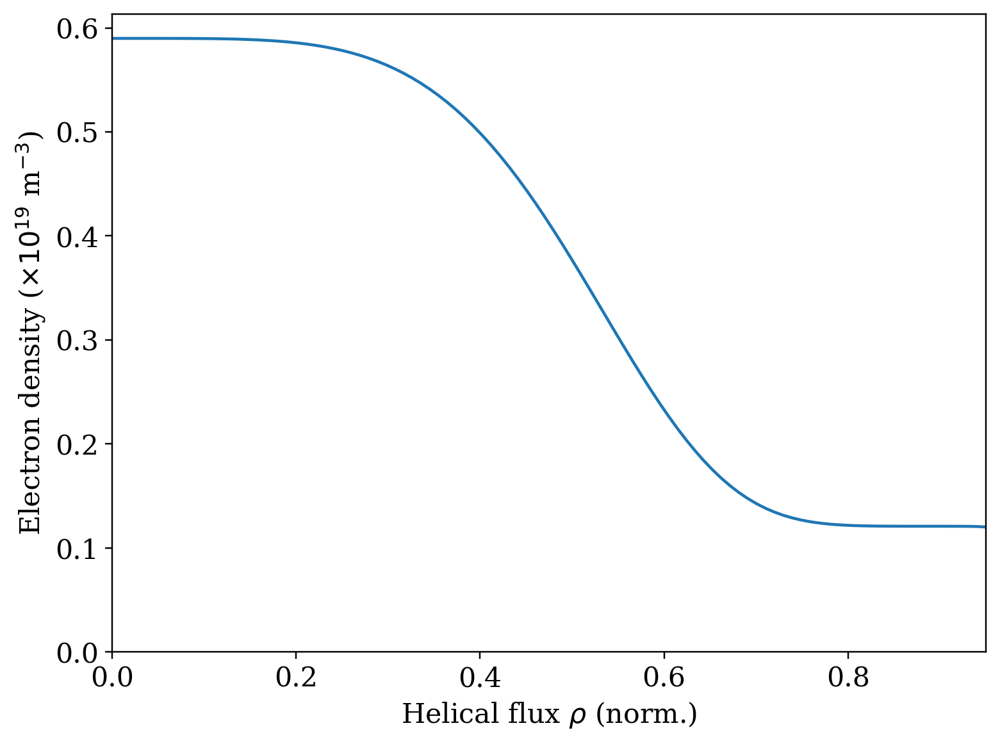

In [49]:
nes = ne_prof(rs, *popt_dens[tn,:], gamma=100.)
plt.plot(rs, nes)

plt.xlabel(r'Helical flux $\rho$ (norm.)')
plt.ylabel(r'Electron density ($\times 10^{19}$ m$^{-3}$)')
plt.xlim([0,0.95])
plt.ylim([0,None]);

In [1]:
n0_params=np.array([2.0, 10.0, 450.0, 0.6])

def n0_prof(rs, nH_0, nH_rm, nH_1, rm):
    core_value = nH_0
    amp = nH_1 - nH_0
    power = np.log( (nH_rm - nH_0)/(nH_1 - nH_0) ) / np.log(rm)
    return core_value + amp*( rs**power )

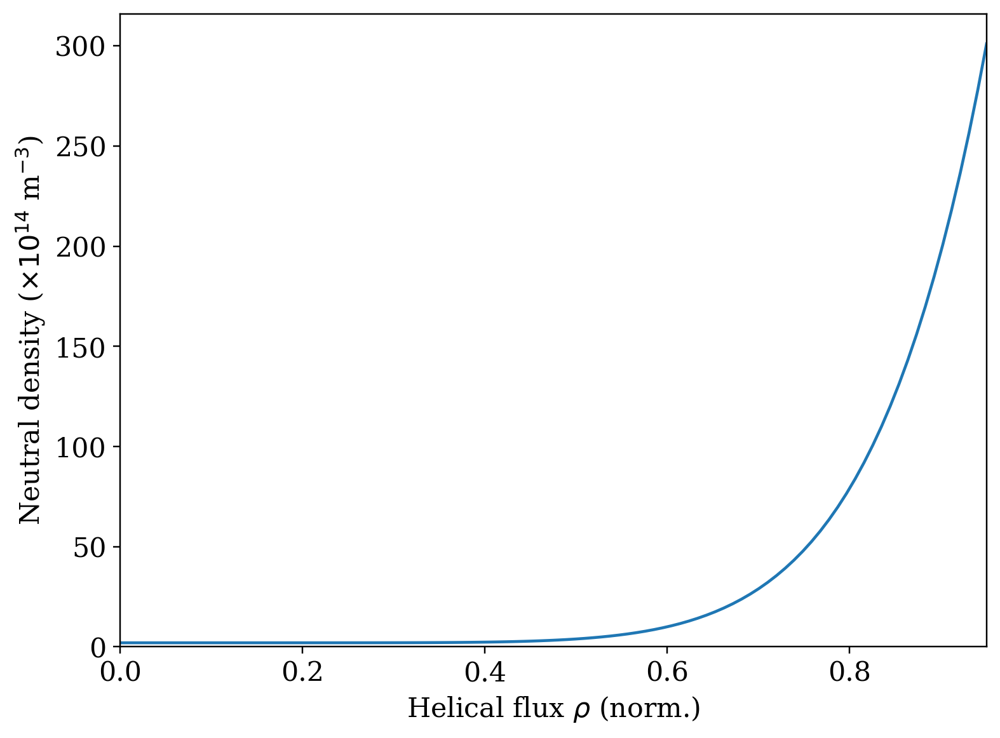

In [6]:
n0s = n0_prof(rs, *n0_params)
plt.plot(rs, n0s)

plt.xlabel(r'Helical flux $\rho$ (norm.)')
plt.ylabel(r'Neutral density ($\times 10^{14}$ m$^{-3}$)')
plt.xlim([0,0.95])
plt.ylim([0,None]);

In [270]:
nAl0 = 2.0e-3
nC0 = 6.8e-3
alpha_Z = 12.0
beta_Z = 4.0
#alpha_Z = 14.
#beta_Z = 1.0

def nZ_prof(rs, nZ0, alpha_Z, beta_Z):
    return nZ0*(1 - rs**alpha_Z)**beta_Z

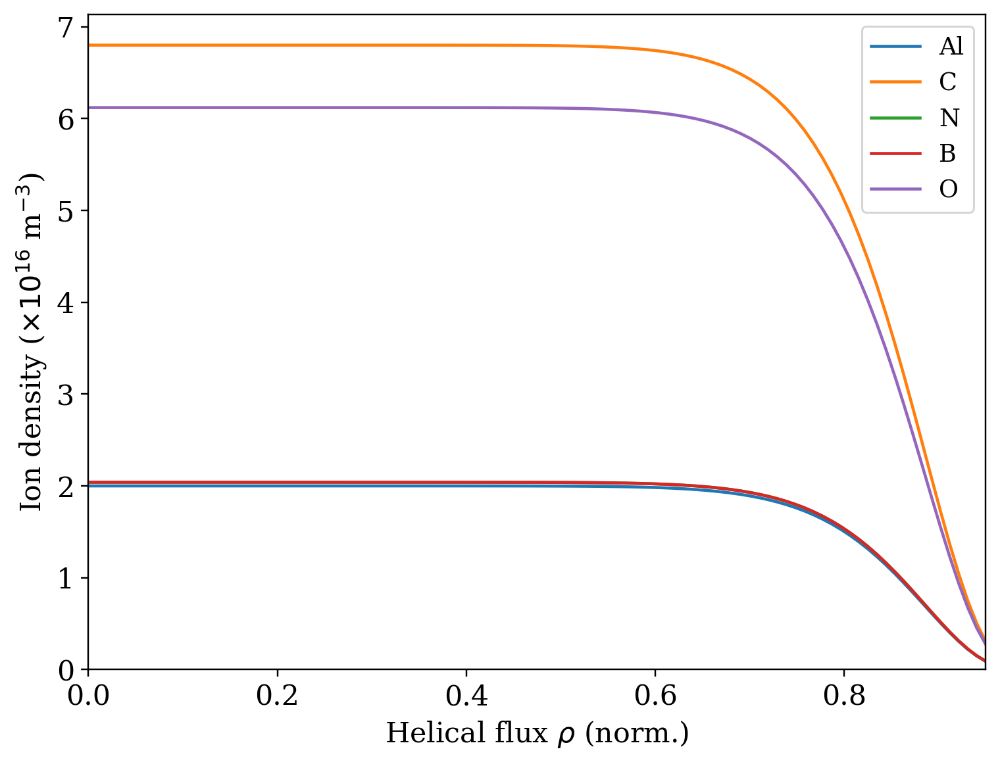

In [271]:
nAls = nZ_prof(rs, nAl0, alpha_Z, beta_Z)
nCs = nZ_prof(rs, nC0, alpha_Z, beta_Z)
nNs = 0.3*nCs
nBs = 0.3*nCs
nOs = 0.9*nCs

plt.plot(rs, nAls*1e3, label='Al')
plt.plot(rs, nCs*1e3, label='C')
plt.plot(rs, nNs*1e3, label='N')
plt.plot(rs, nBs*1e3, label='B')
plt.plot(rs, nOs*1e3, label='O')

plt.legend()
plt.xlabel(r'Helical flux $\rho$ (norm.)')
plt.ylabel(r'Ion density ($\times 10^{16}$ m$^{-3}$)')
plt.xlim([0,0.95])
plt.ylim([0,None]);

## The temperature model

For now I will try using the same form for the electron temperature as I did for the emissivity profile:

$$
    T_e (\rho) = T_{e,0} (1 - \rho^\alpha) + T_{e,1} \exp{\bigg[ -\bigg(\frac{\rho}{\Delta\rho} \bigg)^\beta \bigg]}
$$

In [41]:
x0 = np.array([50., 500., 20.7,  3.18,  0.44])

def temp_prof(rs, Te0, Te1, alpha, beta, dr):
    return Te0 * (1 - rs**alpha) + Te1 * np.exp( -(rs/dr)**beta)

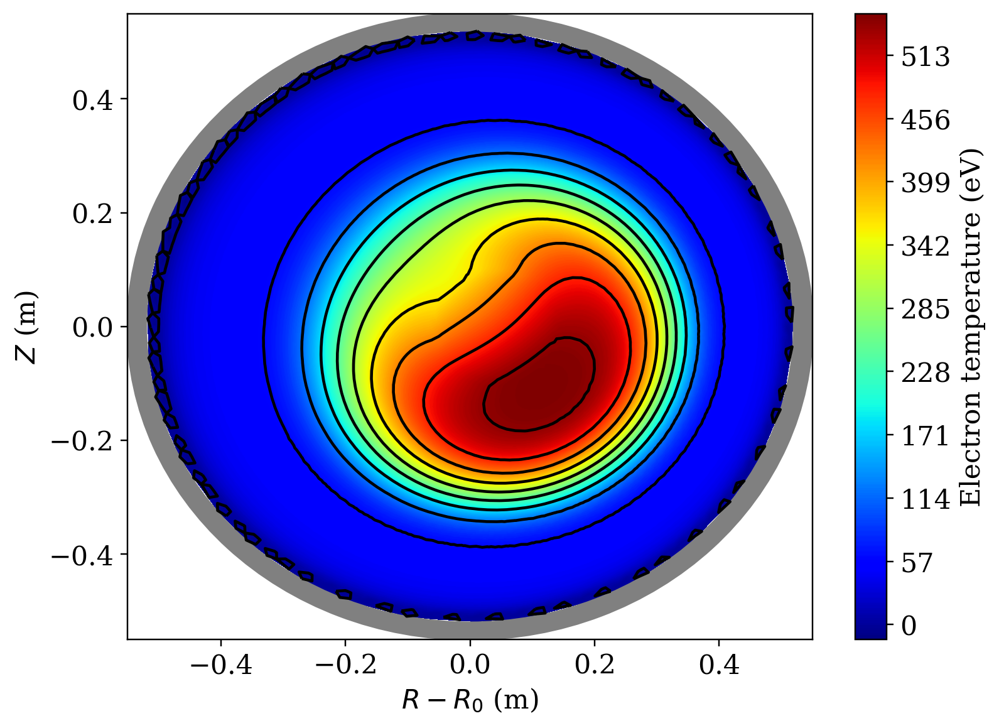

In [46]:
xs, ys = sunflower_points(5000)
rhos = rho_xy(xs, ys, t, label='SXT')
Te_xs = temp_prof(rhos, *x0)

cax1 = plt.tricontourf(xs, ys, Te_xs, 500, cmap=cm.jet)
cb = plt.colorbar(cax1, label=r'Electron temperature (eV)')

# Oveplot flux contours
cax2 = plt.tricontour(xs, ys, Tes, 10, colors='black')

plt.xlabel('$R - R_0$ (m)')
plt.ylabel('$Z$ (m)')
overplot_shell(plt.gca())
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55]);

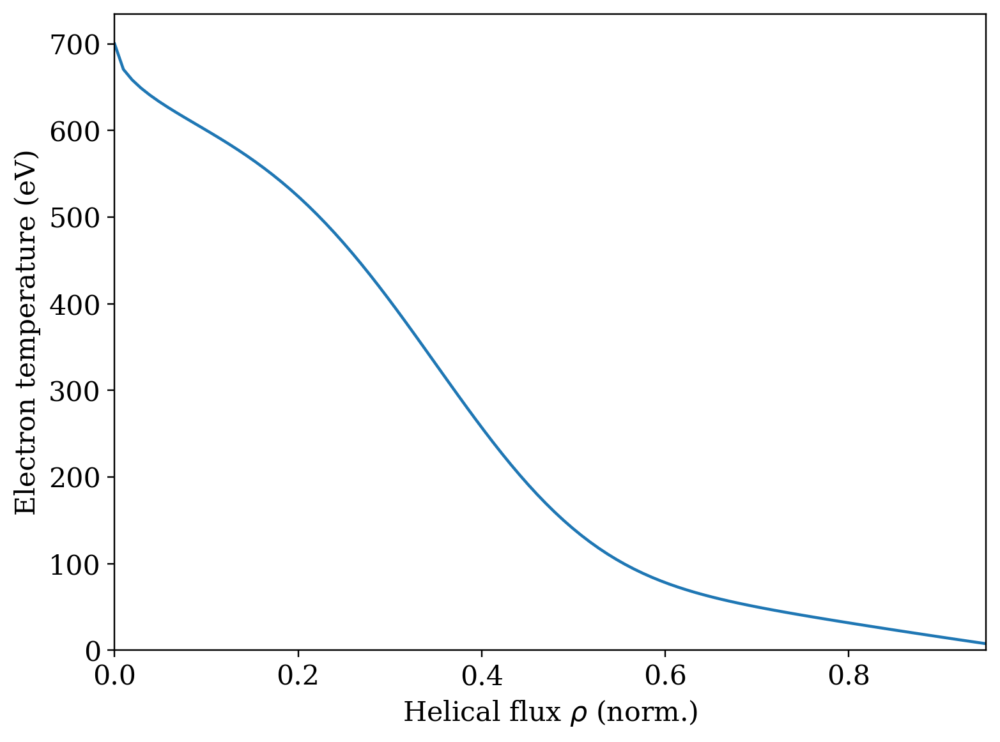

In [340]:
x0 = np.array([300., 400., 0.5,  3.18,  0.4])
Tes = temp_prof(rs, *x0)
plt.plot(rs, Tes)

plt.xlabel(r'Helical flux $\rho$ (norm.)')
plt.ylabel(r'Electron temperature (eV)')
plt.xlim([0,0.95])
plt.ylim([0,None]);

## Load the SXT data

In [8]:
from mst_ida.data.sxt import load_brightness, invert_brightness, filter_list

# Tomography data parameters
t_start = 20.0
t_end = 40.0
delta_t = 0.5
smooth = 10

# Pairs (19,59), (20,60), (22, 62).
# (20,59,60) are N2 channels, (22,62) is erroneous on this shot,
# and 19 was removed as the pair to 59.
exclude = [20, 59, 60, 22, 62, 19]

# Load in the tomography data
st = load_brightness(shot, t_start=t_start, t_end=t_end, delta=delta_t, smooth=smooth, exclude=exclude)
tomo = invert_brightness(shot, t_start=t_start, t_end=t_end, delta=delta_t, smooth=smooth, exclude=exclude, thin=True)

% SXR_MST_BOX_GET_SIGNALS: beginning for shot #1200701056
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals in W/m2
% SXR_MST_BOX_GET_SIGNALS: opening MST for shot 1200701056
% Compiled module: WHOAMI.
% Compiled module: FILEBREAK.
% Compiled module: CALC_GEOM_2.
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO time base, Wed Aug  5 00:17:22 2020
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals
% SXR_MST_BOX_GET_SIGNALS: assembling bright structure and transposing matrix
% SXR_MST_BOX_GET_SIGNALS: SXRTOMO done
Time=1.5832629 s
% SXR_MST_BOX_GET_SIGNALS: beginning for shot #1200701056
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals in W/m2
% SXR_MST_BOX_GET_SIGNALS: opening MST for shot 1200701056
% Compiled module: WHOAMI.
% Compiled module: FILEBREAK.
% Compiled module: CALC_GEOM_2.
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO time base, Wed Aug  5 00:17:24 2020
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals
% SXR_MST_BOX_GET_SIGNALS: assembling bright structure and transposing matr

In [138]:
t = 30.0
tn = np.argmin(np.abs(ts - t))

# Format the data vector
y_data = {label:np.concatenate([st.bright[f][:,tn] for f in filter_list(label)])for label in ['thick', 'thin']}
y_sigma = {label:np.concatenate([st.sigma[f][:,tn] for f in filter_list(label)])for label in ['thick', 'thin']}
x_data = np.array([n for n in range(40) if n+41 not in exclude])

## The emissivity forward model

In [122]:
from mst_ida.models.sxt import SXT
from mst_ida.models.plasma import get_avg_Z

sxt_model = SXT(exclude=exclude)
filters = filter_list('thin')
sxt_los = np.concatenate([sxt_model.los[f] for f in filters])
sxt_ps = np.concatenate([sxt_model.p[f] for f in filters])
labels = np.concatenate([[f]*len(sxt_model.los[f]) for f in filters])

In [123]:
# Parameters
n_chords = len(sxt_los)
n_rs = 500

# Build the Rhos matrix
Rhos = np.zeros([n_rs, n_chords])
Xs = np.zeros([n_rs, n_chords])
for jj, los in enumerate(sxt_los):
    a = los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=n_rs)
    xl, yl = los.get_xy(ells)
    Rhos[:,jj] = rho_xy(xl, yl, t, label='SXT')
    Xs[:, jj] = ells

# Explicitly limit the Rhos matrix to between 0 and 1
Rhos[Rhos < 0] = 0.0
Rhos[Rhos > 1] = 1.0

# Delta matrix for quick trapezoidal integration
Dx = np.ones(Xs.shape)
Dx[0,:] = Dx[1,:] = 0.5
for j in range(n_chords):
    Dx[:,j] *= Xs[1,j] - Xs[0,j]

In [207]:
Te_params = np.array([50., 470., 20.7,  3.18,  0.44])
n0_params=np.array([2.0, 10.0, 450.0, 0.6])

# Calculate the base plasma parameters
ions=['Al', 'C', 'O', 'N', 'B']
Te_rs = temp_prof(Rhos, *Te_params)
n0_rs = n0_prof(Rhos, *n0_params)
ne_rs = ne_prof(Rhos, *popt_dens[tn,:], gamma=gamma) + 1e-3
nAl_rs = nZ_prof(Rhos, nAl0, alpha_Z, beta_Z)
nC_rs = nZ_prof(Rhos, nC0, alpha_Z, beta_Z)
nZ_rs = {
    'Al':nAl_rs,
    'C':nC_rs,
    'N':0.3*nC_rs,
    'B':0.3*nC_rs,
    'O':0.9*nC_rs
}
pts = list( zip( Te_rs.ravel(), ne_rs.ravel(), n0_rs.ravel() ) )

# Get avg_Z and nD
avg_Z = get_avg_Z()
avg_Z_rs = {ion:np.reshape(avg_Z[ion](pts), Rhos.shape) for ion in ions}

nD_rs = np.ones(Rhos.shape)
for ion in ions:
    nD_rs -= (nZ_rs[ion]/ne_rs)*avg_Z_rs[ion]
nD_rs *= ne_rs
nD_rs[nD_rs < 0] = 0.0

# Get the emissivity
y_model = {filt:np.zeros(n_chords) for filt in ['thick', 'thin']}
for filt in y_model.keys():
    emiss_rs = ne_rs * nD_rs * np.reshape(sxt_model.emiss['D'][filt](pts), Rhos.shape)
    for ion in ions:
        emiss_rs += ne_rs * nZ_rs[ion] * np.reshape(sxt_model.emiss[ion][filt](pts), Rhos.shape)
    
    emiss_rs *= 1e19 * 1e19
    y_model[filt] = np.sum(emiss_rs * Dx, axis=0)

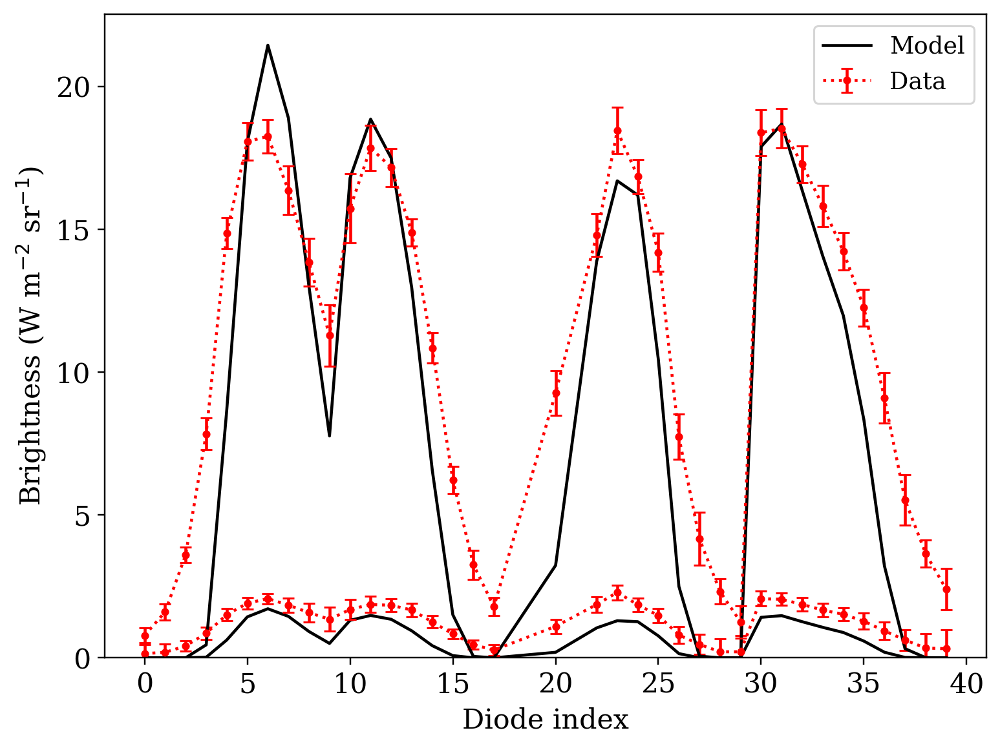

In [208]:
filt = 'thick'
plt.plot(x_data, y_model[filt], color='black', label='Model')
plt.errorbar(x_data, y_data[filt], yerr=y_sigma[filt], marker='o', ms=3, capsize=3, linestyle=':', color='red', label=r'Data')

filt = 'thin'
plt.plot(x_data, y_model[filt], color='black')
plt.errorbar(x_data, y_data[filt], yerr=y_sigma[filt], marker='o', ms=3, capsize=3, linestyle=':', color='red')

plt.legend()
plt.xlabel('Diode index')
plt.ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')
plt.ylim([0, None]);

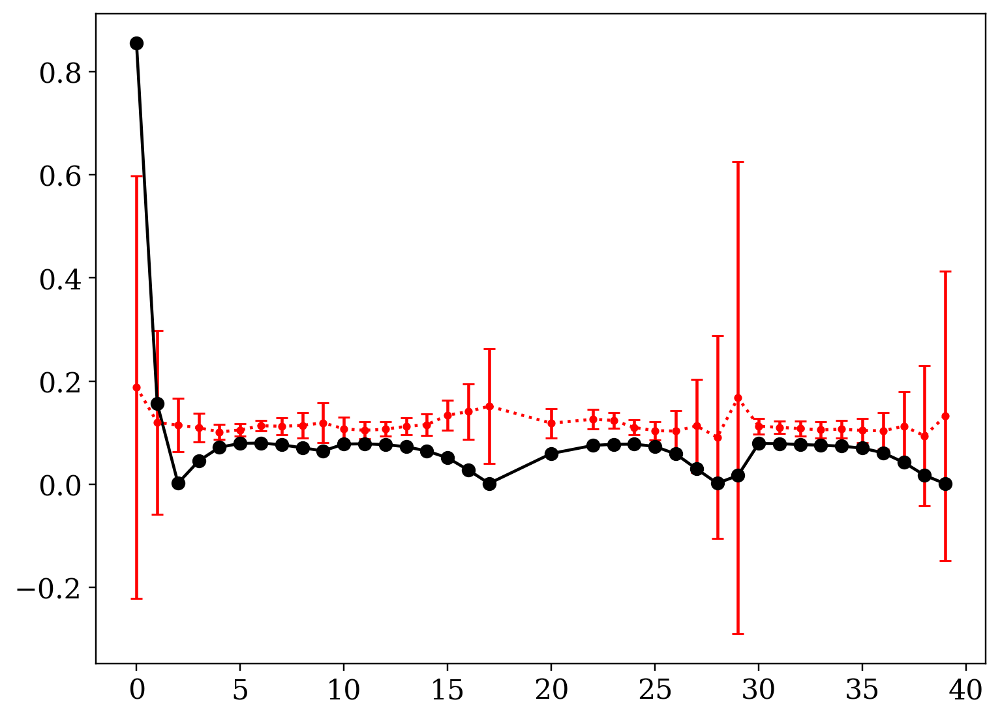

In [209]:
# Ratios
ratio_data = y_data['thick'] / y_data['thin']
ratio_sigma = ratio_data * np.sqrt( (y_sigma['thick']/y_data['thick'])**2 + (y_sigma['thin']/y_data['thin'])**2 )
ratio_model = y_model['thick'] / y_model['thin']

plt.errorbar(x_data, ratio_data, yerr=ratio_sigma, marker='o', ms=3, capsize=3, linestyle=':', color='red')
plt.plot(x_data, ratio_model, '-ok')

## Bayesian analysis (single frame)

In [210]:
# All of the profiles
def ne_prof(rs, n0, n1, alpha, beta, gamma=100.):
    dens = (n0 - n1) * (1 - rs**alpha)**beta + n1 * (1 - rs**gamma)
    return np.maximum(dens, 0.0)

def n0_prof(rs, nH_0, nH_rm, nH_1, rm):
    core_value = nH_0
    amp = nH_1 - nH_0
    power = np.log( (nH_rm - nH_0)/(nH_1 - nH_0) ) / np.log(rm)
    return core_value + amp*( rs**power )

def nZ_prof(rs, nZ0, alpha_Z, beta_Z):
    return nZ0*(1 - rs**alpha_Z)**beta_Z

def get_nZ_profs(rs, nAl0, nC0, alpha_Z, beta_Z):
    nAl_rs = nZ_prof(rs, nAl0, alpha_Z, beta_Z)
    nC_rs = nZ_prof(rs, nC0, alpha_Z, beta_Z)
    nZ_rs = {'Al':nAl_rs, 'C':nC_rs, 'N':0.3*nC_rs, 'B':0.3*nC_rs, 'O':0.9*nC_rs}
    return nZ_rs

def temp_prof(rs, Te0, Te1, alpha, beta, dr):
    return Te0 * (1 - rs**alpha) + Te1 * np.exp( -(rs/dr)**beta)

In [219]:
n0_params = np.array([2.0, 10.0, 450.0, 0.6])
ne_params = popt_dens[tn,:]
nZ_params = np.array([nAl0, nC0, alpha_Z, beta_Z])
ions = ['Al', 'C', 'O', 'N', 'B']

def get_emiss(Rhos, Te_params):
    # Calculate the base plasma parameters
    Te_rs = temp_prof(Rhos, *Te_params)
    n0_rs = n0_prof(Rhos, *n0_params)
    ne_rs = ne_prof(Rhos, *ne_params, gamma=gamma) + 1e-4
    nZ_rs = get_nZ_profs(Rhos, *nZ_params)
    pts = list( zip( Te_rs.ravel(), ne_rs.ravel(), n0_rs.ravel() ) )

    # Get avg_Z and nD
    avg_Z = get_avg_Z()
    avg_Z_rs = {ion:np.reshape(avg_Z[ion](pts), Rhos.shape) for ion in ions}
    
    nD_rs = np.ones(Rhos.shape)
    for ion in ions:
        nD_rs -= (nZ_rs[ion]/ne_rs)*avg_Z_rs[ion]
    nD_rs *= ne_rs
    nD_rs[nD_rs < 0] = 0.0

    # Get the emissivity
    emiss_rs = {filt:np.zeros(Rhos.shape) for filt in ['thick', 'thin']}
    for filt in ['thick', 'thin']:
        emiss_rs[filt] = ne_rs * nD_rs * np.reshape(sxt_model.emiss['D'][filt](pts), Rhos.shape)
        for ion in ions:
            emiss_rs[filt] += ne_rs * nZ_rs[ion] * np.reshape(sxt_model.emiss[ion][filt](pts), Rhos.shape)

        emiss_rs[filt] *= 1e19 * 1e19
    
    return emiss_rs

def get_model(Rhos, Dx, Te_params):
    emiss_rs = get_emiss(Rhos, Te_params)
    y_model = {filt:np.sum(emiss_rs[filt] * Dx, axis=0) for filt in ['thick', 'thin']}
    return y_model['thick'] / (y_model['thin'] + 1e-6)

In [171]:
%timeit ratio_model = get_model(Rhos, Dx, Te_params)

277 ms ± 1.11 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [220]:
# Define probability functions
def ln_likelihood(theta):
    ratio_model = get_model(Rhos, Dx, theta)
    return -0.5*np.sum( (ratio_data - ratio_model)**2 / (ratio_sigma**2) )

def ln_prior(theta):
    Te0, Te1, alpha, beta, dr = theta
    prior = (0.0 < Te0 < 100.0) *\
            (100.0 < Te1 < 1000.0) *\
            (2 < alpha < 40) *\
            (1 < beta < 16) *\
            (0.1 < dr < 0.6)
    if prior:
        return 0.0
    else:
        return -np.inf
    
def ln_prob(theta):
    lp = ln_prior(theta)
    if np.isfinite(lp):
        return lp + ln_likelihood(theta)
    else:
        return -np.inf

In [213]:
from mst_ida.utilities.functions import get_MLE

x0 = np.array([50., 470., 20.7,  3.18,  0.44])
bounds = [(0.0, 100.0),
          (100.0, 1000.0),
          (2, 40),
          (1, 16),
          (0.1, 0.6)]
theta0 = get_MLE(ln_likelihood, x0, bounds=bounds)

MLE required 36.10185480117798 seconds.
      fun: 3.557185752506204
 hess_inv: <5x5 LbfgsInvHessProduct with dtype=float64>
      jac: array([-1.99569375e-03, -1.24344880e-06, -5.10702549e-06, -1.86086242e-02,
       -1.49104457e+01])
  message: b'CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL'
     nfev: 120
      nit: 14
     njev: 20
   status: 0
  success: True
        x: array([1.00000000e+02, 7.80264257e+02, 4.00000000e+01, 1.60000000e+01,
       6.00000000e-01])


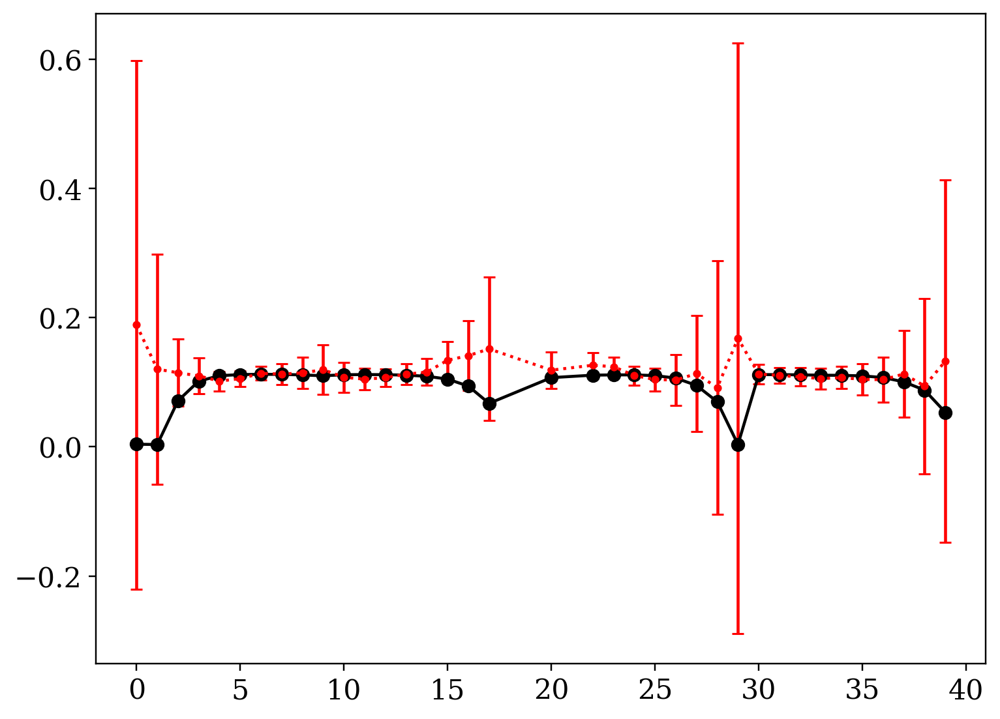

In [215]:
# Ratios
ratio_MLE = get_model(Rhos, Dx, theta0)

plt.errorbar(x_data, ratio_data, yerr=ratio_sigma, marker='o', ms=3, capsize=3, linestyle=':', color='red')
plt.plot(x_data, ratio_MLE, '-ok')

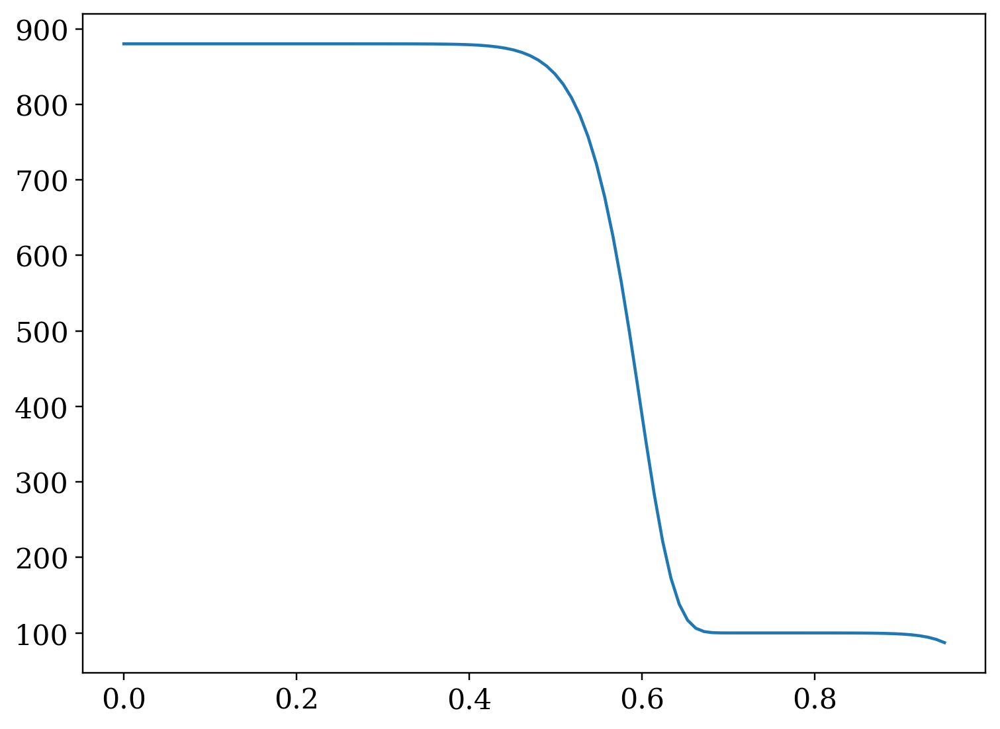

In [216]:
rs = np.linspace(0, 0.95, num=100)
plt.plot(rs, temp_prof(rs, *theta0))

In [221]:
import emcee

# Sampling parameters
n_steps = 1000
nwalkers = 50
ndim = len(theta0)

# Generate the initial positions based on the MLE
dim_scale = np.array([5.0, 20.0, 1.0, 0.5, 0.1])
pos0 = np.zeros([nwalkers, ndim])
for ii in range(nwalkers):
    pos0[ii,:] = x0 + dim_scale* np.random.randn(ndim)
    
# Reccommended to avoid errors
from multiprocessing import Pool
os.environ["OMP_NUM_THREADS"] = "1"

# Set up the moves strategy - good for lightly multimodal distributions
moves=[(emcee.moves.DEMove(), 0.8), (emcee.moves.DESnookerMove(), 0.2),]

In [222]:
with Pool(26) as pool:
    sampler = emcee.EnsembleSampler(nwalkers, ndim, ln_prob, moves=moves, pool=pool)
    start = time.time()
    sampler.run_mcmc(pos0, n_steps, progress=True)
    end = time.time()
    delta_time = end - start

print("Sampling took {0:.1f} minutes".format(delta_time/60.))

100%|██████████| 1000/1000 [16:26<00:00,  1.01it/s]

Sampling took 16.5 minutes


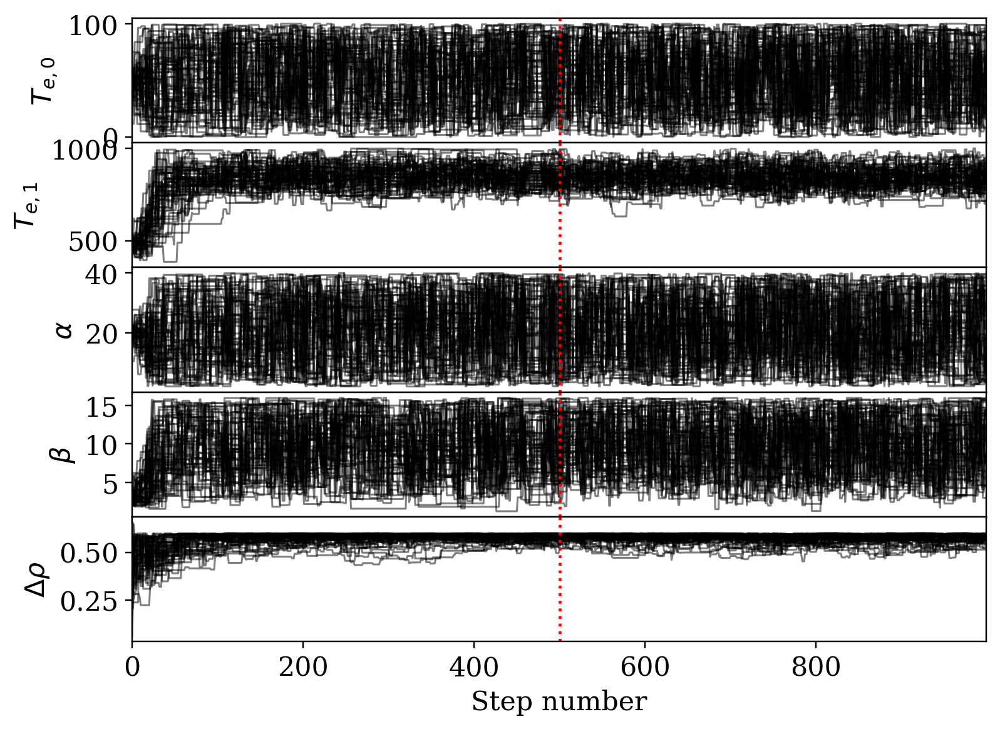

In [224]:
import mst_ida.analysis.plots as idap

params = [r'$T_{e,0}$', r'$T_{e,1}$', r'$\alpha$', r'$\beta$', r'$\Delta \rho$']
burn_step = 500
fig, ax = idap.burn_plot(sampler.chain, burn_step, nwalkers, indices=range(ndim), labels=params, figsize=(8,6))

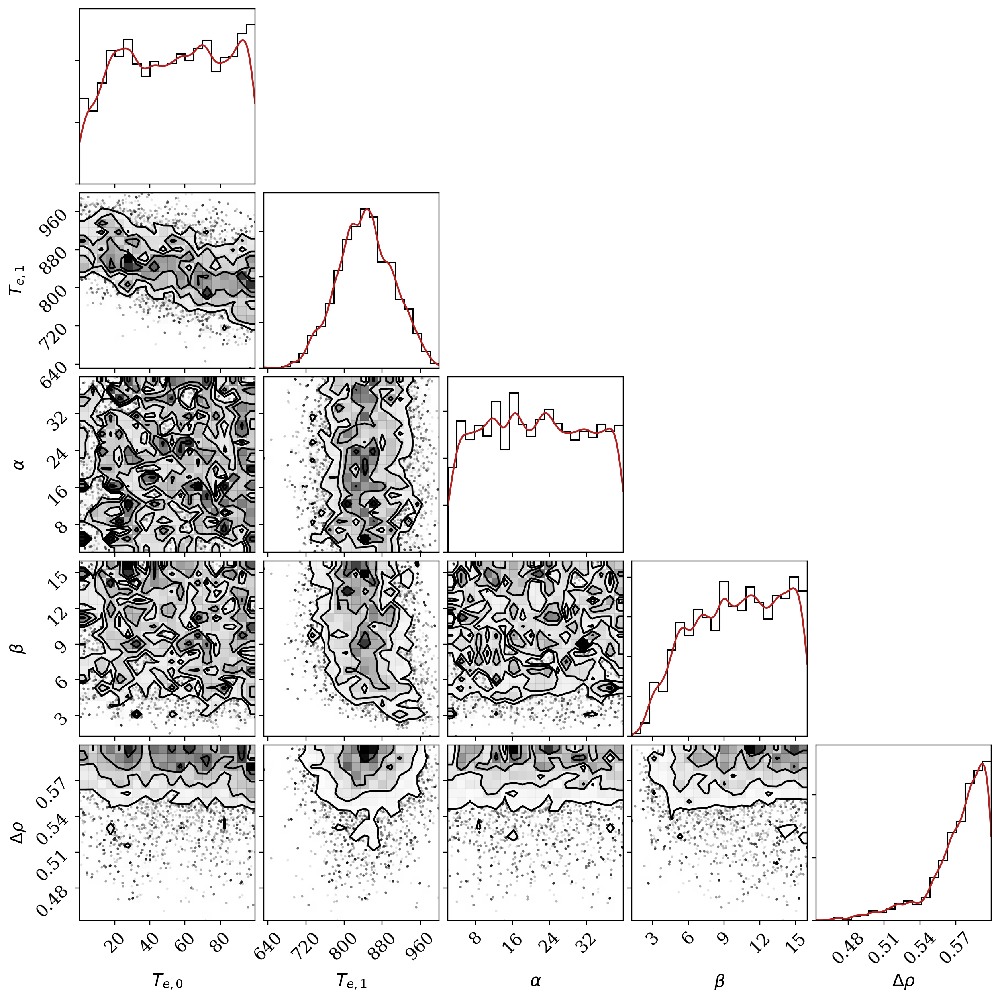

In [225]:
samples = sampler.get_chain(discard=burn_step, flat=True)
distplot(samples, labels=params)

## A new approach: absolute measurements

So yeah, ratios don't seem to be a very good choice for this analysis.

I will let the likelihood function consider the absolute agreement between the data and the model for thick and thin filter data. As a consequence, I will need to make both $n_{Al}$ and $n_{C}$ into fittable parameters. Later on I will bring ME-SXR data into this methodology to further constrain things. The basic plasma model is:

$$
    T_e(\rho) = T_{e,0}(1 - \rho^{\alpha_T}) + T_{e,1} \exp{\bigg[ -\bigg(\frac{\rho}{\Delta \rho}\bigg)^{\beta_T} \bigg]}
$$

and

$$
    n_Z(\rho) = n_{Z,0} (1 - \rho^{\alpha_Z})
$$

I will manually fix $\alpha_T = \alpha_Z = 20.0$. This leaves 6 free parameters:

$$
    \vec{\theta} = \big(T_{e,0}, T_{e,1}, \beta_T, \Delta \rho, n_{C,0}, n_{Al,0} \big)
$$

If the results are poorly constrained, I will introduced priors for the impurities based on Galante's results:

$$
    p(n_{Z}|\mu_Z,\sigma_Z) = \frac{1}{\sqrt{2 \pi}\, \sigma_Z} \exp{\bigg[-\bigg(\frac{n_Z - \mu_Z}{\sigma_Z}\bigg)^2 \bigg]}
$$

where $\mu_C = 6.8\times10^{-3}$, $\sigma_C = 1.4\times10^{-3}$, $\mu_{Al} = 2.0\times10^{-3}$, and $\sigma_{Al} = 0.5\times10^{-3}$. Of course these results were for PPCD so it is not a given then they are applicable here. However they should constrain the densities sufficiently well to explore temperature dynamics (if not the actual amplitudes).

In [9]:
t = 30.0
tn = np.argmin(np.abs(ts - t))

# Format the data vector
filters = filter_list('all')
y_data = np.concatenate([st.bright[f][:,tn] for f in filters])
y_sigma = np.concatenate([st.sigma[f][:,tn] for f in filters])
x_data = np.array([n for n in range(1,81) if n not in exclude])

<ErrorbarContainer object of 3 artists>

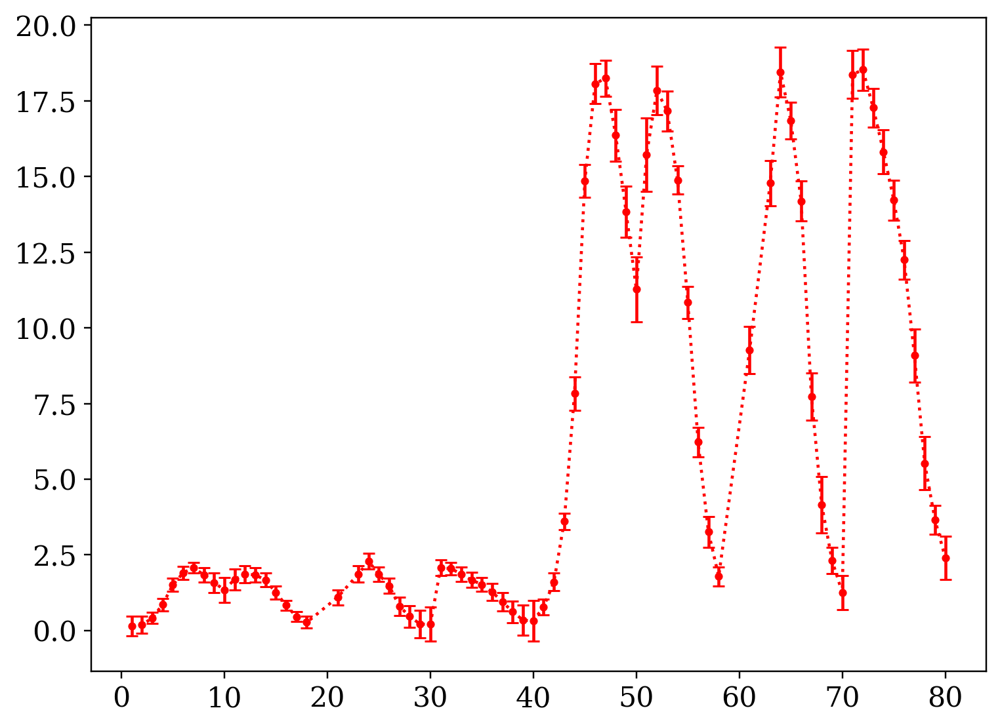

In [13]:
plt.errorbar(x_data, y_data, yerr=y_sigma, marker='o', ms=3, capsize=3, linestyle=':', color='red')

In [10]:
from mst_ida.models.sxt import SXT
from mst_ida.models.plasma import get_avg_Z

# Parameters
n_rs = 500

# SXT model
sxt_model = SXT(exclude=exclude)
filters = filter_list('all')
sxt_los = np.concatenate([sxt_model.los[f] for f in filter_list('thin')])
sxt_ps = np.concatenate([sxt_model.p[f] for f in filter_list('thin')])
labels = np.concatenate([[f]*len(sxt_model.los[f]) for f in filters])
n_chords = len(sxt_los)

# Build the Rhos matrix
Rhos = np.zeros([n_rs, n_chords])
Xs = np.zeros([n_rs, n_chords])
for jj, los in enumerate(sxt_los):
    a = los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=n_rs)
    xl, yl = los.get_xy(ells)
    Rhos[:,jj] = rho_xy(xl, yl, t, label='SXT')
    Xs[:, jj] = ells

# Explicitly limit the Rhos matrix to between 0 and 1
Rhos[Rhos < 0] = 0.0
Rhos[Rhos > 1] = 1.0

# Delta matrix for quick trapezoidal integration
Dx = np.ones(Xs.shape)
Dx[0,:] = Dx[1,:] = 0.5
for j in range(n_chords):
    Dx[:,j] *= Xs[1,j] - Xs[0,j]

In [11]:
# All of the profiles
def ne_prof(rs, n0, n1, alpha, beta, gamma=100.):
    dens = (n0 - n1) * (1 - rs**alpha)**beta + n1 * (1 - rs**gamma)
    return np.maximum(dens, 0.0)

def n0_prof(rs, nH_0, nH_rm, nH_1, rm):
    core_value = nH_0
    amp = nH_1 - nH_0
    power = np.log( (nH_rm - nH_0)/(nH_1 - nH_0) ) / np.log(rm)
    return core_value + amp*( rs**power )

def nZ_prof(rs, nZ0, alpha_Z, beta_Z):
    return nZ0*(1 - rs**alpha_Z)**beta_Z

def get_nZ_profs(rs, nAl0, nC0, alpha_Z, beta_Z):
    nAl_rs = nZ_prof(rs, nAl0, alpha_Z, beta_Z)
    nC_rs = nZ_prof(rs, nC0, alpha_Z, beta_Z)
    nZ_rs = {'Al':nAl_rs, 'C':nC_rs, 'N':0.3*nC_rs, 'B':0.3*nC_rs, 'O':0.9*nC_rs}
    return nZ_rs

#def temp_prof(rs, Te0, Te1, alpha, beta, dr):
#    return Te0 * (1 - rs**alpha) + Te1 * np.exp( -(rs/dr)**beta)

def temp_prof(rs, Te0, beta, dr):
    return Te0 * np.exp( -(rs/dr)**beta)

#def temp_prof(rs, Te0, Te1, alpha, beta, gamma=100.):
#    temp = (Te0 - Te1) * (1 - rs**alpha)**beta + Te1 * (1 - rs**gamma)
#    return np.maximum(temp, 0.0)

In [12]:
# Fixed profiles
n0_params = np.array([2.0, 10.0, 450.0, 0.6])
ne_params = popt_dens[tn,:]

# Fixed parameters
ions = ['Al', 'C', 'O', 'N', 'B']
alpha_T = 12.0
alpha_Z = 12.0
beta_Z = 4.0
gamma = 100.0

# Galante priors
mu_Al = 2.0e-3
mu_C = 6.8e-3
sigma_Al = 0.5e-3
sigma_C = 1.4e-3

# Default vector
x0 = np.array([500.0, 2.0, 0.6, mu_Al, 2.0, 0.2])

def get_emiss(Rhos, theta):
    Te0, beta_T, dr, nAl0, bg1, bg2 = theta
    Te_params = np.array([Te0, beta_T, dr])
    nZ_params = np.array([nAl0, mu_C, alpha_Z, beta_Z])
    bg = {'thin':bg1, 'thick':bg2}
    
    # Calculate the base plasma parameters
    Te_rs = temp_prof(Rhos, *Te_params)
    nZ_rs = get_nZ_profs(Rhos, *nZ_params)
    ne_rs = ne_prof(Rhos, *ne_params, gamma=gamma) + 1e-6
    n0_rs = n0_prof(Rhos, *n0_params)
    pts = list( zip( Te_rs.ravel(), ne_rs.ravel(), n0_rs.ravel() ) )

    # Get avg_Z and nD
    avg_Z = get_avg_Z()
    avg_Z_rs = {ion:np.reshape(avg_Z[ion](pts), Rhos.shape) for ion in ions}
    
    nD_rs = np.ones(Rhos.shape)
    for ion in ions:
        nD_rs -= (nZ_rs[ion]/ne_rs)*avg_Z_rs[ion]
    nD_rs *= ne_rs
    nD_rs[nD_rs < 0] = 0.0

    # Get the emissivity
    emiss_rs = {filt:np.zeros(Rhos.shape) for filt in ['thick', 'thin']}
    for filt in ['thick', 'thin']:
        emiss_rs[filt] = ne_rs * nD_rs * np.reshape(sxt_model.emiss['D'][filt](pts), Rhos.shape)
        for ion in ions:
            emiss_rs[filt] += ne_rs * nZ_rs[ion] * np.reshape(sxt_model.emiss[ion][filt](pts), Rhos.shape)

        emiss_rs[filt] *= 1e19 * 1e19
        emiss_rs[filt] += bg[filt]
    
    return emiss_rs

def get_model(Rhos, Dx, theta):
    emiss_rs = get_emiss(Rhos, theta)
    return np.concatenate([np.sum(emiss_rs[filt] * Dx, axis=0) for filt in ['thick', 'thin']])

In [14]:
y_model = get_model(Rhos, Dx, x0)

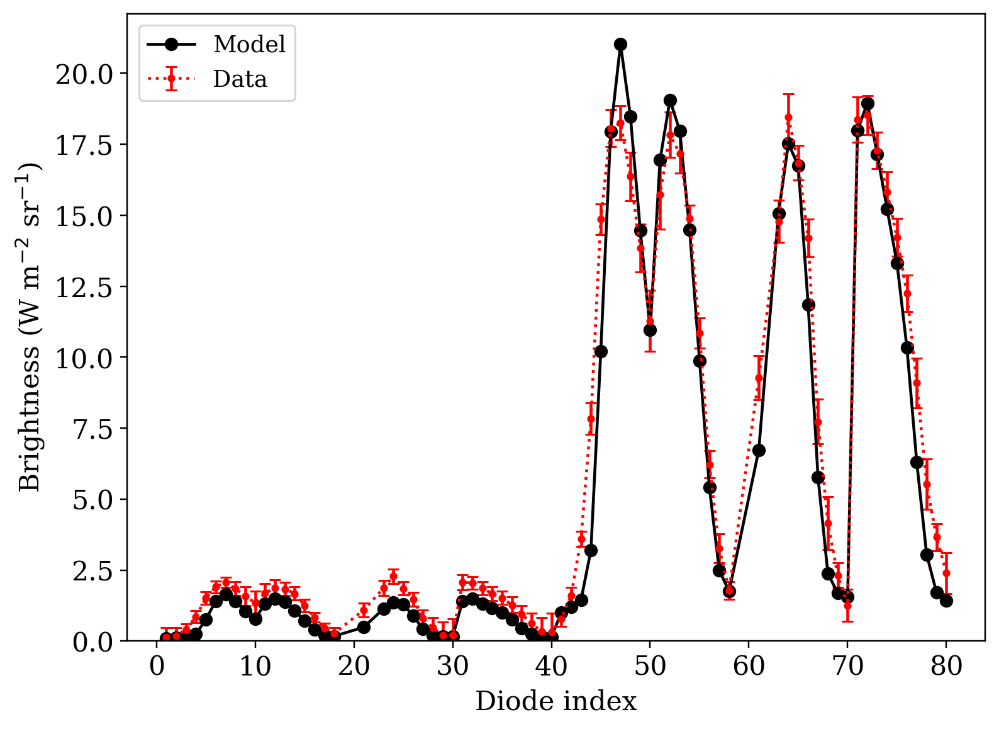

In [15]:
plt.errorbar(x_data, y_data, yerr=y_sigma, marker='o', ms=3, capsize=3, linestyle=':', color='red', label='Data')
plt.plot(x_data, y_model, '-ok', label='Model')

plt.legend()
plt.xlabel('Diode index')
plt.ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')
plt.ylim([0, None]);

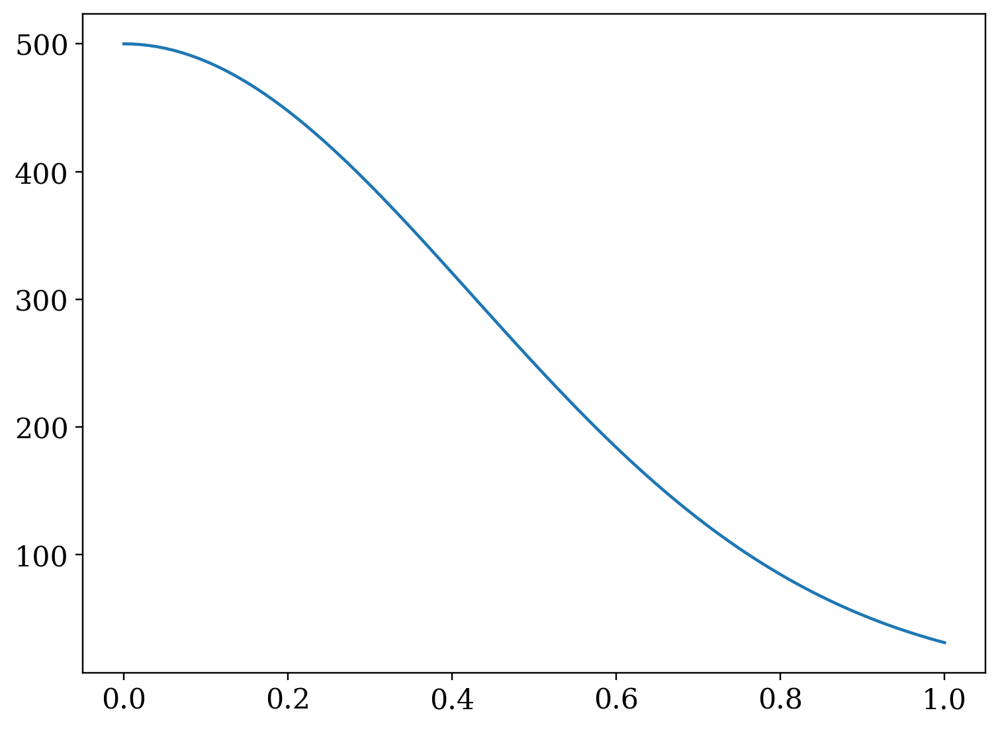

In [307]:
Te0, beta_T, dr, bg1, bg2 = x0
Te_params = np.array([Te0, beta_T, dr])
plt.plot(rs, temp_prof(rs, *Te_params))

In [16]:
# Define probability functions
def ln_likelihood(theta):
    y_model = get_model(Rhos, Dx, theta)
    return -0.5*np.sum( (y_data - y_model)**2 / (y_sigma**2 + (0.02*y_model)**2) )

def ln_prior(theta):
    Te0, beta_T, dr, nAl0, bg1, bg2 = theta
    prior = (0.0 < Te0 < 1000.0) *\
            (0.1 < beta_T < 5.0) *\
            (0.2 < dr < 1.0) *\
            (1e-4 < nAl0 < 1e-2) *\
            (0.0 < bg1 < 6.0) *\
            (0.0 < bg2 < 1.0)
    if prior:
        return 0.0
    else:
        return -np.inf
    
def ln_prob(theta):
    lp = ln_prior(theta)
    if np.isfinite(lp):
        return lp + ln_likelihood(theta)
    else:
        return -np.inf

In [17]:
bounds = [(0.0, 1000.0),
          (0.1, 5.0),
          (0.2, 1.0),
          (1e-4, 1e-2),
          (0, 6),
          (0, 1)]

In [18]:
# Maximum likelihood
theta0_MLE = get_MLE(ln_likelihood, x0, bounds=bounds)

MLE required 173.601313829422 seconds.
      fun: 87.9973098850215
 hess_inv: <6x6 LbfgsInvHessProduct with dtype=float64>
      jac: array([-0.07213282,  0.02494147,  0.00242153,  0.00751044,  0.03342535,
        0.00691216])
  message: b'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 623
      nit: 73
     njev: 89
   status: 0
  success: True
        x: array([5.00360954e+02, 1.76848353e+00, 7.87919806e-01, 1.52714350e-03,
       2.85977210e+00, 6.49549362e-01])


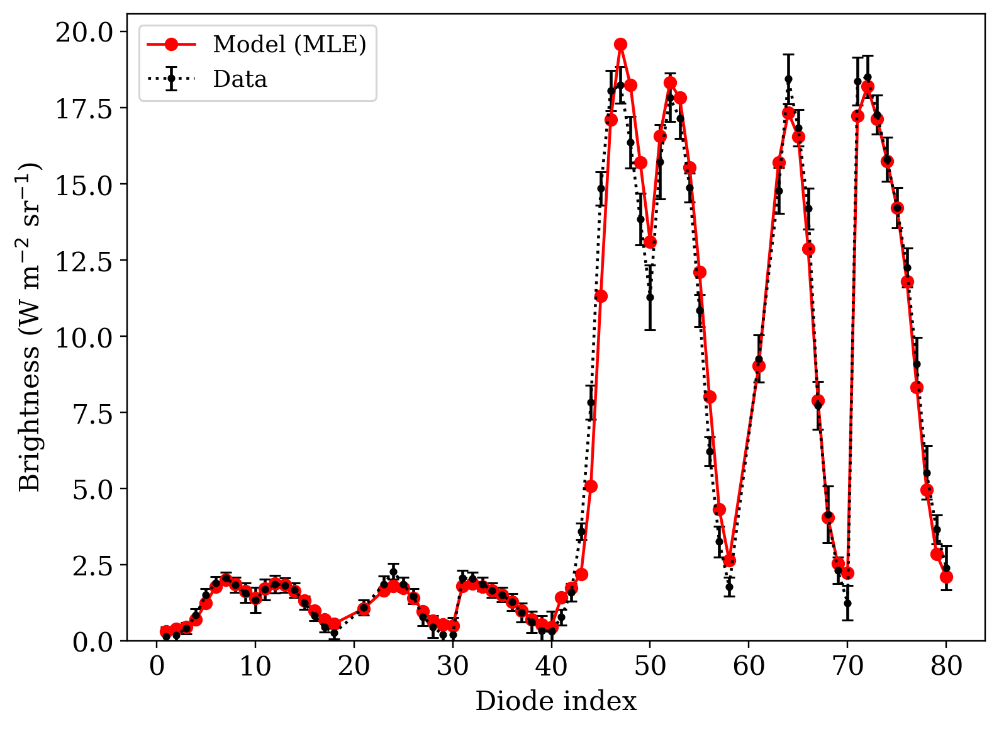

In [20]:
plt.errorbar(x_data, y_data, yerr=y_sigma, marker='o', ms=3, capsize=3, linestyle=':', color='black', label='Data')

y_model = get_model(Rhos, Dx, theta0_MLE)
plt.plot(x_data, y_model, '-or', label='Model (MLE)')

plt.legend()
plt.xlabel('Diode index')
plt.ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')
plt.ylim([0, None]);

Text(0, 0.5, 'Electron temperature (eV)')

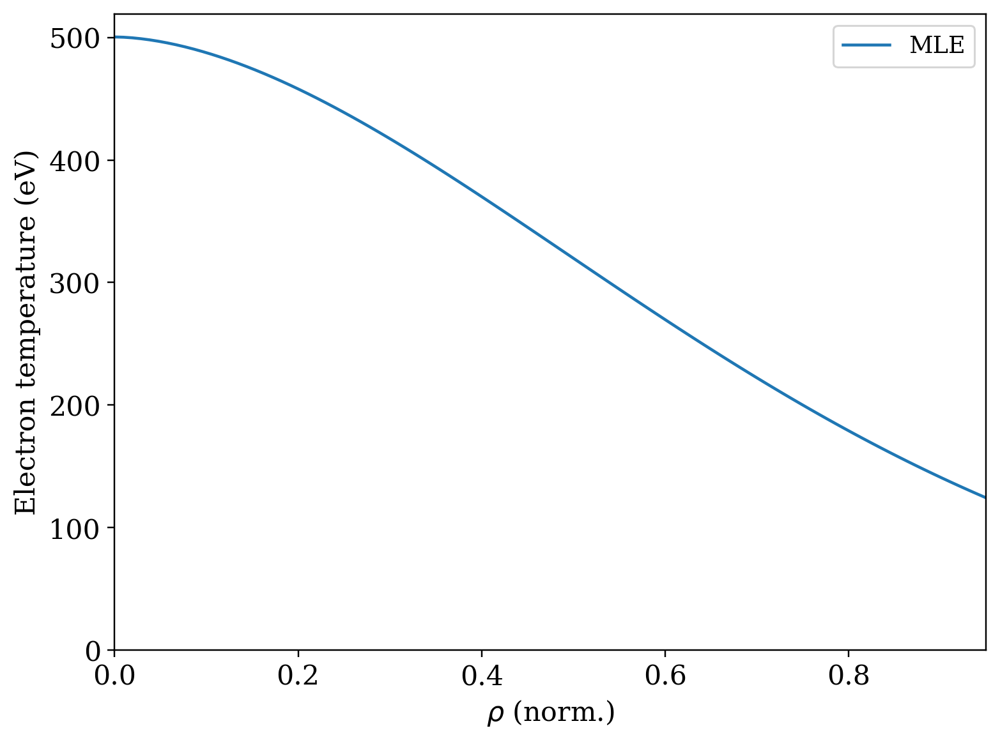

In [426]:
rs = np.linspace(0, 0.95, num=100)

# MLE
Te0, beta_T, dr, nAl0, bg1, bg2 = theta0_MLE
Te_params = np.array([Te0, beta_T, dr])
plt.plot(rs, temp_prof(rs, *Te_params), label='MLE')

plt.legend()
plt.xlim([0,0.95])
plt.ylim([0,None])
plt.xlabel(r'$\rho$ (norm.)')
plt.ylabel(r'Electron temperature (eV)')

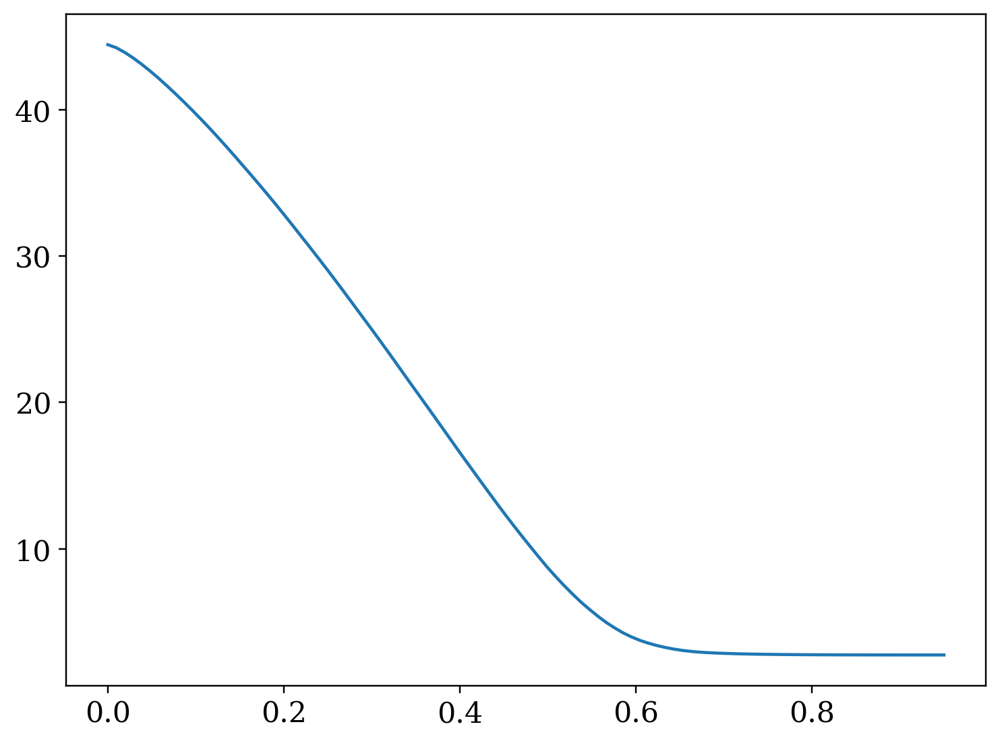

In [331]:
emiss = get_emiss(rs, theta0_MLE)
plt.plot(rs, emiss['thin'])

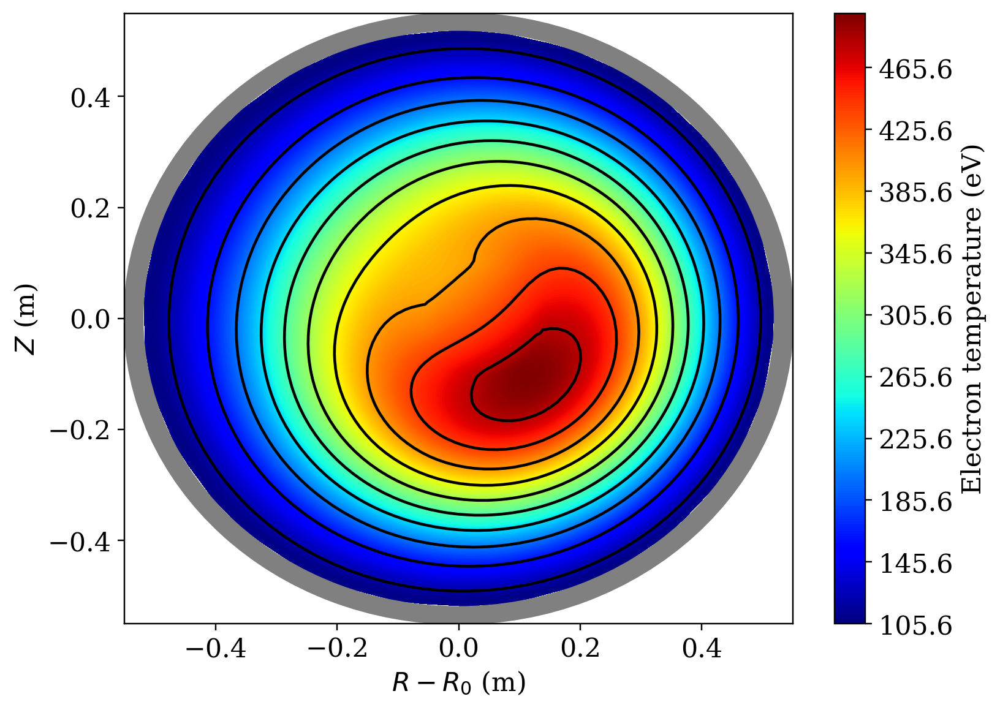

In [338]:
Te0, beta_T, dr, nAl0, bg1, bg2 = theta0_MLE
Te_params = np.array([Te0, beta_T, dr])

xs, ys = sunflower_points(5000)
rhos = rho_xy(xs, ys, t, label='SXT')
Te_xs = temp_prof(rhos, *Te_params)

cax1 = plt.tricontourf(xs, ys, Te_xs, 500, cmap=cm.jet)
cb = plt.colorbar(cax1, label=r'Electron temperature (eV)')

# Oveplot flux contours
cax2 = plt.tricontour(xs, ys, Te_xs, 10, colors='black')

plt.xlabel('$R - R_0$ (m)')
plt.ylabel('$Z$ (m)')
overplot_shell(plt.gca())
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55]);

In [21]:
import emcee

# Sampling parameters
n_steps = 5000
nwalkers = 50
ndim = len(theta0_MLE)

# Generate the initial positions based on the MLE
dim_scale = np.array([5.0, 0.2, 0.05, 1e-4, 0.2, 0.05])
pos0 = np.zeros([nwalkers, ndim])
for ii in range(nwalkers):
    pos0[ii,:] = theta0_MLE + dim_scale* np.random.randn(ndim)
    
# Reccommended to avoid errors
from multiprocessing import Pool
os.environ["OMP_NUM_THREADS"] = "1"

# Set up the moves strategy - good for lightly multimodal distributions
moves=[(emcee.moves.DEMove(), 0.8), (emcee.moves.DESnookerMove(), 0.2),]

In [ ]:
with Pool(28) as pool:
    sampler = emcee.EnsembleSampler(nwalkers, ndim, ln_prob, moves=moves, pool=pool)
    start = time.time()
    sampler.run_mcmc(pos0, n_steps, progress=True)
    end = time.time()
    delta_time = end - start

print("Sampling took {0:.1f} minutes".format(delta_time/60.))

  0%|          | 0/5000 [00:00<?, ?it/s]/home/pdvanmeter/anaconda3/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
 45%|████▍     | 2236/5000 [45:48<59:30,  1.29s/it]  

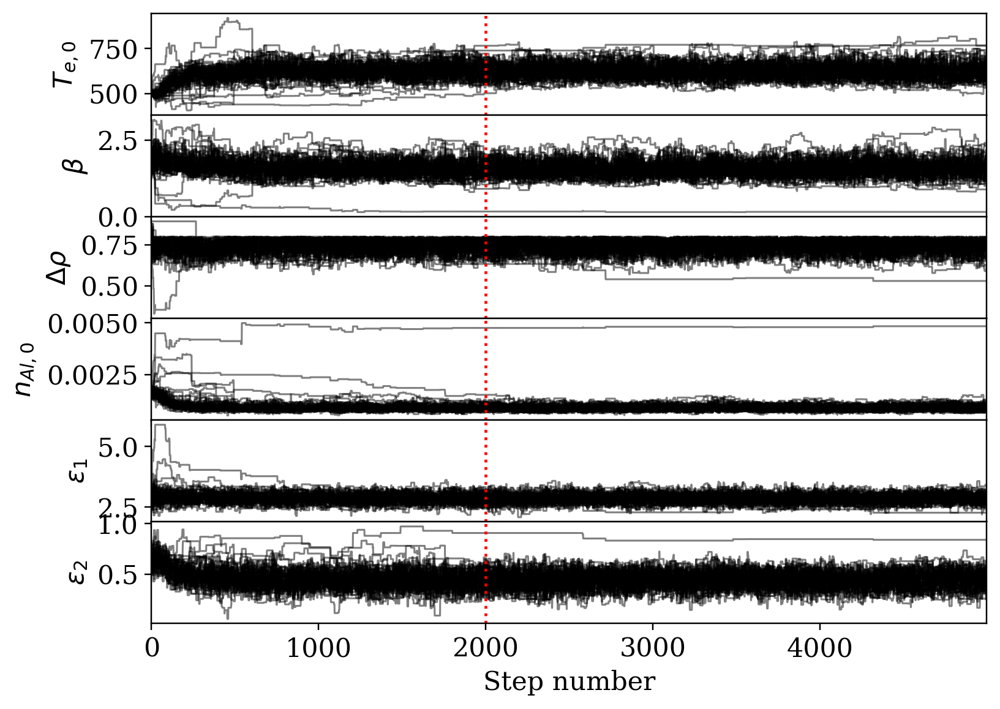

In [24]:
import mst_ida.analysis.plots as idap

params = [r'$T_{e,0}$', r'$\beta$', r'$\Delta \rho$', r'$n_{Al,0}$', r'$\varepsilon_1$', r'$\varepsilon_2$']
burn_step = 2000
fig, ax = idap.burn_plot(sampler.chain, burn_step, nwalkers, indices=range(ndim), labels=params, figsize=(8,6))

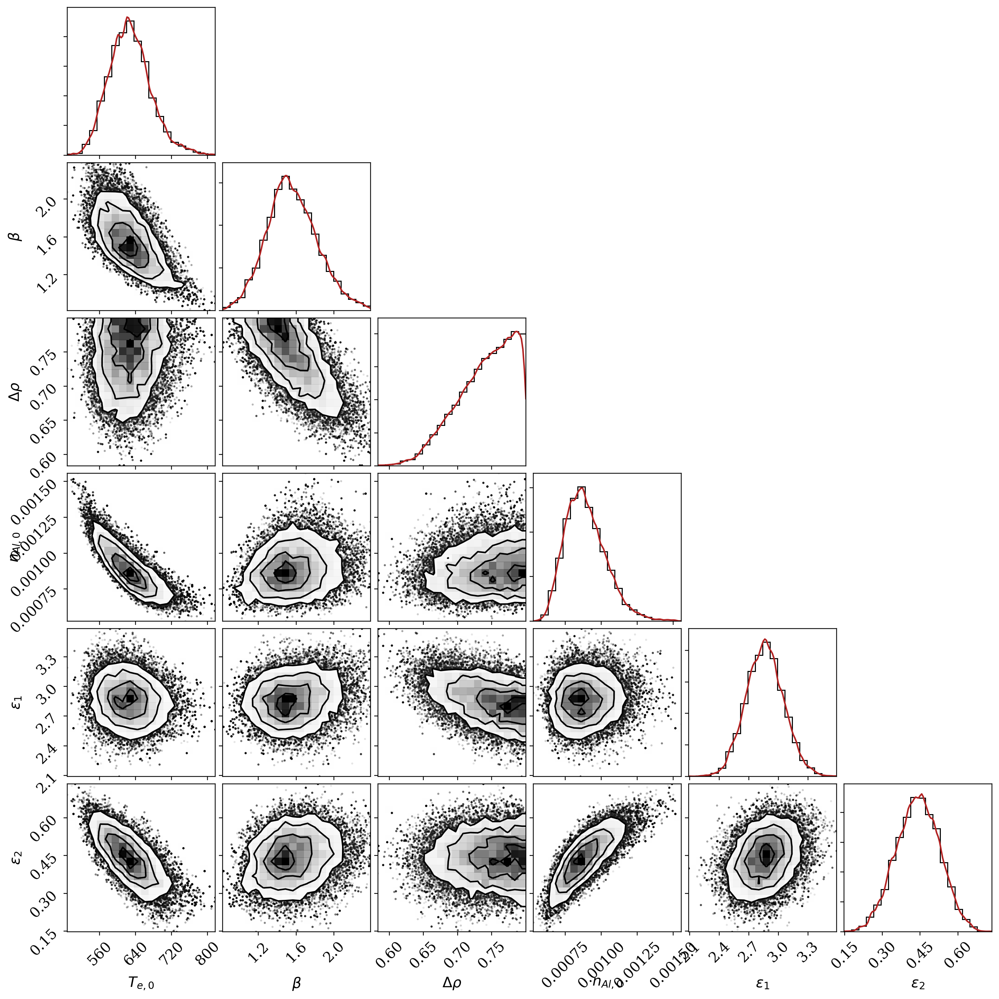

In [28]:
from mst_ida.utilities.functions import identify_outliers

samples = sampler.get_chain(discard=burn_step, flat=True)
samples = identify_outliers(samples, param=1)
distplot(samples, labels=params)

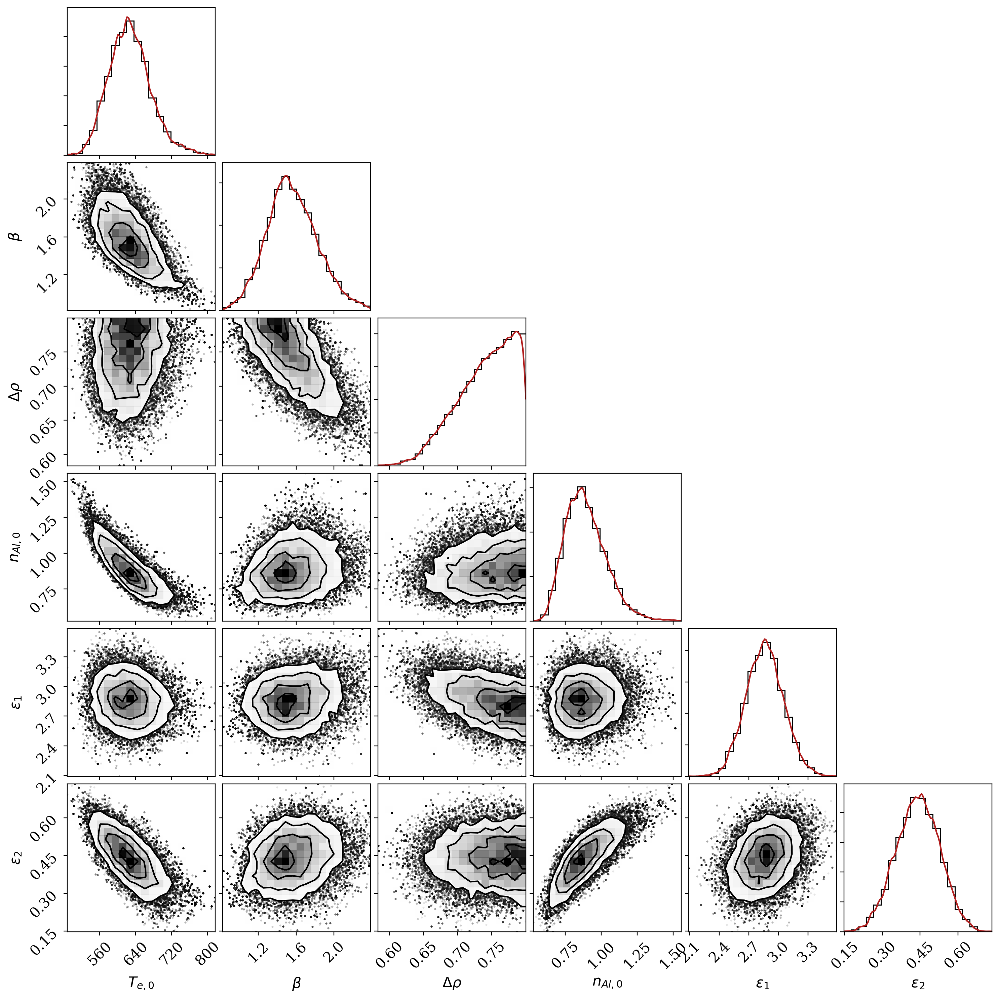

In [626]:
samples = sampler.get_chain(discard=burn_step, flat=True)
samples = identify_outliers(samples, param=1)
vals = np.copy(samples)
vals[:,3] *= 1e3
distplot(vals, labels=params)

In [29]:
import mst_ida.analysis.ida as ida

num_samples = 500
num_pts = 100

ys = np.linspace(0, 1, num=num_pts)
Te_samples = np.zeros([num_samples, num_pts])

for index, n in enumerate(np.random.randint(samples.shape[0], size=num_samples)):
    Te0, beta_T, dr, nAl0, bg1, bg2 = samples[n,:]
    Te_params = np.array([Te0, beta_T, dr])
    Te_samples[index] = temp_prof(ys, *Te_params)
    
Te_CI = ida.profile_confidence(Te_samples)

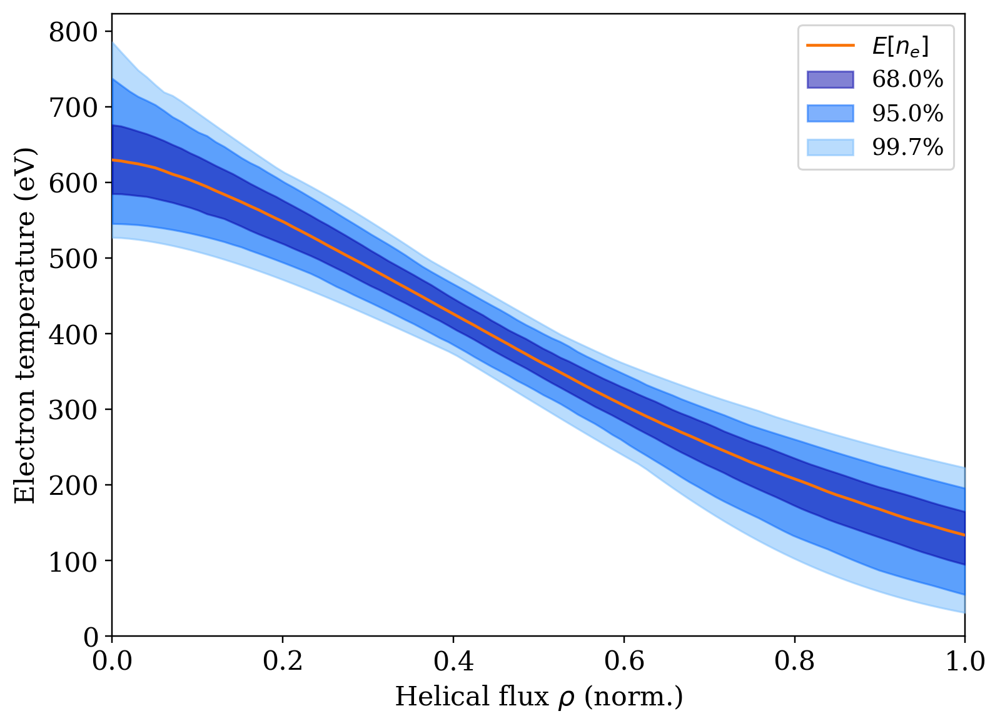

In [30]:
ax = plt.subplot(1,1,1)
idap.profile_CIs(ax, Te_CI, ys, ylim=[0,1], ylabel='$n_e$')

plt.xlabel(r'Helical flux $\rho$ (norm.)')
plt.ylabel(r'Electron temperature (eV)')
plt.xlim([0,1])
plt.ylim([0,None]);

In [31]:
theta_avg = np.average(samples, axis=0)

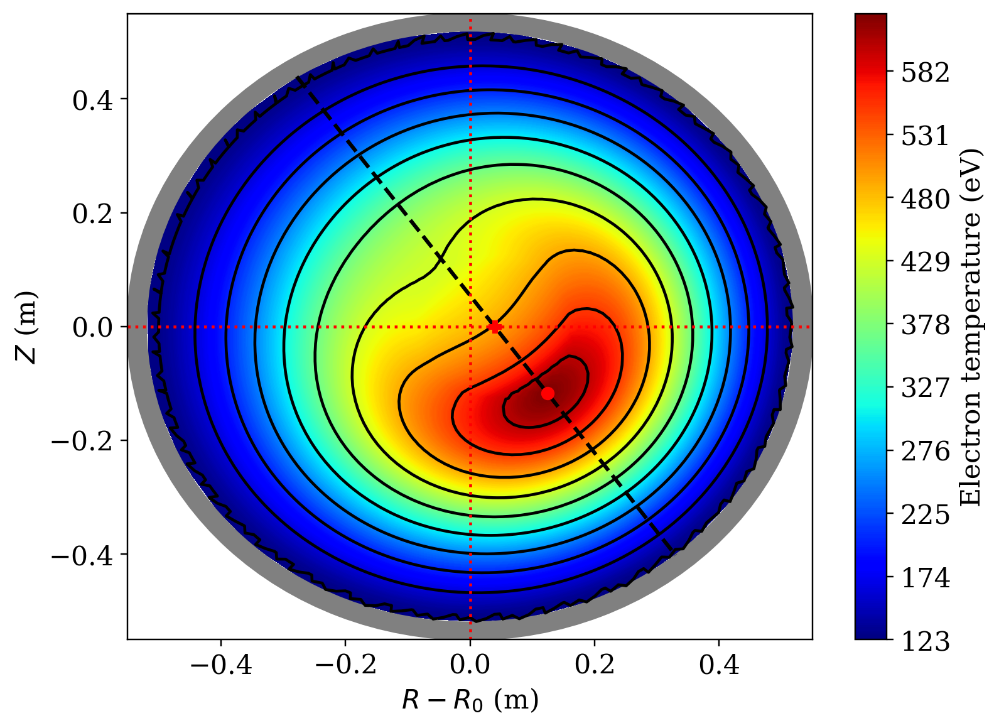

In [692]:
Te0, beta_T, dr, nAl0, bg1, bg2 = theta_avg
Te_params = np.array([Te0, beta_T, dr])

xs, ys = sunflower_points(5000)
rhos = rho_xy(xs, ys, t, label='SXT')
Te_xs = temp_prof(rhos, *Te_params)

cax1 = plt.tricontourf(xs, ys, Te_xs, 500, cmap=cm.jet)
cb = plt.colorbar(cax1, label=r'Electron temperature (eV)')

# Oveplot flux contours
cax2 = plt.tricontour(xs, ys, rhos, 10, colors='black')

# Find the o-point
n_op = np.argmin(rhos)
x_op = xs[n_op]
y_op = ys[n_op]
plt.plot([x_op], [y_op], 'or', zorder=100)

# Get the chord parameters
delta = get_delta(t)
plt.plot([delta], [0], 'Pr', zorder=100)
impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op) + np.pi
impact_p = delta * np.cos(impact_phi)

# Plot the chord
los = line_of_sight(impact_p, impact_phi)
ell_max = los.intercept_with_circle(0.52)
ells = np.linspace(-ell_max, ell_max, num=100)
xl, yl = los.get_xy(ells)
plt.plot(xl, yl, '--k', linewidth=2)

plt.xlabel('$R - R_0$ (m)')
plt.ylabel('$Z$ (m)')
overplot_shell(plt.gca())
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55])

plt.axvline(x=0, color='red', linestyle=':')
plt.axhline(y=0, color='red', linestyle=':');

In [71]:
num_samples = 10000
num_pts = 100

# Find the o-point
n_op = np.argmin(rhos)
x_op = xs[n_op]
y_op = ys[n_op]

# Get the chord parameters
delta = get_delta(t)
impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op) + np.pi
impact_p = delta * np.cos(impact_phi)

# Plot the chord
los = line_of_sight(impact_p, impact_phi)
ell_max = los.intercept_with_circle(0.52)
ells = np.linspace(-ell_max, ell_max, num=num_pts)
xl, yl = los.get_xy(ells)
rhos = rho_xy(xl, yl, t)

Te_X_samples = np.zeros([num_samples, num_pts])

for index, n in enumerate(np.random.randint(samples.shape[0], size=num_samples)):
    Te0, beta_T, dr, nAl0, bg1, bg2 = samples[n,:]
    Te_params = np.array([Te0, beta_T, dr])
    Te_X_samples[index,:] = temp_prof(rhos, *Te_params)
    
Te_X_CI = ida.profile_confidence(Te_samples)

In [88]:
import mst_ida.analysis.ida as ida

grad_Te_samples = np.zeros(num_samples)

for index in range(num_samples):
    temp = Te_X_samples[index,:]
    grad_Te = np.gradient(temp, ells)
    grad_Te_samples[index] = np.amax(np.abs(grad_Te))
    
grad_Te_median, grad_Te_lower, grad_Te_upper = ida.confidence_interval(grad_Te_samples)

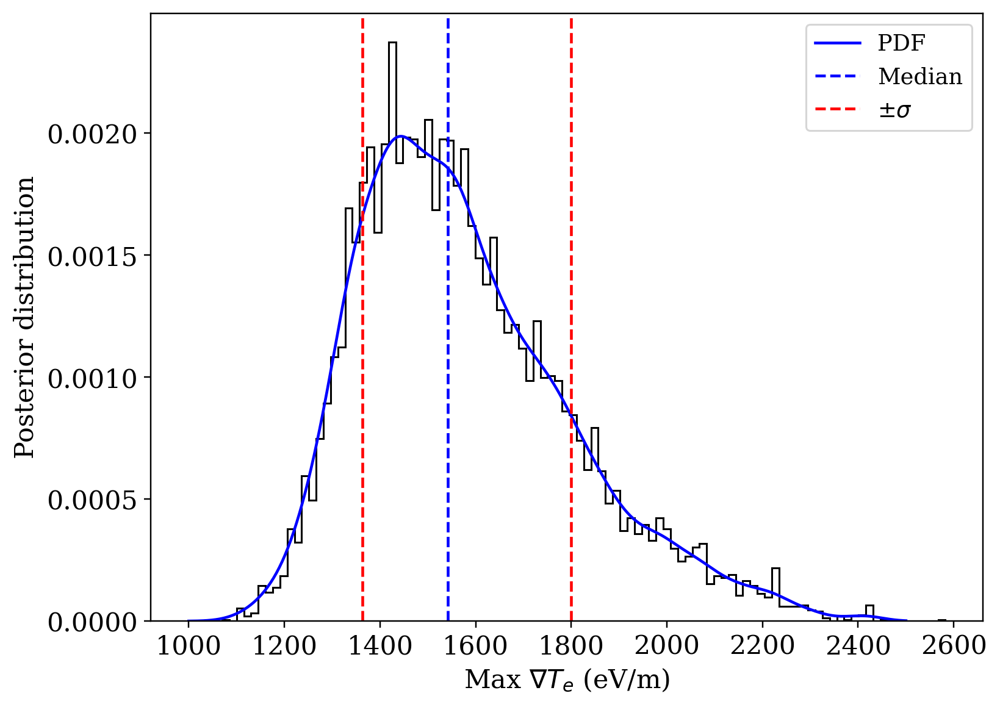

In [93]:
hist = plt.hist(grad_Te_samples, 100, histtype='step', color='black', density=True)

kde = sp.stats.gaussian_kde(grad_Te_samples)
gts = np.linspace(1000, 2500, num=500)
plt.plot(gts, kde(gts), color='blue', label='PDF')

plt.xlabel(r'Max $\nabla T_e$ (eV/m)')
plt.ylabel(r'Posterior distribution')

plt.axvline(x=grad_Te_median, color='blue', linestyle='--', label='Median')
plt.axvline(x=grad_Te_lower, color='red', linestyle='--', label=r'$\pm\sigma$')
plt.axvline(x=grad_Te_upper, color='red', linestyle='--')
plt.legend();

## Try the same thing, but with curve_fit to get a speedier variance estimate

In [99]:
x0 = np.array([
    500.0,   # Te0
    2.0,     # beta_T
    0.6,     # dr
    mu_Al,   # nAl0
    2.0,     # bg1
    0.2      # bg2
])

             # Te0 # beta_T  #dr  # nAl0  # bg1  #bg2
bounds = ( [   0.0,    0.1, 0.2,    1e-4,     0,    0], # Lower
           [1000.0,    5.0, 1.0,    1e-2,     6,    1]) # Upper

def func(x_data, Te0, beta_T, dr, nAl0, bg1, bg2):
    theta = np.array([Te0, beta_T, dr, nAl0, bg1, bg2])
    return get_model(Rhos, Dx, theta)

popt, pcov = sp.optimize.curve_fit(func, x_data, y_data, p0=x0, bounds=bounds, sigma=y_sigma, absolute_sigma=True)

In [115]:
# Estimate uncertainty with Gaussian Monte-Carlo method
rs = np.linspace(0, 0.95, num=100)
num_samples = 500
Te_samples = np.zeros([num_samples, len(rs)])

for index in range(num_samples):
    samples = sp.stats.multivariate_normal.rvs(mean=popt, cov=pcov)
    Te_samples[index,:] = temp_prof(rs, *samples[:3])
    
Te_avg = np.average(Te_samples, axis=0)
Te_std = np.std(Te_samples, axis=0)

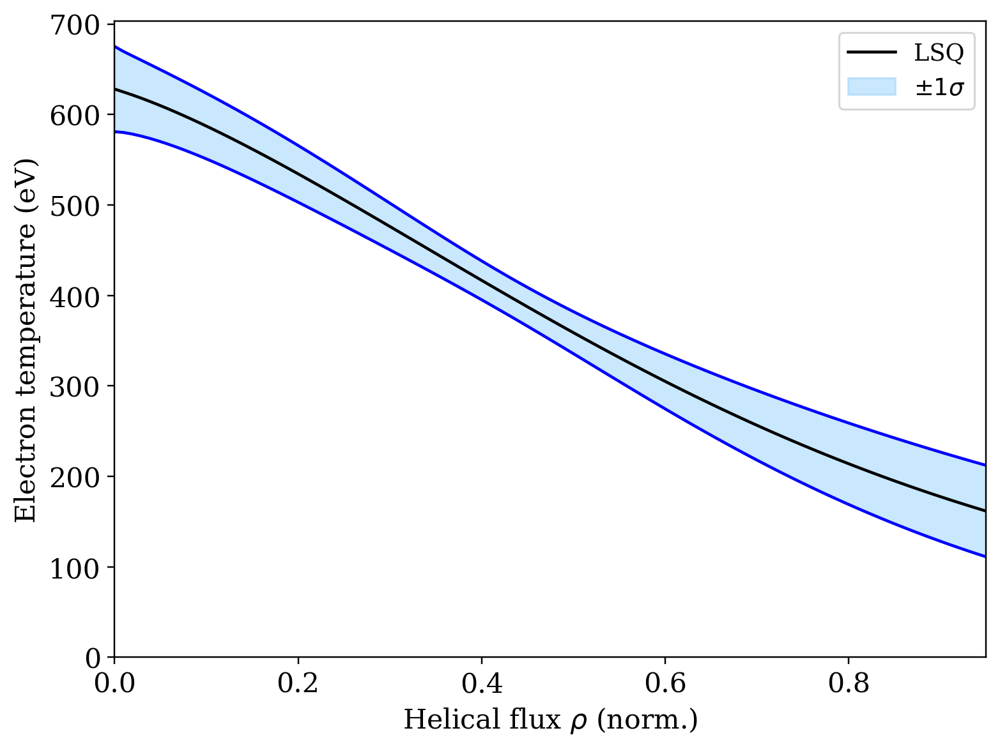

In [120]:
# Optimized solution
plt.plot(rs, Te_avg, label='LSQ', color='black')
plt.plot(rs, Te_avg+Te_std, color='blue')
plt.plot(rs, Te_avg-Te_std, color='blue')
plt.fill_between(rs, Te_avg-Te_std, Te_avg+Te_std, color='xkcd:light blue', alpha=0.5, label=r'$\pm 1\sigma$')

plt.legend()
plt.xlabel(r'Helical flux $\rho$ (norm.)')
plt.ylabel(r'Electron temperature (eV)')
plt.xlim([0,0.95])
plt.ylim([0,None]);

In [128]:
num_samples = 50000
num_pts = 100

# Find the o-point
n_op = np.argmin(rhos)
x_op = xs[n_op]
y_op = ys[n_op]

# Get the chord parameters
delta = get_delta(t)
impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op) + np.pi
impact_p = delta * np.cos(impact_phi)

# Plot the chord
los = line_of_sight(impact_p, impact_phi)
ell_max = los.intercept_with_circle(0.52)
ells = np.linspace(-ell_max, ell_max, num=num_pts)
xl, yl = los.get_xy(ells)
rhos = rho_xy(xl, yl, t)

Te_X_samples = np.zeros([num_samples, num_pts])

for index in range(num_samples):
    samples = sp.stats.multivariate_normal.rvs(mean=popt, cov=pcov)
    Te_X_samples[index,:] = temp_prof(rhos, *samples[:3])

In [129]:
grad_Te_samples = np.zeros(num_samples)

for index in range(num_samples):
    temp = Te_X_samples[index,:]
    grad_Te = np.gradient(temp, ells)
    grad_Te_samples[index] = np.amax(np.abs(grad_Te))

In [136]:
grad_Te_avg, grad_Te_lower, grad_Te_upper = ida.confidence_interval(grad_Te_samples)

#grad_Te_avg = np.average(grad_Te_samples)
#grad_Te_std = np.std(grad_Te_samples)

#grad_Te_upper = grad_Te_avg + grad_Te_std
#grad_Te_lower = grad_Te_avg - grad_Te_std

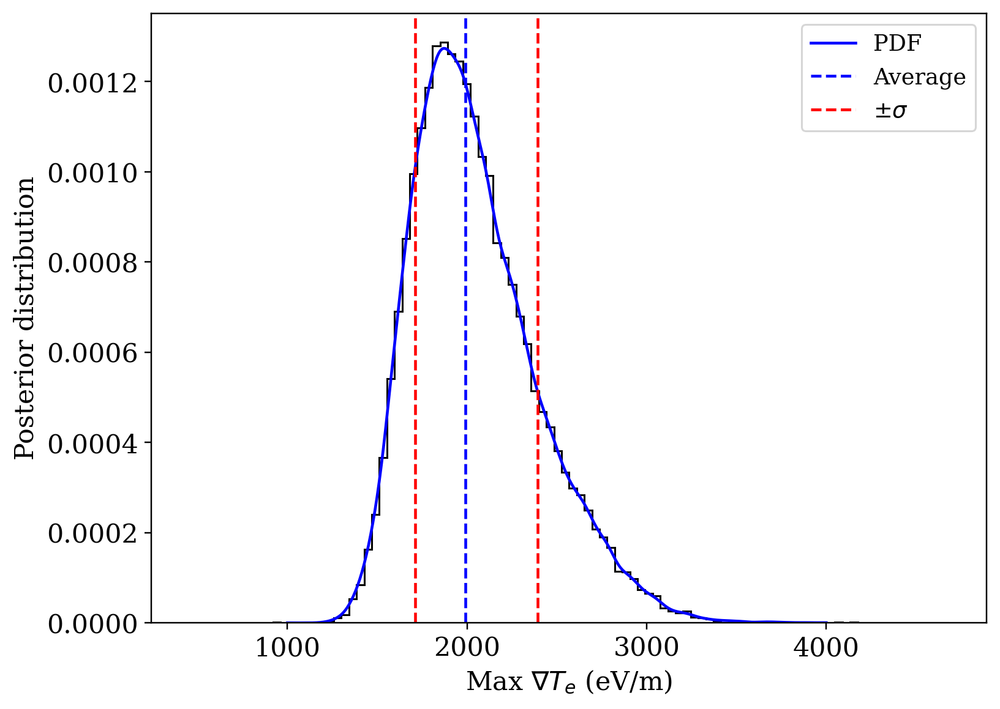

In [137]:
hist = plt.hist(grad_Te_samples, 100, histtype='step', color='black', density=True)

kde = sp.stats.gaussian_kde(grad_Te_samples)
gts = np.linspace(1000, 4000, num=500)
plt.plot(gts, kde(gts), color='blue', label='PDF')

plt.xlabel(r'Max $\nabla T_e$ (eV/m)')
plt.ylabel(r'Posterior distribution')

plt.axvline(x=grad_Te_avg, color='blue', linestyle='--', label='Average')
plt.axvline(x=grad_Te_lower, color='red', linestyle='--', label=r'$\pm\sigma$')
plt.axvline(x=grad_Te_upper, color='red', linestyle='--')
plt.legend();

## Resorting to direct brightness measurements

Since nothing else seems to be working, I want go full Paolo on this problem and use a ratio-based masurement linked to look-up tables for each chord. I will just assume particular $n_C$ and $n_{Al}$ profiles for now, but will use the reconstructed densities. The table will reference $\hat{T}_e$, the peak temperature along a given chord. So without further ado, let's start with a single chord.

Note that this approach didn't work out, but was insightful. However I eventually made progress with the previous approach. So, consider this deprecated.

In [220]:
# Tomography data parameters
t_start = 20.0
t_end = 40.0
delta_t = 0.5
smooth = 10
exclude = [20, 59, 60, 22, 62, 19]

# Load in the tomography data
st = load_brightness(shot, t_start=t_start, t_end=t_end, delta=delta_t, smooth=smooth, exclude=exclude)

% SXR_MST_BOX_GET_SIGNALS: beginning for shot #1200701056
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals in W/m2
% SXR_MST_BOX_GET_SIGNALS: opening MST for shot 1200701056
% Compiled module: WHOAMI.
% Compiled module: FILEBREAK.
% Compiled module: CALC_GEOM_2.
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO time base, Tue Aug  4 15:47:13 2020
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals
% SXR_MST_BOX_GET_SIGNALS: assembling bright structure and transposing matrix
% SXR_MST_BOX_GET_SIGNALS: SXRTOMO done
Time=1.5706310 s


In [255]:
t = 25.0
tn = np.argmin(np.abs(ts - t))

# The chord index
xn = 7

# Format the data vector
y_data = {label:np.concatenate([st.bright[f][:,tn] for f in filter_list(label)])for label in ['thick', 'thin']}
y_sigma = {label:np.concatenate([st.sigma[f][:,tn] for f in filter_list(label)])for label in ['thick', 'thin']}
x_data = np.array([n for n in range(1,41) if n not in exclude])

# Ratios
ratio_data = y_data['thin'] / y_data['thick']
ratio_sigma = ratio_data * np.sqrt( (y_sigma['thick']/y_data['thick'])**2 + (y_sigma['thin']/y_data['thin'])**2 )

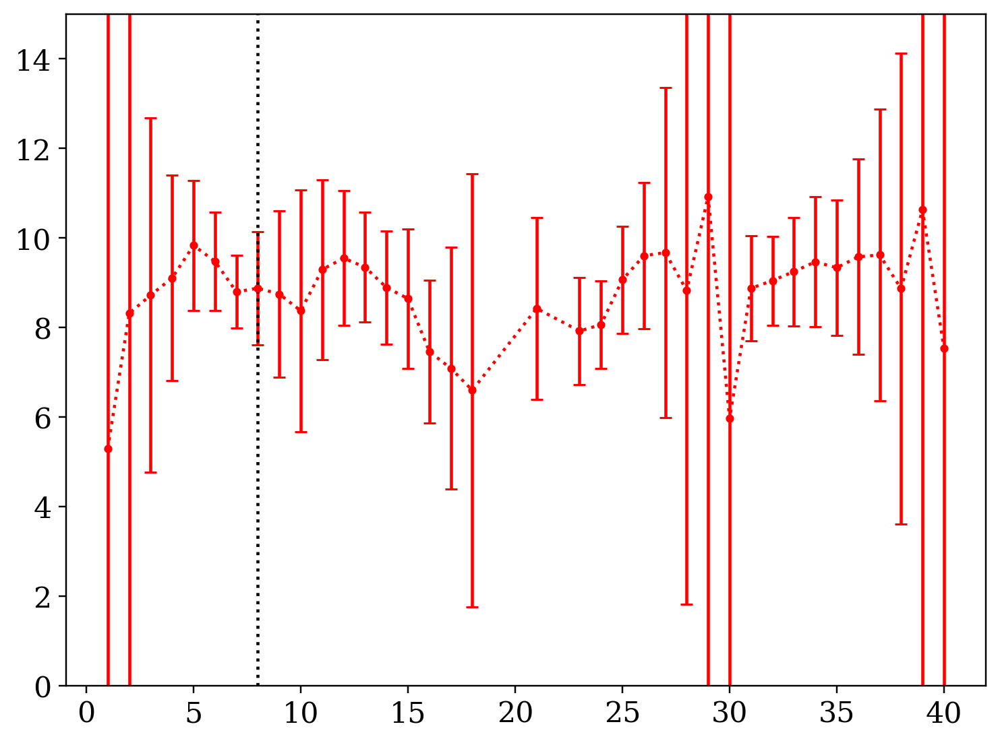

In [242]:
plt.errorbar(x_data, ratio_data, yerr=ratio_sigma, marker='o', ms=3, capsize=3, linestyle=':', color='red')
plt.ylim([0, 15])

plt.axvline(x=x_data[xn], color='black', linestyle=':')

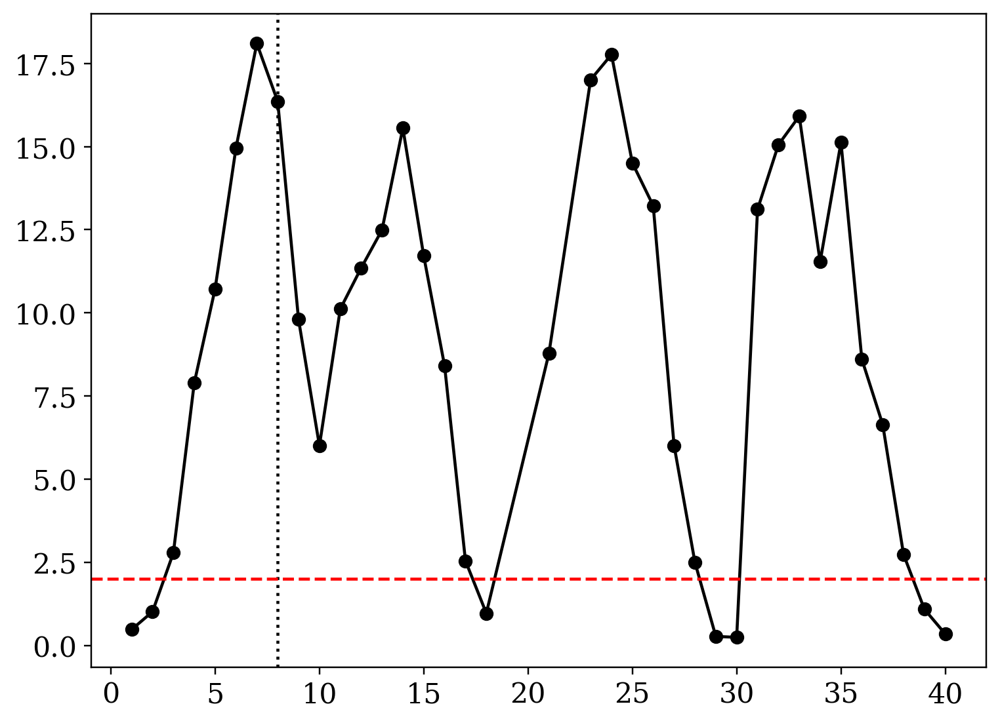

In [263]:
snr = ratio_data/ratio_sigma
plt.plot(x_data, snr, '-ok')
plt.axvline(x=x_data[xn], color='black', linestyle=':')

snr_cutoff = 2
plt.axhline(y=snr_cutoff, color='red', linestyle='--')
indices, = np.where( snr > snr_cutoff)

(0.0, 15.0)

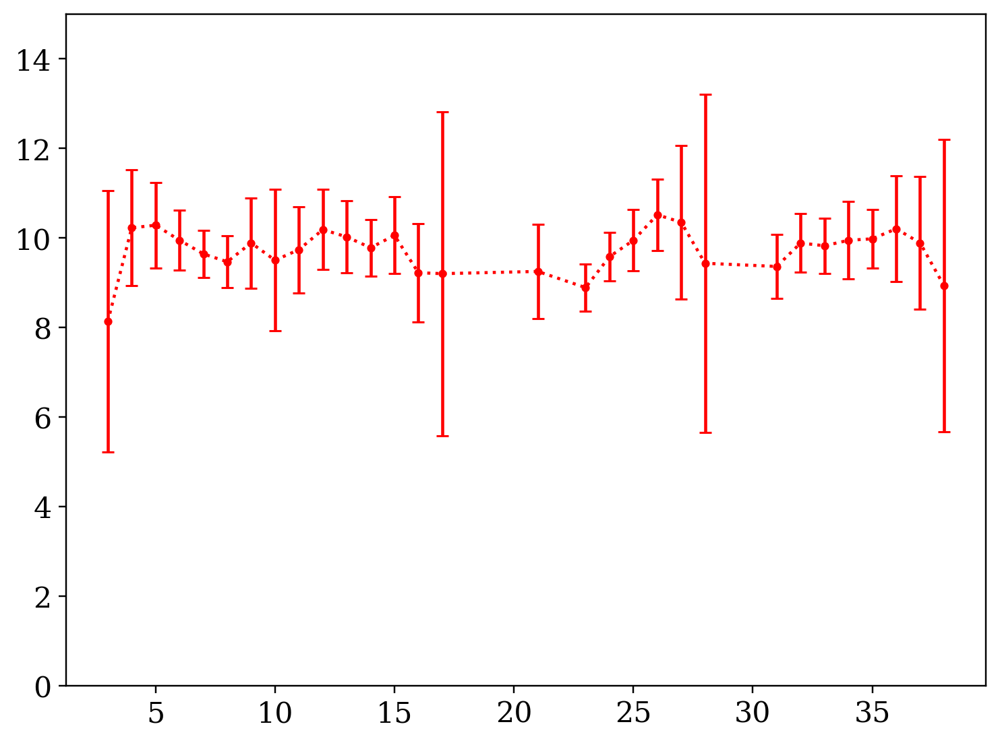

In [264]:
plt.errorbar(x_data[indices], ratio_data[indices], yerr=ratio_sigma[indices], marker='o', ms=3, capsize=3, linestyle=':', color='red')
plt.ylim([0, 15])

In [251]:
sxt_model = SXT(exclude=exclude)
filters = filter_list('thin')
sxt_los = np.concatenate([sxt_model.los[f] for f in filters])
sxt_ps = np.concatenate([sxt_model.p[f] for f in filters])

In [265]:
# Determining the mapping between these chords and flux surfaces

rho_min = np.zeros(indices.shape)
for ii, los in enumerate(sxt_los[indices]):
    a = los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=n_rs)
    xl, yl = los.get_xy(ells)
    rhos = rho_xy(xl, yl, t, label='SXT')
    rho_min[ii] = np.amin(rhos)

(0.0, 15.0)

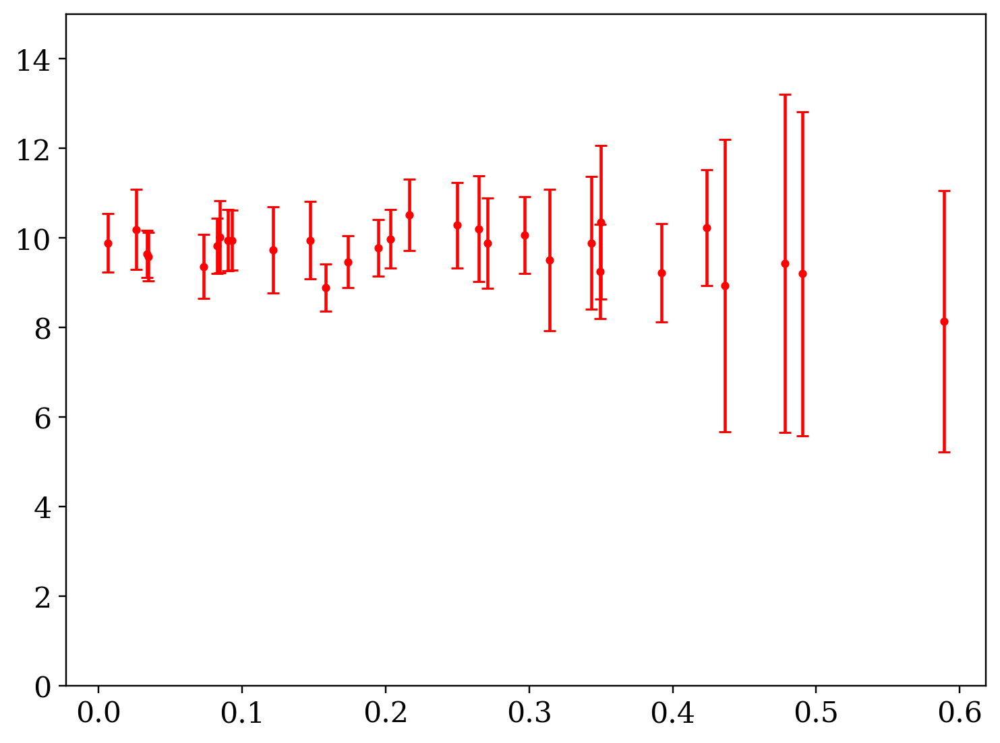

In [266]:
plt.errorbar(rho_min, ratio_data[indices], yerr=ratio_sigma[indices], marker='o', ms=3, capsize=3, linestyle='none', color='red')
plt.ylim([0, 15])

## What do these emissivity profiles look like?

In [267]:
# All of the profiles
def ne_prof(rs, n0, n1, alpha, beta, gamma=100.):
    dens = (n0 - n1) * (1 - rs**alpha)**beta + n1 * (1 - rs**gamma)
    return np.maximum(dens, 0.0)

def n0_prof(rs, nH_0, nH_rm, nH_1, rm):
    core_value = nH_0
    amp = nH_1 - nH_0
    power = np.log( (nH_rm - nH_0)/(nH_1 - nH_0) ) / np.log(rm)
    return core_value + amp*( rs**power )

def nZ_prof(rs, nZ0, alpha_Z, beta_Z):
    return nZ0*(1 - rs**alpha_Z)**beta_Z

def get_nZ_profs(rs, nAl0, nC0, alpha_Z, beta_Z):
    nAl_rs = nZ_prof(rs, nAl0, alpha_Z, beta_Z)
    nC_rs = nZ_prof(rs, nC0, alpha_Z, beta_Z)
    nZ_rs = {'Al':nAl_rs, 'C':nC_rs, 'N':0.3*nC_rs, 'B':0.3*nC_rs, 'O':0.9*nC_rs}
    return nZ_rs

#def temp_prof(rs, Te0, Te1, alpha, beta, dr):
#    return Te0 * (1 - rs**alpha) + Te1 * np.exp( -(rs/dr)**beta)

def temp_prof(rs, Te0, Te1, alpha, beta, gamma=100.):
    temp = (Te0 - Te1) * (1 - rs**alpha)**beta + Te1 * (1 - rs**gamma)
    return np.maximum(temp, 0.0)

In [274]:
t = 25.0
tn = np.argmin(np.abs(ts - t))

# Fixed profiles
n0_params = np.array([2.0, 10.0, 450.0, 0.6])
ne_params = popt_dens[tn,:]

# Fixed parameters
ions = ['Al', 'C', 'O', 'N', 'B']
alpha_T = 12.0
alpha_Z = 12.0
beta_Z = 4.0
gamma = 100.0

# Galante priors
mu_Al = 2.0e-3
mu_C = 6.8e-3
sigma_Al = 0.5e-3
sigma_C = 1.4e-3

# Default vector
#x0 = np.array([300.0, 400.0, 5.0, 0.5, mu_Al, mu_C])
x0 = np.array([500.0, 100.0, 5.0, 10.0])

def get_emiss(Rhos, theta):
    Te0, Te1, alpha_T, beta_T = theta
    Te_params = np.array([Te0, Te1, alpha_T, beta_T])
    nZ_params = np.array([nAl0, nC0, alpha_Z, beta_Z])
    
    # Calculate the base plasma parameters
    Te_rs = temp_prof(Rhos, *Te_params)
    nZ_rs = get_nZ_profs(Rhos, *nZ_params)
    ne_rs = ne_prof(Rhos, *ne_params, gamma=gamma) + 1e-6
    n0_rs = n0_prof(Rhos, *n0_params)
    pts = list( zip( Te_rs.ravel(), ne_rs.ravel(), n0_rs.ravel() ) )

    # Get avg_Z and nD
    avg_Z = get_avg_Z()
    avg_Z_rs = {ion:np.reshape(avg_Z[ion](pts), Rhos.shape) for ion in ions}
    
    nD_rs = np.ones(Rhos.shape)
    for ion in ions:
        nD_rs -= (nZ_rs[ion]/ne_rs)*avg_Z_rs[ion]
    nD_rs *= ne_rs
    nD_rs[nD_rs < 0] = 0.0

    # Get the emissivity
    emiss_rs = {filt:np.zeros(Rhos.shape) for filt in ['thick', 'thin']}
    for filt in ['thick', 'thin']:
        emiss_rs[filt] = ne_rs * nD_rs * np.reshape(sxt_model.emiss['D'][filt](pts), Rhos.shape)
        for ion in ions:
            emiss_rs[filt] += ne_rs * nZ_rs[ion] * np.reshape(sxt_model.emiss[ion][filt](pts), Rhos.shape)

        emiss_rs[filt] *= 1e19 * 1e19
    
    # Add background to thin filters
    for ion in ions:
        emiss_rs['thin']
    
    return emiss_rs

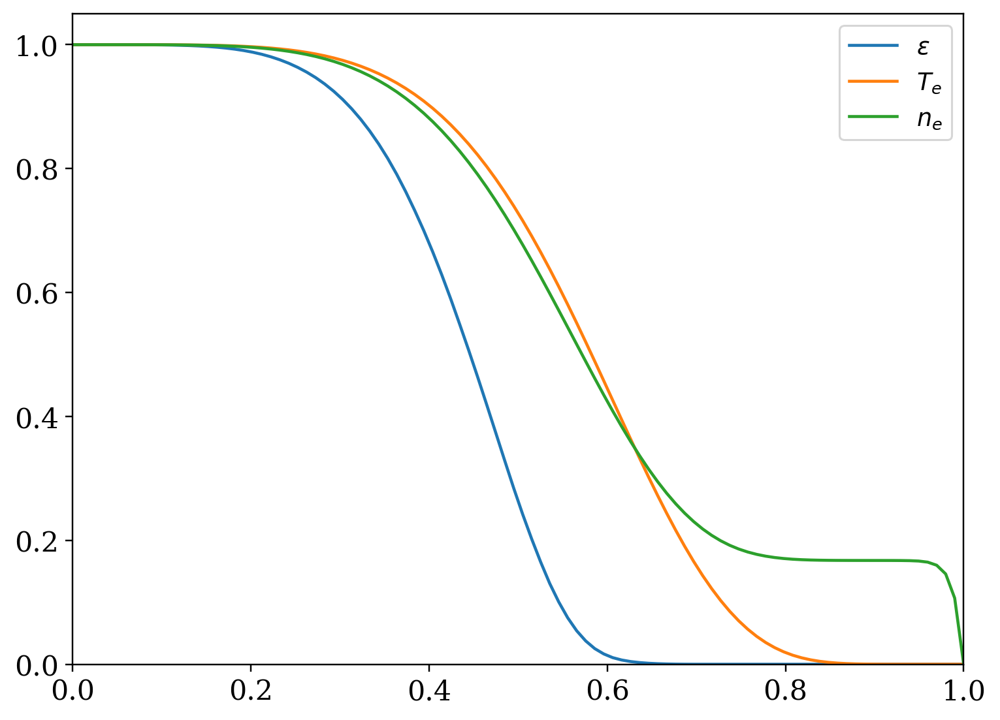

In [289]:
rs = np.linspace(0, 1, num=100)

x0 = np.array([500.0, 0.0, 5.0, 10.0])
emiss = get_emiss(rs, x0)
plt.plot(rs, emiss['thin']/emiss['thin'][0], label=r'$\varepsilon$')

temp = temp_prof(rs, *x0)
plt.plot(rs, temp/temp[0], label=r'$T_e$')

dens = ne_prof(rs, *popt_dens[tn,:])
plt.plot(rs, dens/dens[0], label=r'$n_e$')

plt.legend(loc='upper right')
plt.xlim([0,1])
plt.ylim([0,None]);

## $T_e$ profile over time - Now it works!

In [ ]:
# All of the profiles
def ne_prof(rs, n0, n1, alpha, beta, gamma=100.):
    dens = (n0 - n1) * (1 - rs**alpha)**beta + n1 * (1 - rs**gamma)
    return np.maximum(dens, 0.0)

def n0_prof(rs, nH_0, nH_rm, nH_1, rm):
    core_value = nH_0
    amp = nH_1 - nH_0
    power = np.log( (nH_rm - nH_0)/(nH_1 - nH_0) ) / np.log(rm)
    return core_value + amp*( rs**power )

def nZ_prof(rs, nZ0, alpha_Z, beta_Z):
    return nZ0*(1 - rs**alpha_Z)**beta_Z

def get_nZ_profs(rs, nAl0, nC0, alpha_Z, beta_Z):
    nAl_rs = nZ_prof(rs, nAl0, alpha_Z, beta_Z)
    nC_rs = nZ_prof(rs, nC0, alpha_Z, beta_Z)
    nZ_rs = {'Al':nAl_rs, 'C':nC_rs, 'N':0.3*nC_rs, 'B':0.3*nC_rs, 'O':0.9*nC_rs}
    return nZ_rs

def temp_prof(rs, Te0, beta, dr):
    return Te0 * np.exp( -(rs/dr)**beta)

In [140]:
# Fixed parameters
ions = ['Al', 'C', 'O', 'N', 'B']
alpha_Z = 12.0
beta_Z = 4.0
gamma = 100.0

# Galante priors
mu_Al = 2.0e-3
mu_C = 6.8e-3
sigma_Al = 0.5e-3
sigma_C = 1.4e-3

# Default vector
x0 = np.array([500.0, 2.0, 0.6, mu_Al, 2.0, 0.2])

def get_emiss(Rhos, theta, ne_params=[0.54,  0.12,  4.84, 12.0]):
    Te0, beta_T, dr, nAl0, bg1, bg2 = theta
    Te_params = np.array([Te0, beta_T, dr])
    nZ_params = np.array([nAl0, mu_C, alpha_Z, beta_Z])
    n0_params = np.array([2.0, 10.0, 450.0, 0.6])
    bg = {'thin':bg1, 'thick':bg2}
    
    # Calculate the base plasma parameters
    Te_rs = temp_prof(Rhos, *Te_params)
    nZ_rs = get_nZ_profs(Rhos, *nZ_params)
    ne_rs = ne_prof(Rhos, *ne_params, gamma=gamma) + 1e-6
    n0_rs = n0_prof(Rhos, *n0_params)
    pts = list( zip( Te_rs.ravel(), ne_rs.ravel(), n0_rs.ravel() ) )

    # Get avg_Z and nD
    avg_Z = get_avg_Z()
    avg_Z_rs = {ion:np.reshape(avg_Z[ion](pts), Rhos.shape) for ion in ions}
    
    nD_rs = np.ones(Rhos.shape)
    for ion in ions:
        nD_rs -= (nZ_rs[ion]/ne_rs)*avg_Z_rs[ion]
    nD_rs *= ne_rs
    nD_rs[nD_rs < 0] = 0.0

    # Get the emissivity
    emiss_rs = {filt:np.zeros(Rhos.shape) for filt in ['thick', 'thin']}
    for filt in ['thick', 'thin']:
        emiss_rs[filt] = ne_rs * nD_rs * np.reshape(sxt_model.emiss['D'][filt](pts), Rhos.shape)
        for ion in ions:
            emiss_rs[filt] += ne_rs * nZ_rs[ion] * np.reshape(sxt_model.emiss[ion][filt](pts), Rhos.shape)

        emiss_rs[filt] *= 1e19 * 1e19
        emiss_rs[filt] += bg[filt]
    
    return emiss_rs

def get_model(Rhos, Dx, theta, ne_params=[0.54,  0.12,  4.84, 12.0]):
    emiss_rs = get_emiss(Rhos, theta, ne_params=ne_params)
    return np.concatenate([np.sum(emiss_rs[filt] * Dx, axis=0) for filt in ['thick', 'thin']])

In [174]:
ts = np.arange(20, 40.5, 0.5)
n_rs = 500
gamma = 100.0

# MLE parameters
x0_default = np.array([
        500.0,   # Te0
        2.0,     # beta_T
        0.6,     # dr
        mu_Al,   # nAl0
        2.0,     # bg1
        0.2      # bg2
])
n_params = len(x0_default)

             # Te0 # beta_T  #dr  # nAl0  # bg1  #bg2
bounds = ( [   0.0,    0.1, 0.2,    1e-4,     0,    0], # Lower
           [1000.0,    5.0, 1.0,    1e-2,     6,    1]) # Upper

# Make the detector object
sxt_model = SXT(exclude=exclude)
filters = filter_list('all')
sxt_los = np.concatenate([sxt_model.los[f] for f in filter_list('thin')])
sxt_ps = np.concatenate([sxt_model.p[f] for f in filter_list('thin')])
labels = np.concatenate([[f]*len(sxt_model.los[f]) for f in filters])
x_data = np.array([n for n in range(1,81) if n not in exclude])
n_chords = len(sxt_los)

# Containers for the results
ps = np.linspace(0, 1, num=100)
popt_temp = np.zeros([len(ts), n_params])
pcov_temp = np.zeros([len(ts), n_params, n_params])
temp_MLE = np.zeros([len(ts), len(ps)])

for ii,t in enumerate(tqdm(ts)):
    # Load the data
    t = 40. if t > 40. else t
    tn = np.argmin(np.abs(st.time - (t - dt/2) ))
    y_data = np.concatenate([st.bright[f][:,tn] for f in filters])
    y_sigma = np.concatenate([st.sigma[f][:,tn] for f in filters])
    
    # Set the default MLE
    if ii == 0:
        x0 = x0_default
    else:
        x0 = popt_temp[ii-1,:]
    
    # Build the Rhos matrix
    Rhos = np.zeros([n_rs, n_chords])
    Xs = np.zeros([n_rs, n_chords])
    for jj, los in enumerate(sxt_los):
        a = los.intercept_with_circle(0.52)
        ells = np.linspace(-a, a, num=n_rs)
        xl, yl = los.get_xy(ells)
        Rhos[:,jj] = rho_xy(xl, yl, t)
        Xs[:, jj] = ells

    # Explicitly limit the Rhos matrix to between 0 and 1
    Rhos[Rhos < 0] = 0.0
    Rhos[Rhos > 1] = 1.0

    # Delta matrix for quick trapezoidal integration
    Dx = np.ones(Xs.shape)
    Dx[0,:] = Dx[1,:] = 0.5
    for j in range(n_chords):
        Dx[:,j] *= Xs[1,j] - Xs[0,j]
    
    # Use nonlinear least-squares to find the optimal fits
    def func(x_data, Te0, beta_T, dr, nAl0, bg1, bg2):
        theta = np.array([Te0, beta_T, dr, nAl0, bg1, bg2])
        return get_model(Rhos, Dx, theta, ne_params=popt_dens[tn,:])

    popt, pcov = sp.optimize.curve_fit(func, x_data, y_data, p0=x0, bounds=bounds, sigma=y_sigma, absolute_sigma=True)
    
    # Generate the profiles
    temp_MLE[ii,:] = temp_prof(ps, *popt[:3])
    popt_temp[ii,:] = popt
    pcov_temp[ii,:,:] = pcov

100%|██████████| 41/41 [13:55<00:00, 20.37s/it]


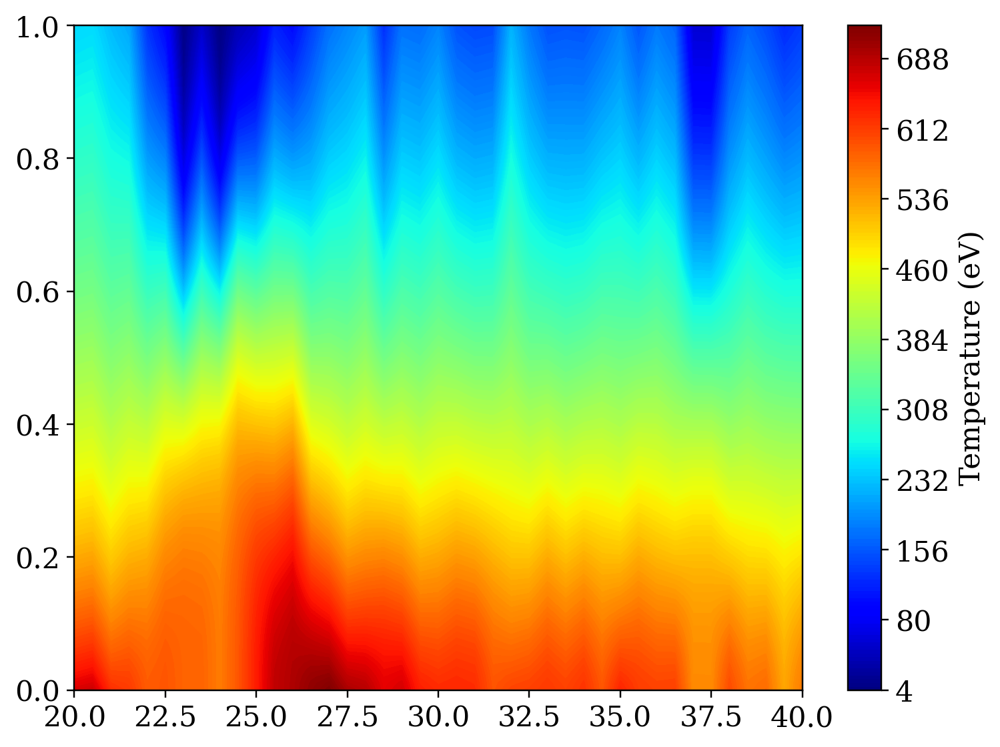

In [199]:
cax = plt.contourf(ts, ps, temp_MLE.T, 200, cmap=cm.jet)
cb = plt.colorbar(cax, label='Temperature (eV)')

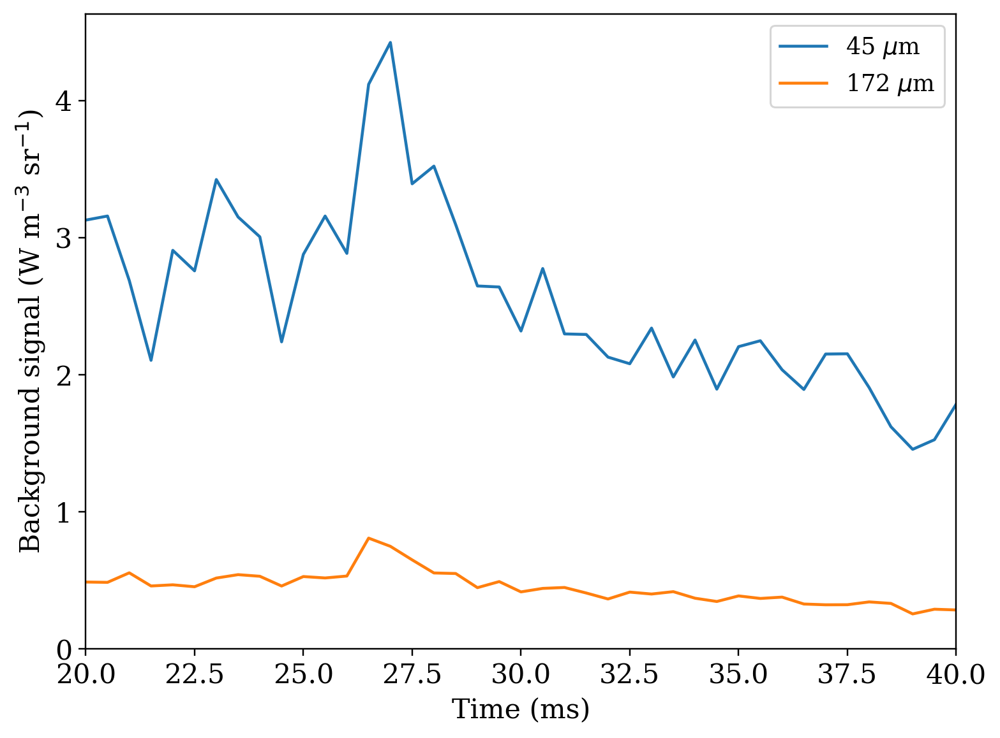

In [428]:
plt.plot(ts, popt_temp[:,4], label=r'45 $\mu$m')
plt.plot(ts, popt_temp[:,5], label=r'172 $\mu$m')

plt.legend()
plt.xlim([20,40])
plt.ylim([0,None])
plt.xlabel('Time (ms)')
plt.ylabel(r'Background signal (W m$^{-3}$ sr$^{-1}$)');

In [176]:
emiss = np.zeros([len(ts), len(ps)])
for tn in range(len(ts)):
    emiss[tn,:] = get_emiss(ps, popt_temp[tn,:], ne_params=popt_dens[tn,:])['thin']

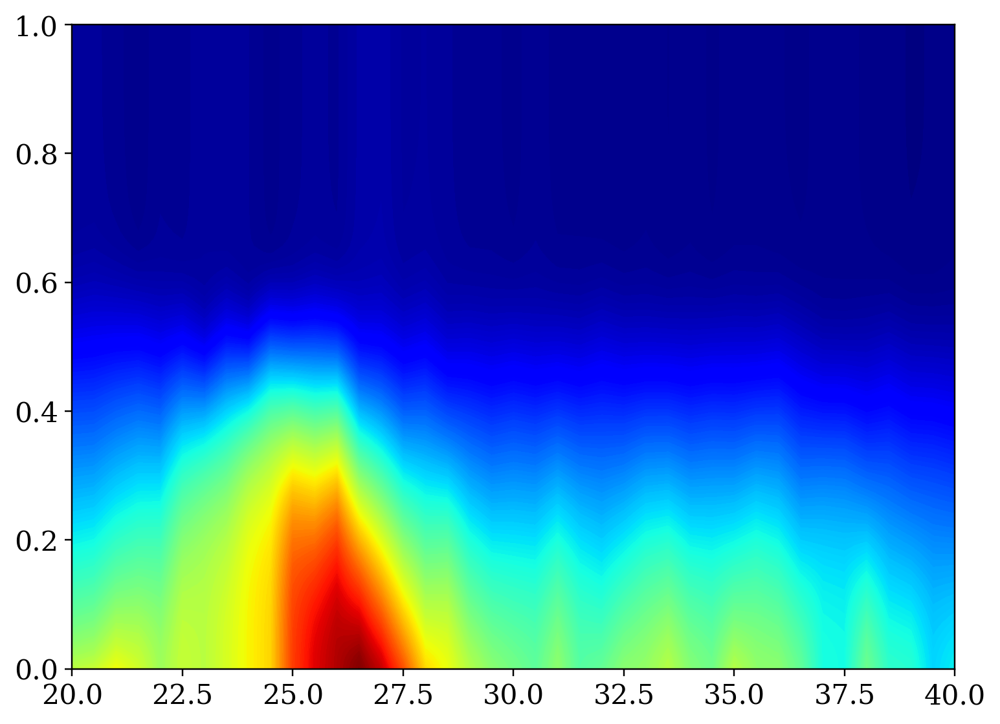

In [183]:
plt.contourf(ts, ps, emiss.T, 200, cmap=cm.jet)

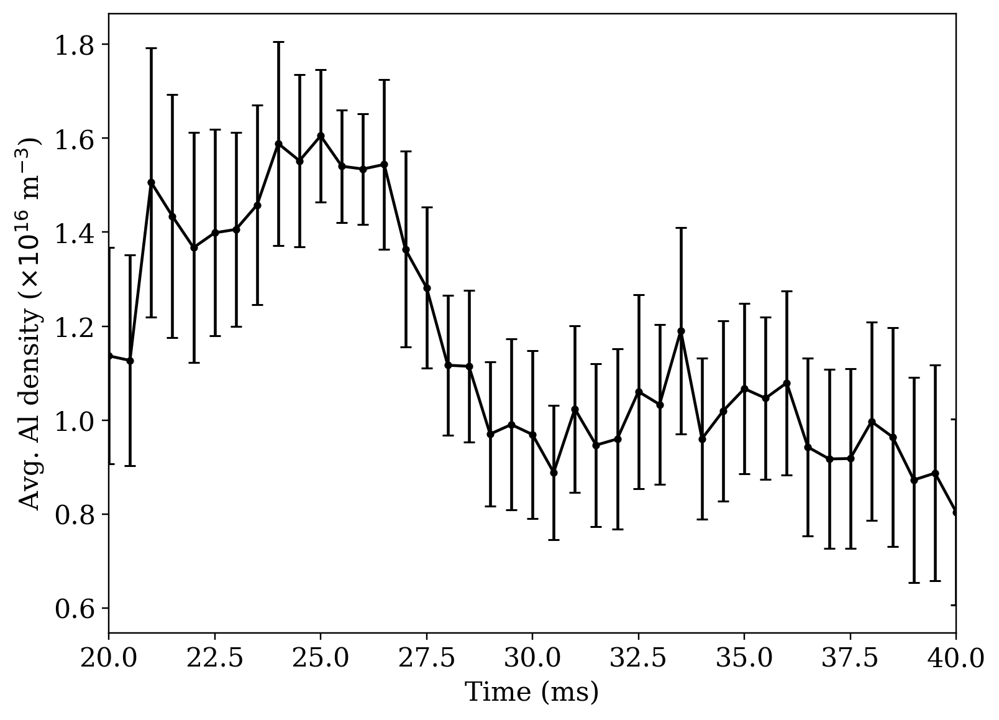

In [193]:
nAls = popt_temp[:,3]
nAl_errs = np.sqrt(pcov_temp[:, 3, 3])

plt.errorbar(ts, nAls/1e-3, yerr=nAl_errs/1e-3, marker='o', ms=3, capsize=3, color='black', linestyle='-')
plt.xlabel('Time (ms)')
plt.ylabel(r'Avg. Al density ($\times 10^{16}$ m$^{-3}$)')
plt.xlim([20,40]);

In [438]:
t = 25.0

# Illustrate agreement with the diagnostic signals
t = 40. if t > 40. else t
tn = np.argmin(np.abs(st.time - (t - dt/2) ))

# Get the data
y_data = np.concatenate([st.bright[f][:,tn] for f in filters])
y_sigma = np.concatenate([st.sigma[f][:,tn] for f in filters])

# Build the Rhos matrix
Rhos = np.zeros([n_rs, n_chords])
Xs = np.zeros([n_rs, n_chords])
for jj, los in enumerate(sxt_los):
    a = los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=n_rs)
    xl, yl = los.get_xy(ells)
    Rhos[:,jj] = rho_xy(xl, yl, t)
    Xs[:, jj] = ells

# Explicitly limit the Rhos matrix to between 0 and 1
Rhos[Rhos < 0] = 0.0
Rhos[Rhos > 1] = 1.0

# Delta matrix for quick trapezoidal integration
Dx = np.ones(Xs.shape)
Dx[0,:] = Dx[1,:] = 0.5
for j in range(n_chords):
    Dx[:,j] *= Xs[1,j] - Xs[0,j]

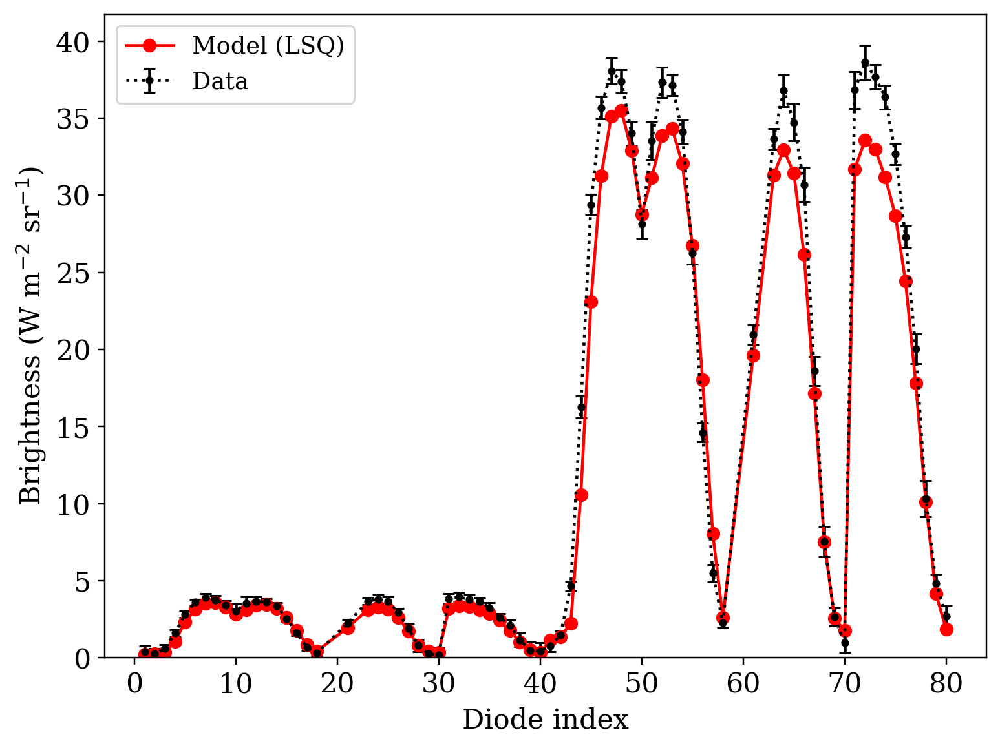

In [439]:
plt.errorbar(x_data, y_data, yerr=y_sigma, marker='o', ms=3, capsize=3, linestyle=':', color='black', label='Data')

y_model = get_model(Rhos, Dx, popt_temp[tn,:], ne_params=popt_dens[tn,:])
plt.plot(x_data, y_model, '-or', label='Model (LSQ)')

plt.legend()
plt.xlabel('Diode index')
plt.ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')
plt.ylim([0, None]);

## Time dynamics - temperature gradient

In [221]:
import mst_ida.data.mst_ops as ops
mags = ops.get_magnetics(shot, t_start=ts[0], t_end=ts[-1], delta_t=0.5, modes=np.arange(1,16))

In [906]:
num_samples = 500
num_pts = 100

grad_Te_set = np.zeros(ts.shape)
grad_Te_err = np.zeros(ts.shape)

for tn,t in enumerate(ts):
    t = 40. if t > 40. else t

    # Find the o-point
    xs, ys = sunflower_points(5000)
    rhos = rho_xy(xs, ys, t, label='SXT')
    n_op = np.argmin(rhos)
    x_op = xs[n_op]
    y_op = ys[n_op]

    # Get the chord parameters
    delta = get_delta(t)
    impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op) + np.pi
    impact_p = delta * np.cos(impact_phi)

    # Plot the chord
    los = line_of_sight(impact_p, impact_phi)
    ell_max = los.intercept_with_circle(0.52)
    ells = np.linspace(-ell_max, ell_max, num=num_pts)
    xl, yl = los.get_xy(ells)
    rhos = rho_xy(xl, yl, t)

    Te_X_samples = np.zeros([num_samples, num_pts])

    for index in range(num_samples):
        samples = sp.stats.multivariate_normal.rvs(mean=popt_temp[tn,:], cov=pcov_temp[tn,:,:])
        Te_X_samples[index,:] = temp_prof(rhos, *samples[:3])

    grad_Te_samples = np.zeros(num_samples)

    # New - require that grad_Te be negative to avoid artifacts
    for index in range(num_samples):
        temp = Te_X_samples[index,:]
        grad_Te = np.gradient(temp, ells)
        grad_Te_samples[index] = np.abs(np.amin(grad_Te))
        
    grad_Te_avg, grad_Te_lower, grad_Te_upper = ida.confidence_interval(grad_Te_samples)
    
    # Package the results
    grad_Te_set[tn] = grad_Te_avg
    grad_Te_err[tn] = (grad_Te_upper - grad_Te_lower) / 2

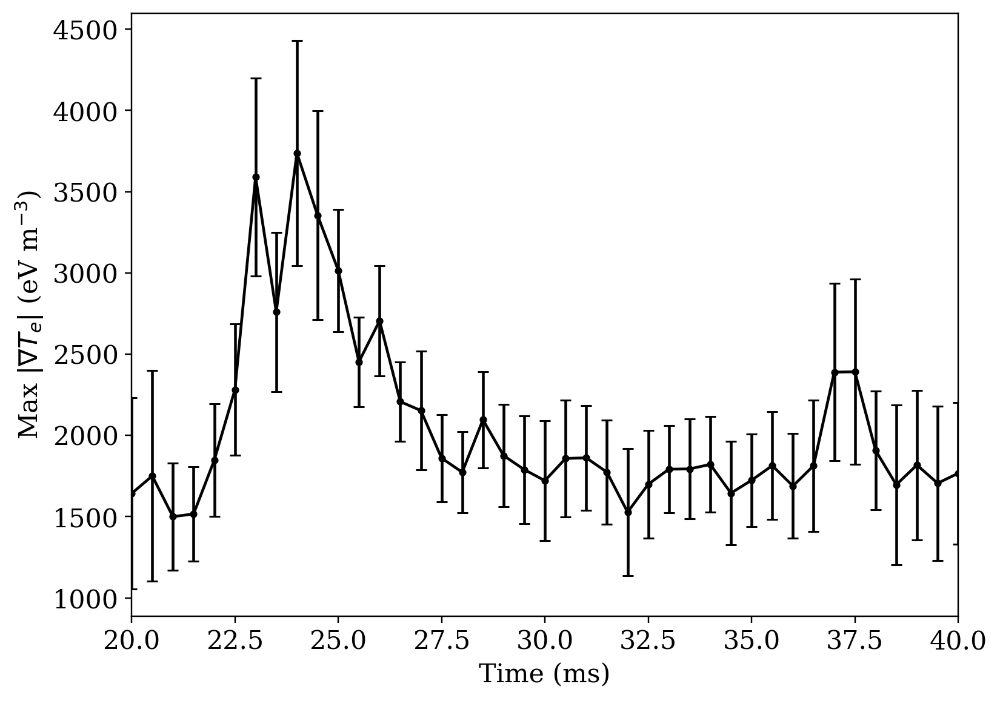

In [907]:
plt.errorbar(ts, grad_Te_set, yerr=grad_Te_err, marker='o', ms=3, capsize=3, color='black', linestyle='-')
plt.xlabel('Time (ms)')
plt.ylabel(r'Max $|\nabla T_e|$ (eV m$^{-3}$)')
plt.xlim([20,40]);

In [916]:
# What about just the average?
ells = np.linspace(-0.45, 0.45, num=100)
prof_T = np.zeros([len(ts), len(ells)])
grad_T = np.zeros([len(ts), len(ells)])
grad_T_max = np.zeros(len(ts))

for t in ts:
    t = 40. if t > 40. else t
    tn = np.argmin(np.abs(ts - t))

    # Find the o-point
    xs, ys = sunflower_points(5000)
    rhos = rho_xy(xs, ys, t, label='SXT')
    n_op = np.argmin(rhos)
    x_op = xs[n_op]
    y_op = ys[n_op]

    # Get the chord parameters
    delta = get_delta(t)
    impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op) + np.pi
    impact_p = np.abs(delta * np.cos(impact_phi))

    # Plot the chord
    los = line_of_sight(impact_p, impact_phi)
    xl, yl = los.get_xy(ells)
    rhos = rho_xy(xl, yl, t)

    prof_T[tn,:] = temp_prof(rhos, *popt_temp[tn, :3])
    grad_T[tn,:] = np.gradient(prof_T[tn,:], ells)
    grad_T_max[tn] = np.amax(np.abs(grad_T[tn,:]))

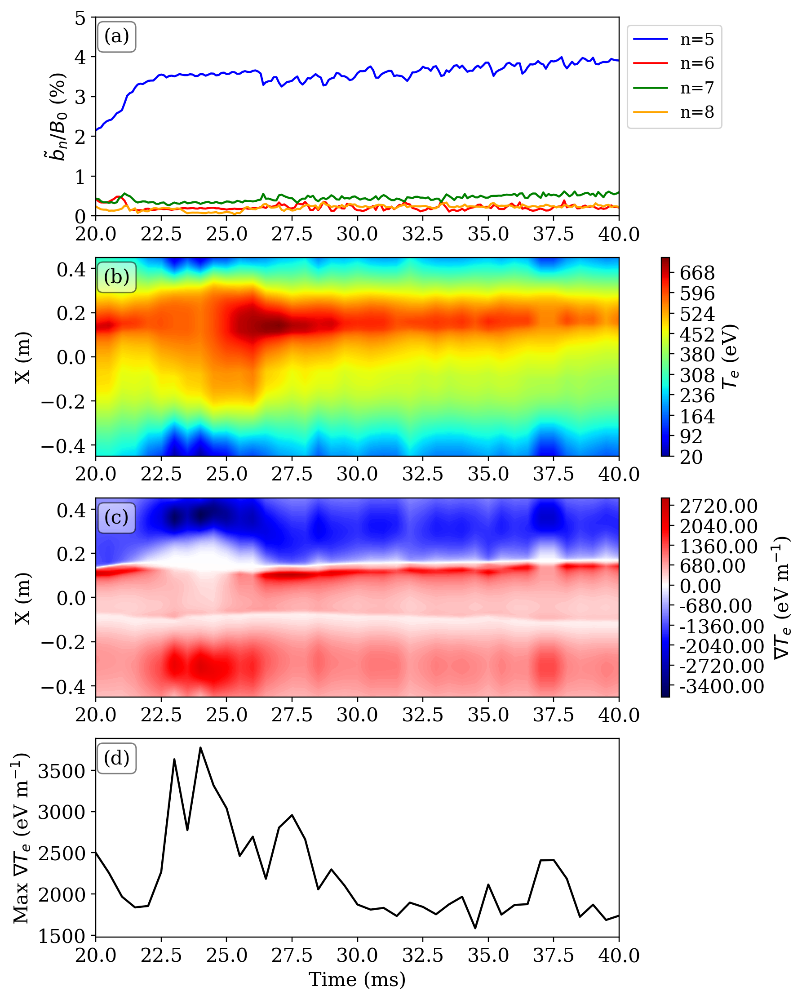

In [917]:
fig, axs = plt.subplots(4, 1, constrained_layout=True, figsize=(8,10))
props = dict(boxstyle='round', facecolor='white', alpha=0.5)

# Magnetics signals    
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7,8], ['blue','red','green','orange']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left', bbox_to_anchor=(1.00, 1.0))
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (%)')
axs[0].set_ylim([0,5])

# Temperature
cax = axs[1].contourf(ts, ells, prof_T.T, 200, cmap=cm.jet, vmin=0)
fig.colorbar(cax, ax=axs[1], label=r'$T_e$ (eV)')
axs[1].set_ylabel(r'X (m)')

# Gradient
cax = axs[2].contourf(ts, ells, grad_T.T, 200, cmap=cm.seismic, vmin=-3850, vmax=3850)
cb = fig.colorbar(cax, ax=axs[2], label=r'$\nabla T_e$ (eV m$^{-1}$)')
cb.ax.set_yticklabels(["{:.2f}".format(i) for i in cb.get_ticks()])
axs[2].set_ylabel(r'X (m)')

# Max gradient
axs[3].plot(ts, grad_T_max, color='black')
axs[3].set_ylabel(r'Max $\nabla T_e$ (eV m$^{-1}$)')

for ax,alpha in zip(axs,['a','b','c','d']):
    text(0.04, 0.9, r'({0:})'.format(alpha), ax, fontsize=14, color='black', bbox=props)
    ax.set_xlim([ts[0], ts[-1]])
    
axs[-1].set_xlabel('Time (ms)');

(27.5, 40.0)

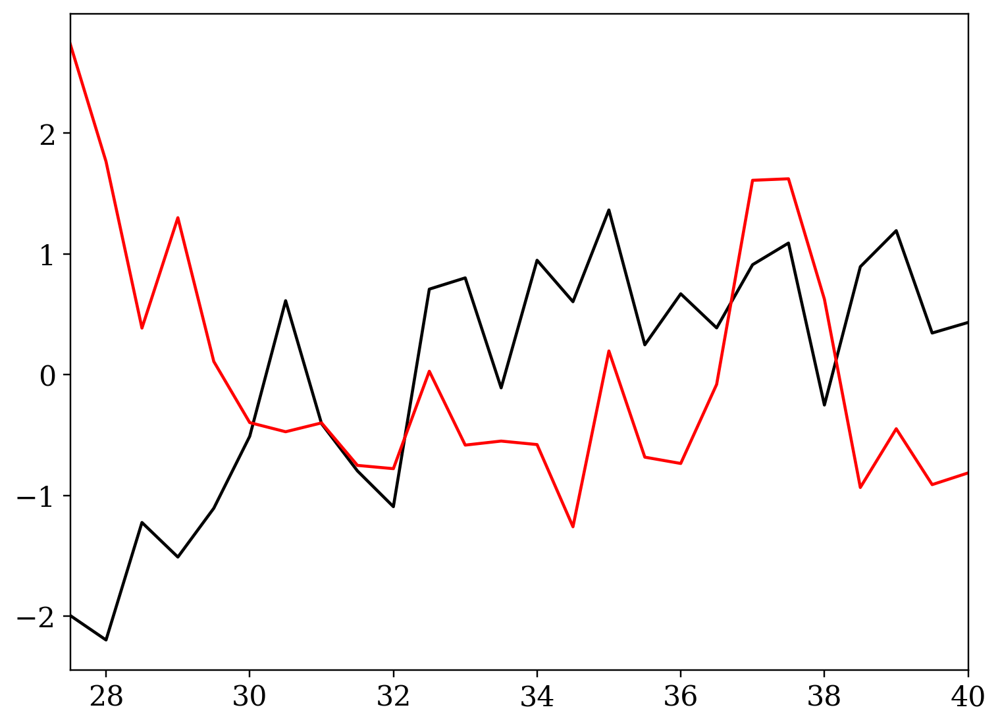

In [298]:
n0 = np.argmin(np.abs(ts - 27.5))

b5 = np.sqrt(mags.BP['N05']['Amplitude']**2 + mags.BT['N05']['Amplitude'])
yb = (b5[n0:] - np.average(b5[n0:])) / np.std(b5[n0:])
plt.plot(mags.Time[n0:], yb, label='n={0:d}'.format(n), color='black')

yT = yb = (grad_T_max[n0:] - np.average(grad_T_max[n0:])) / np.std(grad_T_max[n0:])
plt.plot(ts[n0:], yT, color='red')
plt.xlim([27.5, 40])

## Time dynamics - pressure

I am particularly interested in looking at pressure (and $\beta$) over time. The internal magnetic field profiles will come from SHEq. For now I will assume we want the total $\beta$ profile, rather than just the toroidal or poloidal components.

$$
    \beta = \frac{p}{B^2 / 2 \mu_0}
$$

where $p = n_e T_e$ is the thermal pressure (an energy density, really).

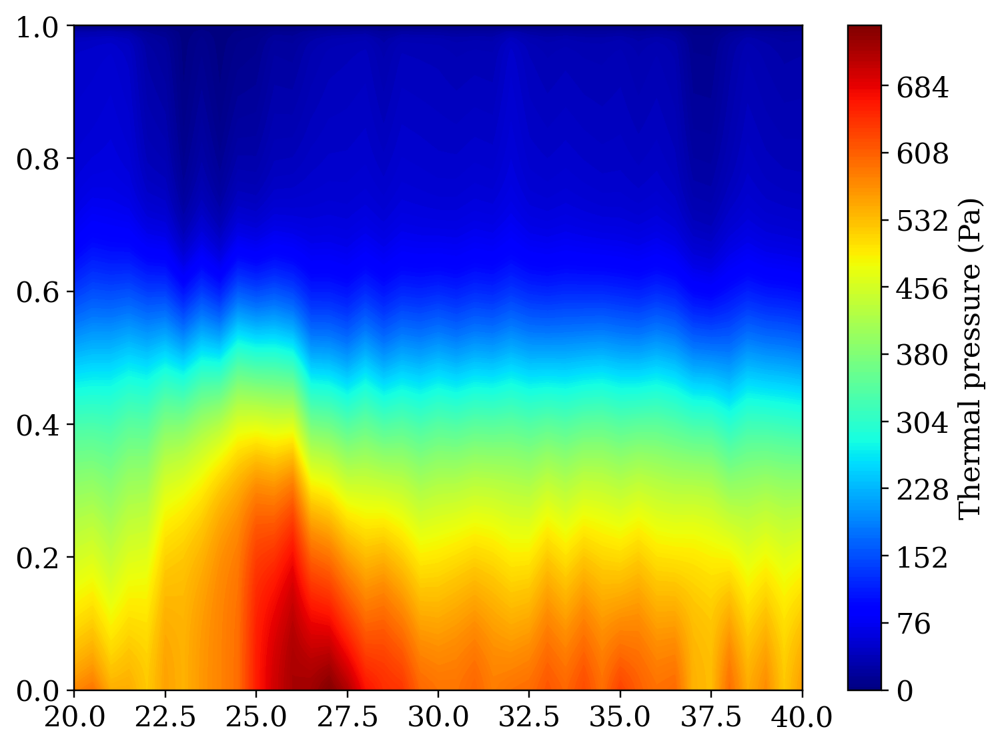

In [312]:
pressure = temp_MLE * dens_MLE * 1.602 # J m^-3 = Pa

cax = plt.contourf(ts, ps, pressure.T, 200, cmap=cm.jet)
cb = plt.colorbar(cax, label=r'Thermal pressure (Pa)')

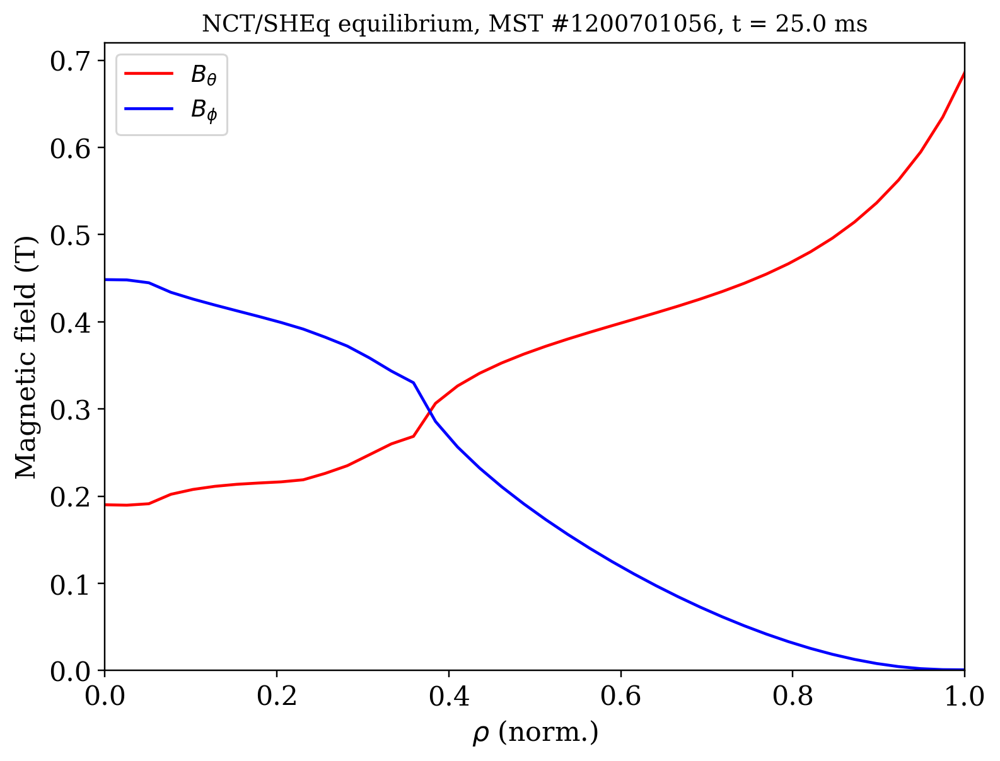

In [440]:
tm = 14
plt.plot(avgs[tm].rhoh, avgs[tm].B_pol, color='red', label=r'$B_\theta$')
plt.plot(avgs[tm].rhoh, -avgs[tm].B_tor, color='blue', label=r'$B_\phi$')

plt.legend()
plt.xlim([0,1])
plt.ylim([0,None])
plt.xlabel(r'$\rho$ (norm.)')
plt.ylabel('Magnetic field (T)')
plt.title(r'NCT/SHEq equilibrium, MST #{0:10d}, t = {1:.1f} ms'.format(shot, times[tm]));

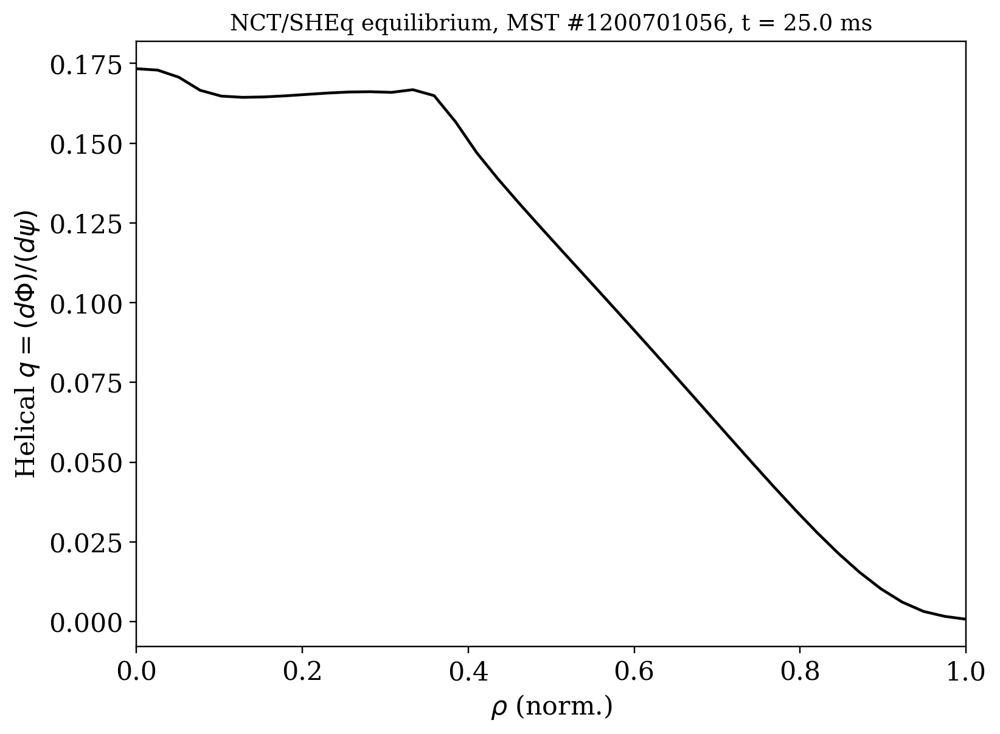

In [422]:
plt.plot(avgs[tm].rhoh, avgs[tm].q, color='black')

plt.xlim([0,1])
#plt.ylim([0,None])
plt.xlabel(r'$\rho$ (norm.)')
plt.ylabel('Helical $q = (d\Phi)/(d\psi)$')
plt.title(r'NCT/SHEq equilibrium, MST #{0:10d}, t = {1:.1f} ms'.format(shot, times[tm]));

In [372]:
# Constants
mu0 = 1.2566e-6    # H m^-1
eVe19_to_J = 1.602 # 1e19 eV = 1 J

# Just use the intersection of the SHEq times and the previous analysis
beta_ts = np.sort(list(set(times).intersection(set(ts))))
beta_ps = avgs[0].rhoh

# Containers
thermal_pressure = np.zeros([len(beta_ts), len(beta_ps)])
mag_pressure = np.zeros([len(beta_ts), len(beta_ps)])

for ii,t in enumerate(beta_ts):
    tn = np.argmin(np.abs(ts - t))
    tm = np.argmin(np.abs(times - t))
    
    mag_pressure[ii,:] = avgs[tm].B2 / (2*mu0)
    press = temp_MLE[tn,:] * dens_MLE[tn,:]
    thermal_pressure[ii,:] = np.interp(beta_ps, ps, press) * eVe19_to_J
    
# Quick fix for a single bad time point
mag_pressure[5,1] = (mag_pressure[5,0] + mag_pressure[5,2])/2

# Get beta
beta_vals = thermal_pressure / mag_pressure * 100.0

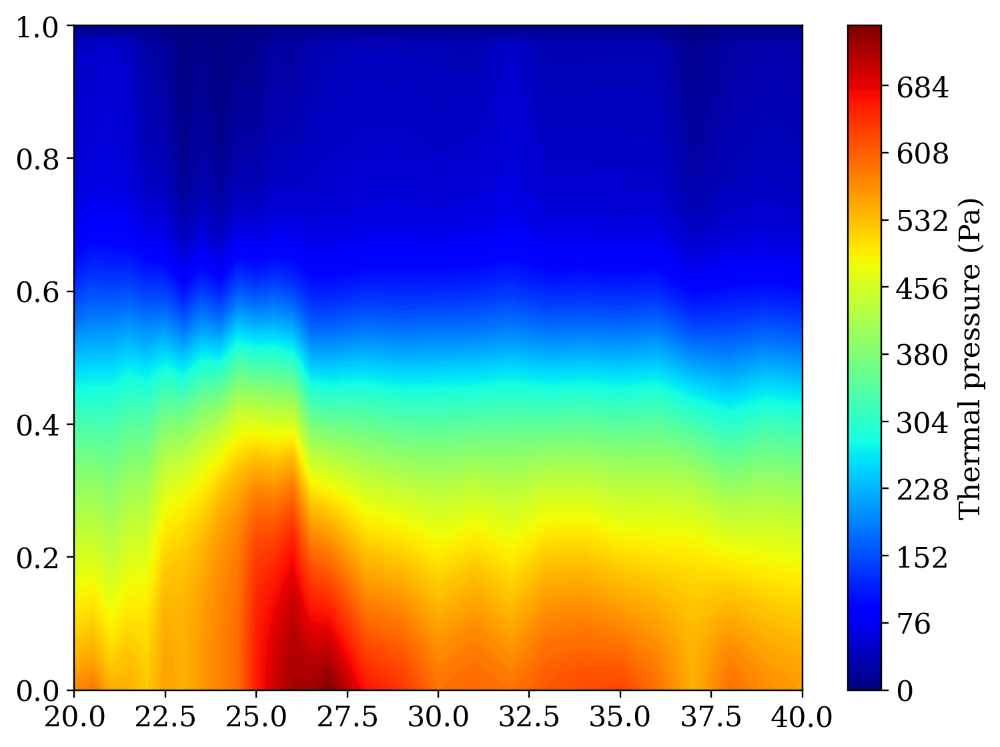

In [350]:
cax = plt.contourf(beta_ts, beta_ps, thermal_pressure.T, 200, cmap=cm.jet)
cb = plt.colorbar(cax, label=r'Thermal pressure (Pa)')

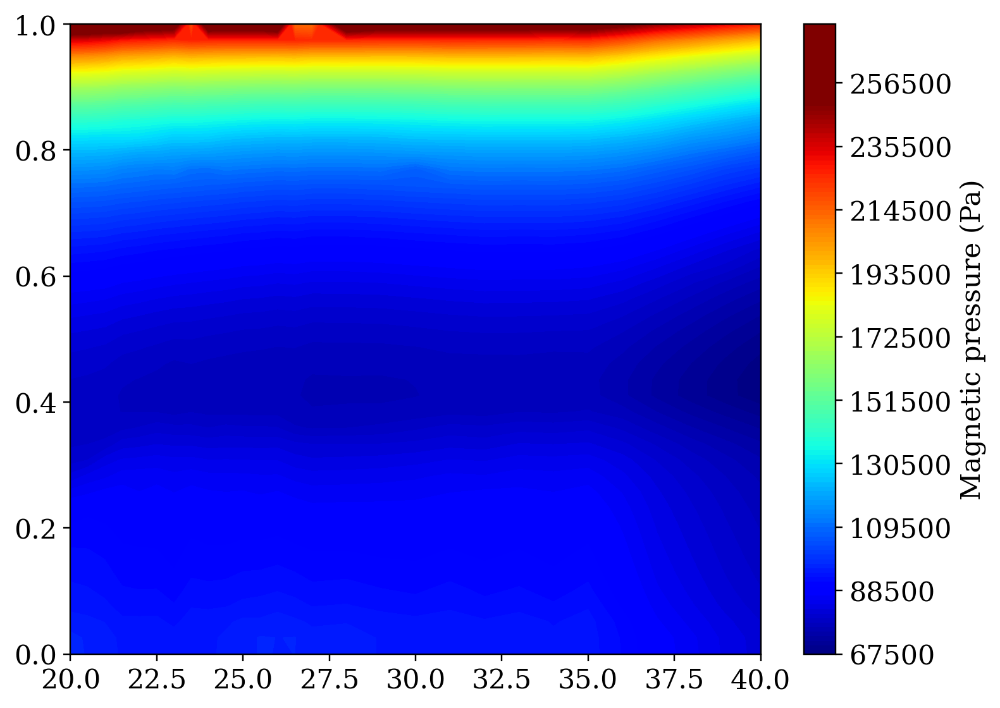

In [446]:
cax = plt.contourf(beta_ts, beta_ps, mag_pressure.T, 200, cmap=cm.jet, vmax=250000)
cb = plt.colorbar(cax, label=r'Magnetic pressure (Pa)')

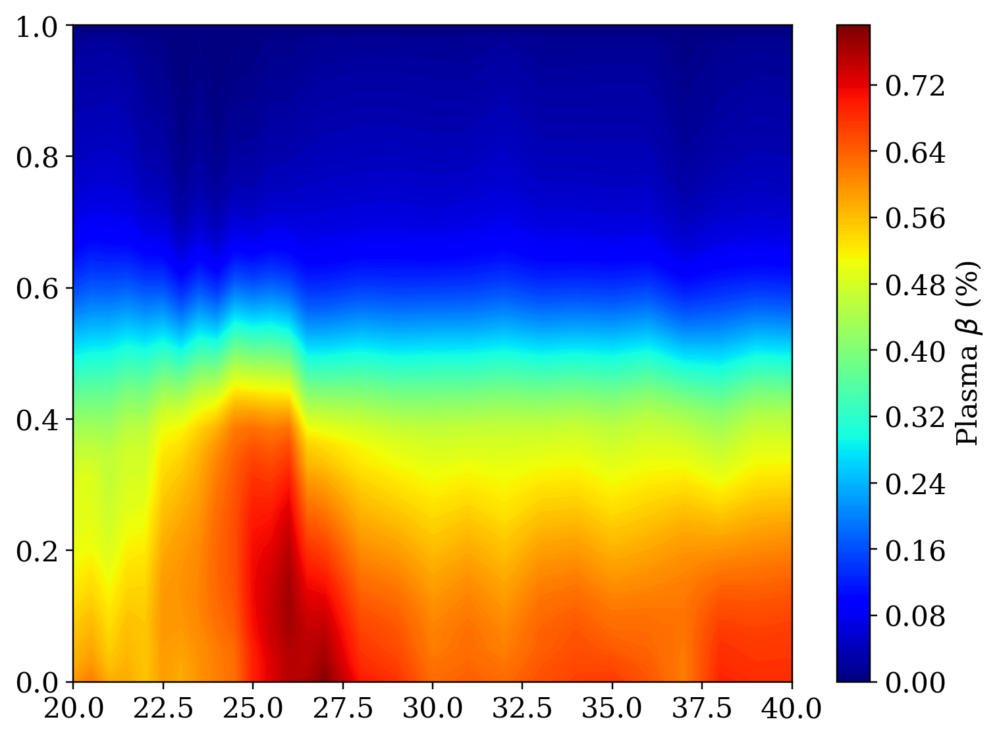

In [375]:
cax = plt.contourf(beta_ts, beta_ps, beta_vals.T, 200, cmap=cm.jet)
cb = plt.colorbar(cax, label=r'Plasma $\beta$ (%)')

Realization: the definition for $\beta$ also considers the pressure from the ion species. For impurities this will be negligible, but it may be substantial for deuterium ions. I will use $T_e \approx T_i$, which was a conclusion John Boguski's thesis came to. I will calculate $n_D$ using charge-neutrality.

Update... that correction was totally wrong. No matter, it's not terribly important at this point.

In [445]:
# Calculate the Deutermium density
deut_MLE = np.zeros(dens_MLE.shape)

for tn in range(len(ts)):
    n0_params = np.array([2.0, 10.0, 450.0, 0.6])
    nZ_params = np.array([popt_temp[tn,3], mu_C, alpha_Z, beta_Z])

    Te_ps = temp_MLE[tn,:]
    ne_ps = dens_MLE[tn,:] + 1e-6
    nZ_ps = get_nZ_profs(ps, *nZ_params)
    n0_ps = n0_prof(ps, *n0_params)
    pts = list( zip( Te_ps, ne_ps, n0_ps ) )

    avg_Z = get_avg_Z()
    avg_Z_ps = {ion:avg_Z[ion](pts) for ion in ions}

    nD_ps = np.ones(ps.shape)
    for ion in ions:
        nD_ps -= (nZ_ps[ion]/ne_ps)*avg_Z_ps[ion]
    nD_ps *= ne_ps
    nD_ps[nD_ps < 0] = 0.0
    
    deut_MLE[tn,:] = nD_ps

In [552]:
# Constants
mu0 = 1.2566e-6    # H m^-1
eVe19_to_J = 1.602 # Convert 1e19 eV to J

# Just use the intersection of the SHEq times and the previous analysis
beta_ts = np.sort(list(set(times).intersection(set(ts))))
beta_ps = avgs[0].rhoh

# Containers
thermal_pressure = np.zeros([len(beta_ts), len(beta_ps)])
ion_pressure = np.zeros([len(beta_ts), len(beta_ps)])
mag_pressure = np.zeros([len(beta_ts), len(beta_ps)])

for ii,t in enumerate(beta_ts):
    tn = np.argmin(np.abs(ts - t))
    tm = np.argmin(np.abs(times - t))
    
    mag_pressure[ii,:] = avgs[tm].B2 / (2*mu0)
    
    press = temp_MLE[tn,:] * dens_MLE[tn,:] * eVe19_to_J
    thermal_pressure[ii,:] = np.interp(beta_ps, ps, press)
    
    press = (temp_MLE[tn,:]/3.) * deut_MLE[tn,:] * eVe19_to_J
    ion_pressure[ii,:] = np.interp(beta_ps, ps, press)
    
# Quick fix for a single bad time point
mag_pressure[5,1] = (mag_pressure[5,0] + mag_pressure[5,2])/2

# Get beta
beta_vals = (thermal_pressure + ion_pressure) / mag_pressure * 100.0

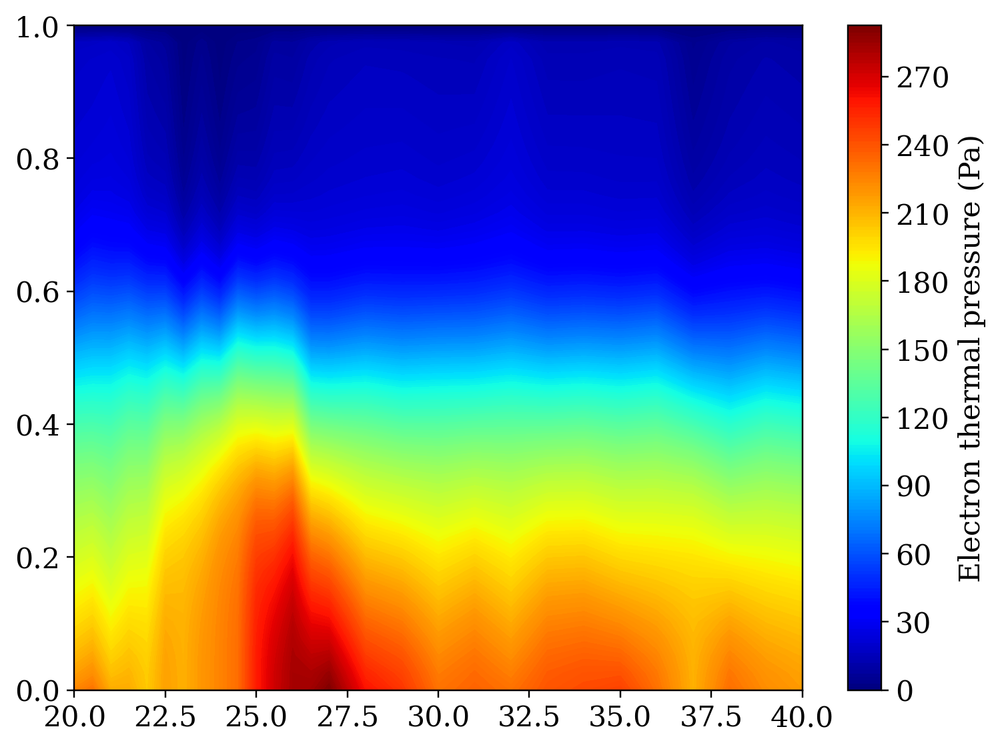

In [555]:
cax = plt.contourf(beta_ts, beta_ps, thermal_pressure.T, 200, cmap=cm.jet)
cb = plt.colorbar(cax, label=r'Electron thermal pressure (Pa)')

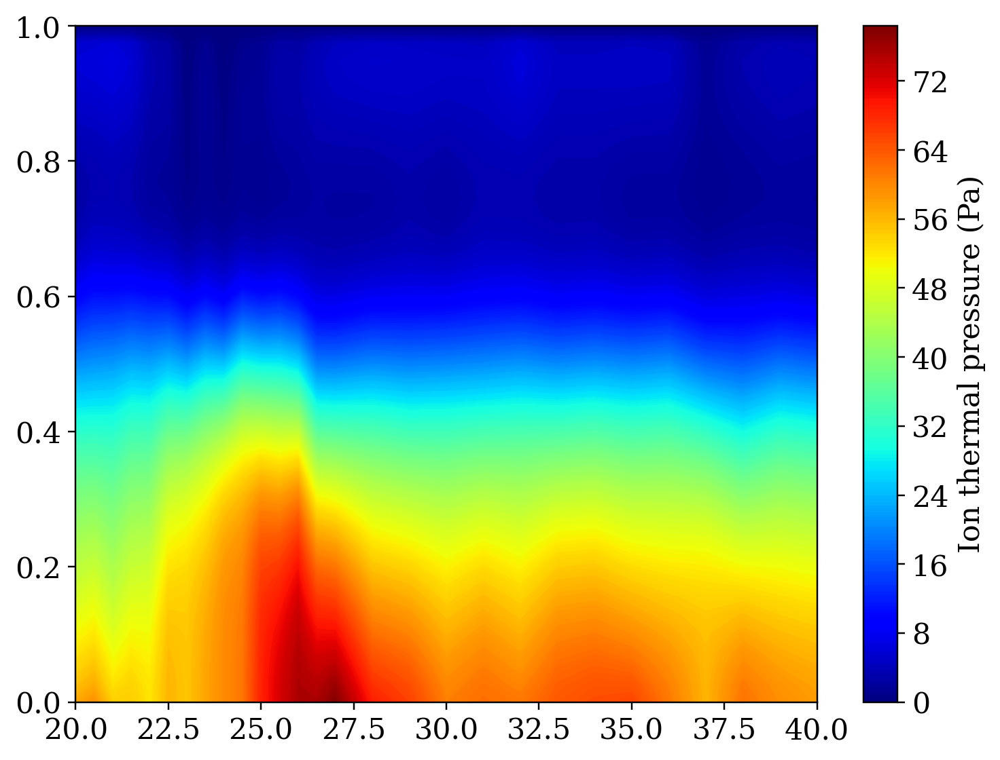

In [554]:
cax = plt.contourf(beta_ts, beta_ps, ion_pressure.T, 200, cmap=cm.jet)
cb = plt.colorbar(cax, label=r'Ion thermal pressure (Pa)')

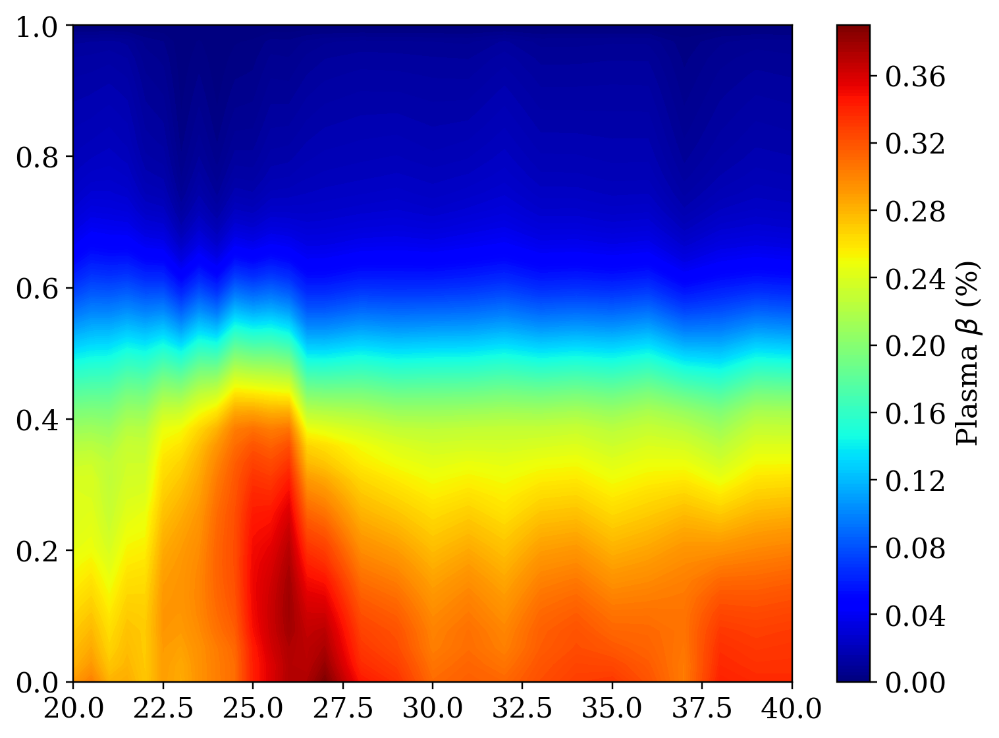

In [556]:
cax = plt.contourf(beta_ts, beta_ps, beta_vals.T, 200, cmap=cm.jet)
cb = plt.colorbar(cax, label=r'Plasma $\beta$ (%)')

## Time dynamics - the full picture

In [378]:
# Evaluate the gradient over time
prof_n = np.zeros([len(ts), len(ells)])
grad_n = np.zeros([len(ts), len(ells)])
grad_n_max = np.zeros(len(ts))
grad_n_x0 = np.zeros(len(ts))

for t in tqdm(ts):
    # Avoid issue with rounding on last frame
    t = 40. if t > 40. else t
    tn = np.argmin(np.abs(ts - t))
    delta = get_delta(t)

    # Load the rhos
    xs, ys = sunflower_points(5000)
    rs = rho_xy(xs, ys, t, label='FIR_P')

    # Find the o-point
    n_op = np.argmin(rs)
    x_op = xs[n_op]
    y_op = ys[n_op]

    # Get the line of sight
    impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op)
    impact_p = delta * np.cos(impact_phi)
    los = line_of_sight(impact_p, impact_phi)
    xl, yl = los.get_xy(ells)
    rhos = rho_xy(xl, yl, t)
    ne_ls = ne_prof(rhos, *popt_dens[tn,:], gamma=gamma)
    
    # Get the gradient
    prof_n[tn,:] =  ne_ls
    grad_n[tn,:] = np.gradient(ne_ls, ells)
    grad_n_max[tn] = np.amax(np.abs(grad_n[tn,:]))
    grad_n_x0[tn] = ells[np.argmax(np.abs(grad_n[tn,:]))]

100%|██████████| 41/41 [00:36<00:00,  1.13it/s]


In [403]:
mags = ops.get_magnetics(shot, t_start=ts[0], t_end=ts[-1], delta_t=0.1, modes=np.arange(1,16))

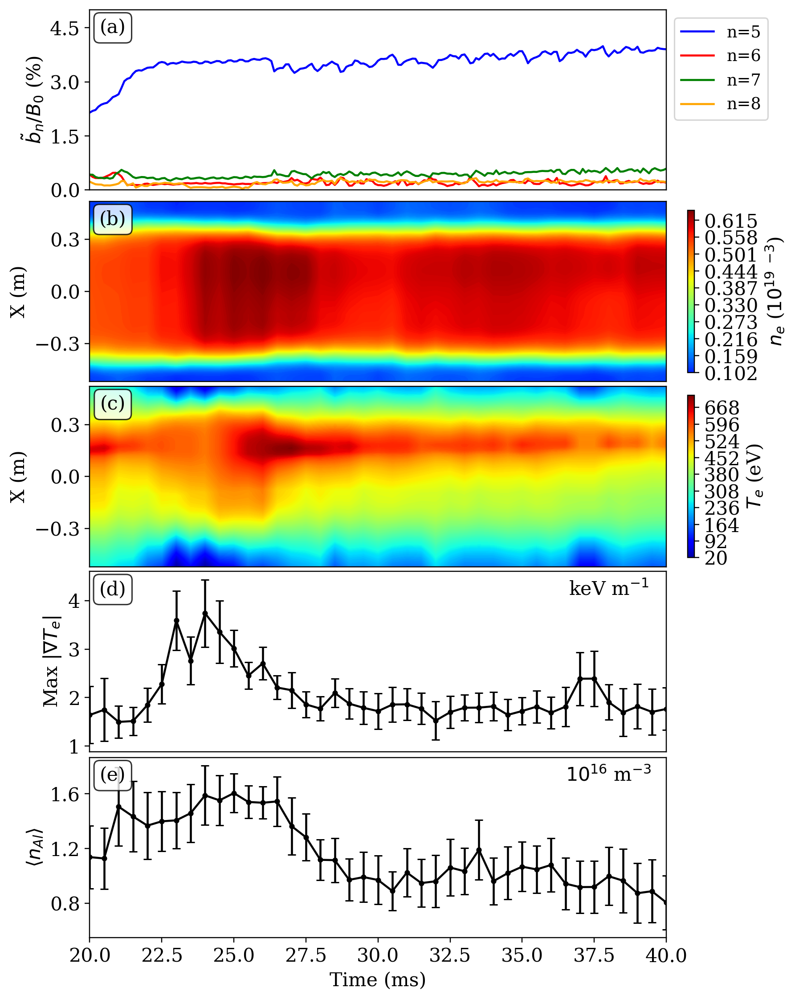

In [908]:
fig, axs = plt.subplots(5, 1, constrained_layout=True, figsize=(8,10))
props = dict(boxstyle='round', facecolor='white', alpha=0.8)

# Magnetics signals
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7,8], ['blue','red','green','orange']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left', bbox_to_anchor=(1.00, 1.0))
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (%)')
axs[0].set_ylim([0,5])

# Density
cax = axs[1].contourf(ts, ells, prof_n.T, 200, cmap=cm.jet, vmin=0)
cb1 = fig.colorbar(cax, ax=axs[1], label=r'$n_e$ ($10^{19}$ $^{-3}$)', shrink=0.9)
axs[1].set_ylabel(r'X (m)')

# Temperature
cax = axs[2].contourf(ts, ells, prof_T.T, 200, cmap=cm.jet, vmin=0)
cb2 = fig.colorbar(cax, ax=axs[2], label=r'$T_e$ (eV)', shrink=0.9)
axs[2].set_ylabel(r'X (m)')

# Gradient
axs[3].errorbar(ts, grad_Te_set/1000., yerr=grad_Te_err/1000., marker='o', ms=3, capsize=3, color='black', linestyle='-')
axs[3].set_ylabel(r'Max $|\nabla T_e|$')
text(0.9, 0.9, r'keV m$^{-1}$', axs[3], fontsize=14, color='black')

# Aluminum
axs[4].errorbar(ts, nAls/1e-3, yerr=nAl_errs/1e-3, marker='o', ms=3, capsize=3, color='black', linestyle='-')
axs[4].set_ylabel(r'$\langle n_{Al} \rangle$')
text(0.9, 0.9, r'$10^{16}$ m$^{-3}$', axs[4], fontsize=14, color='black')

for ax,alpha in zip(axs,['a','b','c','d', 'e']):
    text(0.04, 0.9, r'({0:})'.format(alpha), ax, fontsize=14, color='black', bbox=props)
    ax.set_xlim([ts[0], ts[-1]])
    ax.yaxis.set_major_locator(MaxNLocator(nbins=4, prune='upper'))
    #ax.axvline(x=26.4, color='black', linestyle=':', linewidth=1)

for ax in axs[:-1]:
    ax.set_xticks([])
    
axs[-1].set_xlabel('Time (ms)')
fig.set_constrained_layout_pads(hspace=0, h_pad=0);

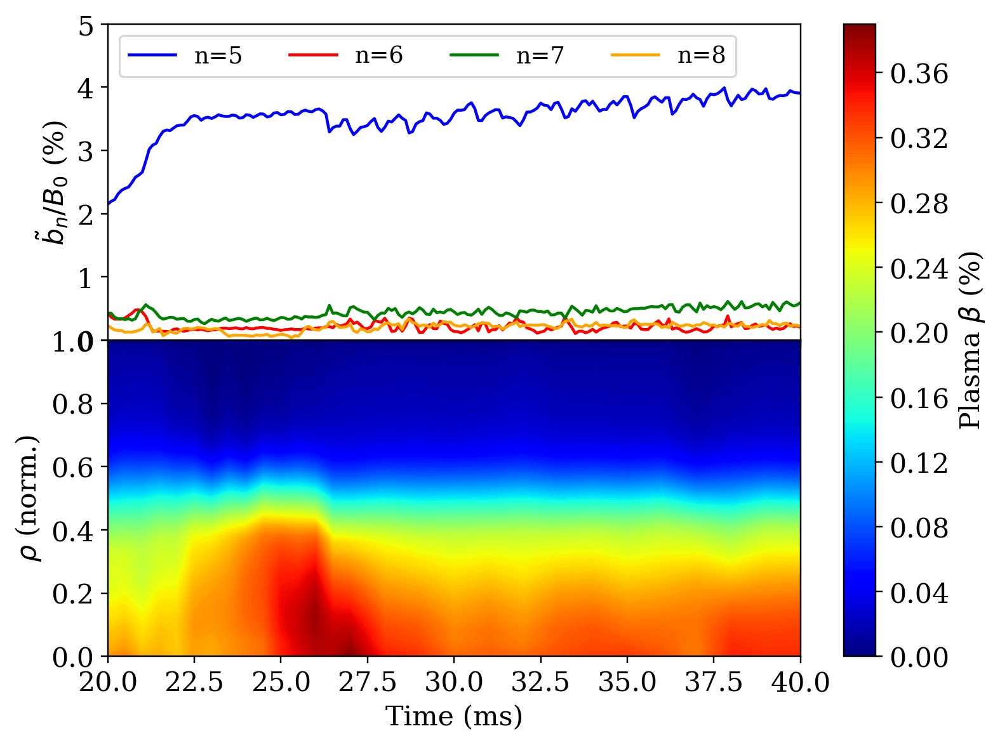

In [557]:
fig, axs = plt.subplots(2,1)

# Magnetics signals    
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7,8], ['blue','red','green','orange']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left', ncol=4)
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (%)')
axs[0].set_ylim([0,5])

# Emissivity
cax = axs[1].contourf(beta_ts, beta_ps, beta_vals.T, 200, cmap=cm.jet)
axs[1].set_ylabel(r'$\rho$ (norm.)')

# Format the axes
for ax in axs[:-1]:
    ax.xaxis.set_ticklabels([])

for ax in axs:
    ax.set_xlim([ts[0], ts[-1]])
    
axs[-1].set_xlabel('Time (ms)')
plt.subplots_adjust(wspace=0, hspace=0)
fig.colorbar(cax, ax=axs, label=r'Plasma $\beta$ (%)');

## Map of $|\nabla T_e|$

In [476]:
t = 24.0
tn = np.argmin(np.abs(ts - t))

xs = np.linspace(-0.52, 0.52, num=100)
ys = np.linspace(-0.52, 0.52, num=100)
xx, yy = np.meshgrid(xs, ys, indexing='ij')
rhos = np.reshape(rho_xy(xx.ravel(), yy.ravel(), t), xx.shape)

Te_xy = temp_prof(rhos, *popt_temp[tn,:3])

In [520]:
# Compute the gradients
grad_x, grad_y = np.gradient(Te_xy, xs, ys)
grad_xy = np.sqrt(grad_x**2 + grad_y**2)

# Mask locations outside of the torus
grad_xy[xx**2 + yy**2 > 0.53**2] = np.nan
Te_xy[xx**2 + yy**2 > 0.53**2] = np.nan

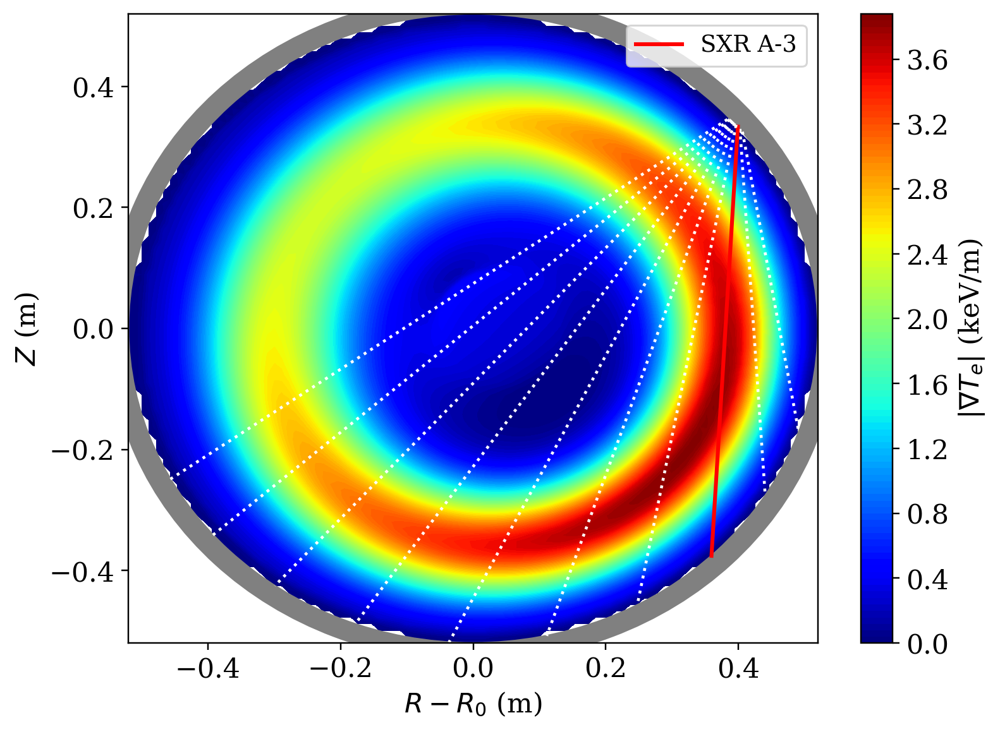

In [538]:
cax = plt.contourf(xs, ys, grad_xy.T/1e3, 100, cmap=cm.jet)
plt.colorbar(cax, label=r'$|\nabla T_e|$ (keV/m)')
overplot_shell(plt.gca())

index = 3

# Overplot SXR-A chords
for ii, los in enumerate(sxt_model.los['A thin'], 1):
    ell_max = los.intercept_with_circle(0.52)
    ells = np.linspace(-ell_max, ell_max, num=100)
    xl, yl = los.get_xy(ells)
    if ii == index:
        plt.plot(xl, yl, linestyle='-', color='red', linewidth=2, label='SXR A-{0:}'.format(index))
    else:
        plt.plot(xl, yl, linestyle=':', color='white')
        
plt.legend()
plt.xlabel(r'$R - R_0$ (m)')
plt.ylabel(r'$Z$ (m)')
plt.xlim([-0.52, 0.52])
plt.ylim([-0.52, 0.52]);

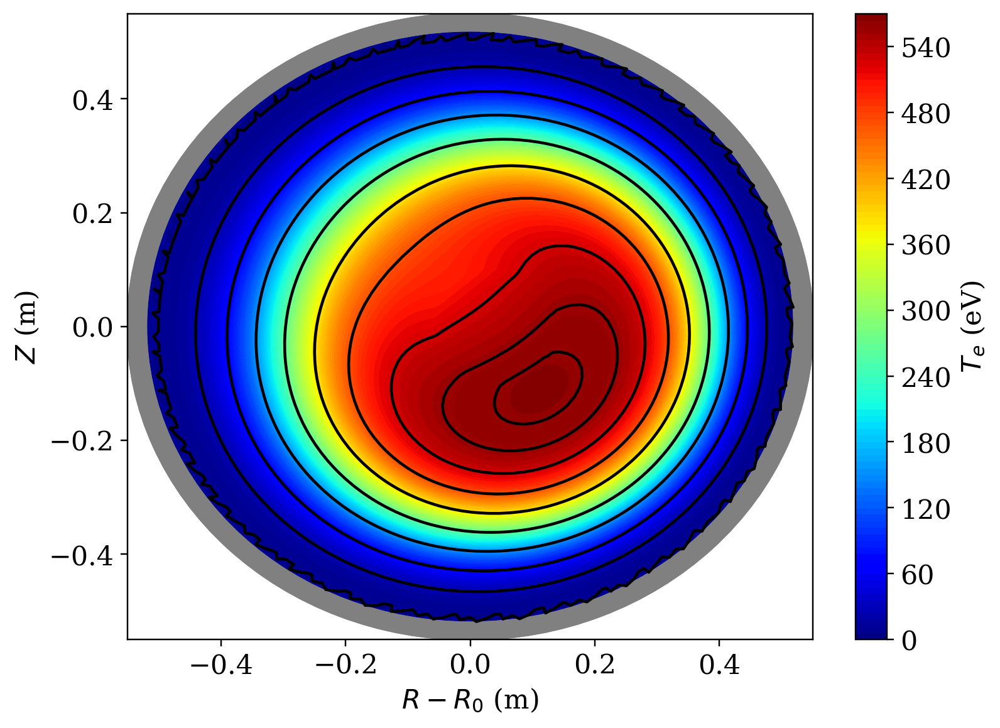

In [545]:
cax = plt.contourf(xs, ys, Te_xy.T, 100, cmap=cm.jet)
plt.colorbar(cax, label=r'$T_e$ (eV)')
overplot_shell(plt.gca())

xs, ys = sunflower_points(5000)
rhos = rho_xy(xs, ys, t, label='SXT')
cax2 = plt.tricontour(xs, ys, rhos, 10, colors='black')

plt.xlabel('$R - R_0$ (m)')
plt.ylabel('$Z$ (m)')
overplot_shell(plt.gca())
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55]);

### Let's clarify where the gradient happens on the helical structure

In [1165]:
t = 25.0
tn = np.argmin(np.abs(ts - t))

xs = np.linspace(-0.52, 0.52, num=100)
ys = np.linspace(-0.52, 0.52, num=100)
xx, yy = np.meshgrid(xs, ys, indexing='ij')
rhos = np.reshape(rho_xy(xx.ravel(), yy.ravel(), t, label='SXT'), xx.shape)
Te_xy = temp_prof(rhos, *popt_temp[tn,:3])

# Compute the gradients
grad_x, grad_y = np.gradient(Te_xy, xs, ys)
grad_xy = np.sqrt(grad_x**2 + grad_y**2)

# Mask locations outside of the torus
grad_xy[xx**2 + yy**2 > 0.53**2] = np.nan
Te_xy[xx**2 + yy**2 > 0.53**2] = np.nan

grad_xy_t1 = np.copy(grad_xy)

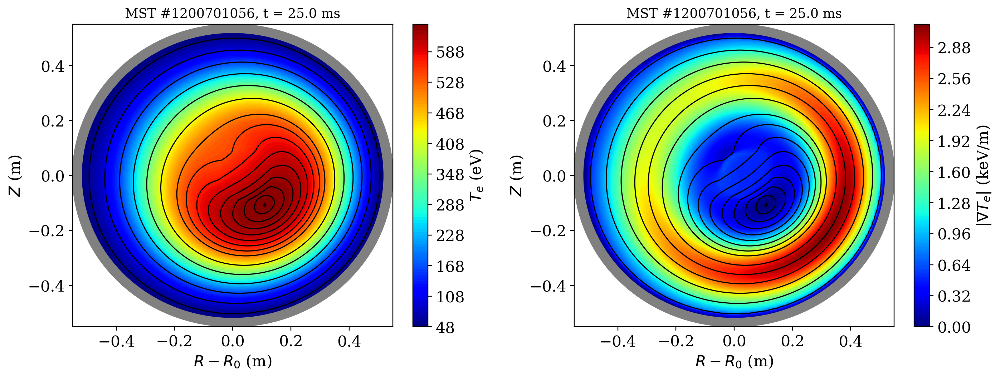

In [1145]:
fig, axs = plt.subplots(1, 2, figsize=(13,5))
levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99]

# Plot the temperature
cax = axs[0].contourf(xs, ys, Te_xy.T, 100, cmap=cm.jet)
fig.colorbar(cax, ax=axs[0], label=r'$T_e$ (eV)')

# Plot the gradient
cax = axs[1].contourf(xs, ys, grad_xy.T/1e3, 200, cmap=cm.jet)
fig.colorbar(cax, ax=axs[1], label=r'$|\nabla T_e|$ (keV/m)')

for ax in axs:
    overplot_shell(ax)
    ax.contour(xs, ys, rhos.T, levels, colors='black', linewidths=1)     
    ax.set_xlabel(r'$R - R_0$ (m)')
    ax.set_ylabel(r'$Z$ (m)')
    ax.set_xlim([-0.55, 0.55])
    ax.set_ylim([-0.55, 0.55])
    ax.set_title('MST #{0:10d}, t = {1:.1f} ms'.format(shot, t))
    
plt.tight_layout()

In [1172]:
t = 29.0
tn = np.argmin(np.abs(ts - t))

xs = np.linspace(-0.52, 0.52, num=100)
ys = np.linspace(-0.52, 0.52, num=100)
xx, yy = np.meshgrid(xs, ys, indexing='ij')
rhos = np.reshape(rho_xy(xx.ravel(), yy.ravel(), t, label='SXT'), xx.shape)
Te_xy = temp_prof(rhos, *popt_temp[tn,:3])

# Compute the gradients
grad_x, grad_y = np.gradient(Te_xy, xs, ys)
grad_xy = np.sqrt(grad_x**2 + grad_y**2)

# Mask the artifact
#grad_xy[grad_xy > 1.9e3] = 1e3

# Mask locations outside of the torus
grad_xy[xx**2 + yy**2 > 0.53**2] = np.nan
Te_xy[xx**2 + yy**2 > 0.53**2] = np.nan

grad_xy_t2 = np.copy(grad_xy)

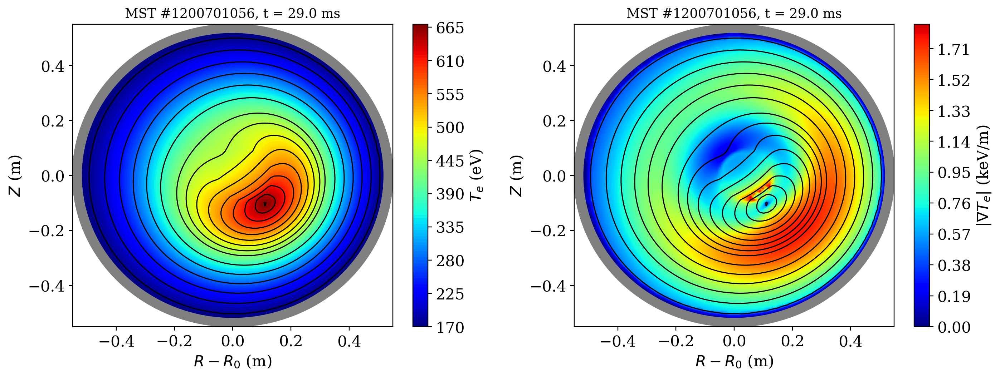

In [1160]:
fig, axs = plt.subplots(1, 2, figsize=(13,5))
levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99]

# Plot the temperature
cax = axs[0].contourf(xs, ys, Te_xy.T, 100, cmap=cm.jet)
fig.colorbar(cax, ax=axs[0], label=r'$T_e$ (eV)')

# Plot the gradient
cax = axs[1].contourf(xs, ys, grad_xy.T/1e3, 200, cmap=cm.jet, vmax=2.0)
fig.colorbar(cax, ax=axs[1], label=r'$|\nabla T_e|$ (keV/m)')

for ax in axs:
    overplot_shell(ax)
    ax.contour(xs, ys, rhos.T, levels, colors='black', linewidths=1)     
    ax.set_xlabel(r'$R - R_0$ (m)')
    ax.set_ylabel(r'$Z$ (m)')
    ax.set_xlim([-0.55, 0.55])
    ax.set_ylim([-0.55, 0.55])
    ax.set_title('MST #{0:10d}, t = {1:.1f} ms'.format(shot, t))
    
plt.tight_layout()

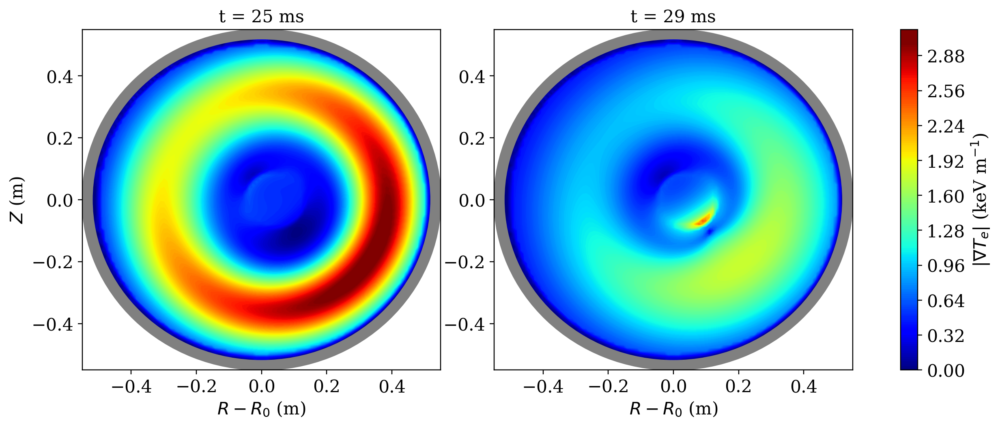

In [1180]:
fig, axs = plt.subplots(1, 2, figsize=(12,5))

# Quiet
cax1 = axs[0].contourf(xs, ys, grad_xy_t1.T/1e3, 200, cmap=cm.jet, vmin=0, vmax=3.0)
#fig.colorbar(cax, ax=axs[0], label=r'$|\nabla T_e|$ (keV/m)')

# Dynamic
cax2 = axs[1].contourf(xs, ys, grad_xy_t2.T/1e3, 200, cmap=cm.jet, vmin=0, vmax=3.0)
#fig.colorbar(cax, ax=axs[1], label=r'$|\nabla T_e|$ (keV/m)')

for ax in axs:
    ax.set_xlabel('$R - R_0$ (m)')
    overplot_shell(ax)
    ax.set_xlim([-0.55, 0.55])
    ax.set_ylim([-0.55, 0.55])

axs[0].set_ylabel('$Z$ (m)')
axs[0].set_title('t = 25 ms', fontsize=14)
axs[1].set_title('t = 29 ms', fontsize=14)

plt.tight_layout()
plt.colorbar(cax1, ax=axs, orientation='vertical', label=r'$|\nabla T_e|$ (keV m$^{-1}$)');

## What is the diamagnetic drift velocity?

From Fitzpatrick's textbook we get the equation:

$$
    \vec{v}_{*,e} = -\frac{\nabla p \times \vec{B}}{e n_e B^2}
$$

I believe I can answer this exactly using the SHEq output. Following my conversation with Karsten I will scale the poloidal field by a factor of $\pi$ to make it more realistic: $B_\theta / \pi$. I will just use Cartesian coordinates to compute the gradients on a grid.

For now I will just do an estimate though, assuming $|\nabla p \times \vec{B}| \approx \frac{\partial p}{\partial r}B$.

In [580]:
np.argmax(grad_T[8,:])

15

In [573]:
grad_T.shape

(41, 100)

In [597]:
tn = 8
ells = np.linspace(-0.45, 0.45, num=100)
xl, yl = los.get_xy(ells)
rhos = rho_xy(xl, yl, 24)

ne_ls = ne_prof(rhos, *popt_dens[tn,:], gamma=gamma)
Te_ls = temp_prof(rhos, *popt_temp[tn,:3])
press_ls = ne_ls * Te_ls * eVe19_to_J
grad_p = np.gradient(press_ls, ells)

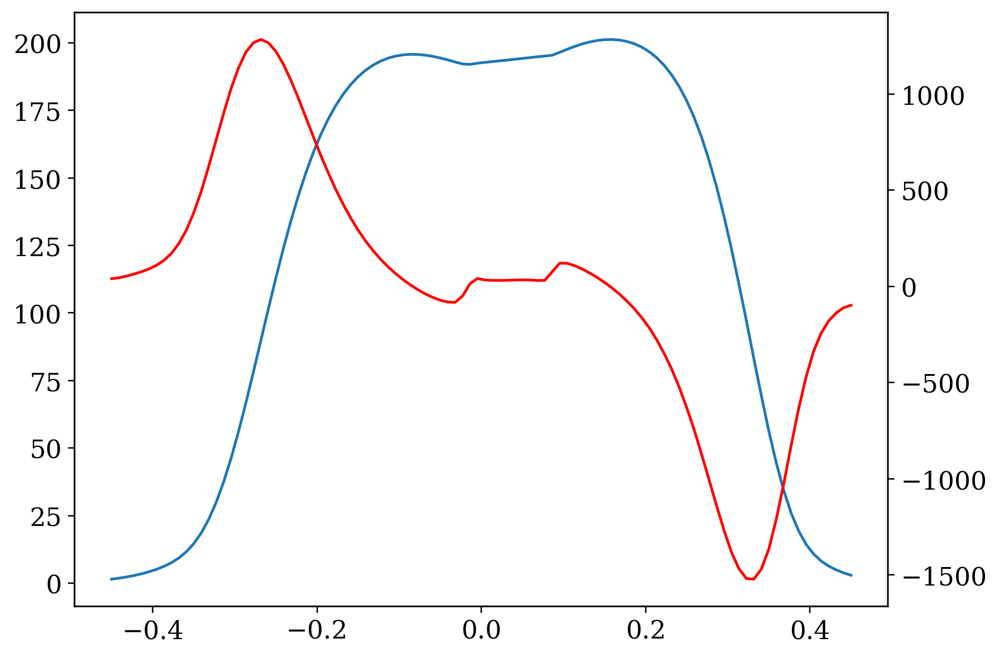

In [600]:
plt.plot(ells, press_ls)

ax2 = plt.twinx()
ax2.plot(ells, grad_p, color='red')

In [618]:
index = np.argmax(np.abs(grad_p))
dp_dr = np.amax(np.abs(grad_p))
dp_dr

1521.870426133904

In [610]:
rhos[index]

0.5329995582929544

In [612]:
sheq_index = np.argmin(np.abs(avgs[12].rhoh - rhos[index]))

In [614]:
Bt = avgs[12].B_tor[sheq_index]
Bp = avgs[12].B_pol[sheq_index] / np.pi
B = np.sqrt(Bt**2 + Bp**2)
B

0.1973643030829393

In [616]:
ne_ls[index]

0.3883619366895036

In [622]:
qe = 1.602e19
v_diamag = dp_dr / (qe * ne_ls[index]*1e-19 * B)
v_diamag / 1e3

12.393954639486708

Let's look at $\nabla p$ a little more robustly.

In [653]:
press_MLE = dens_MLE * temp_MLE * 1.602

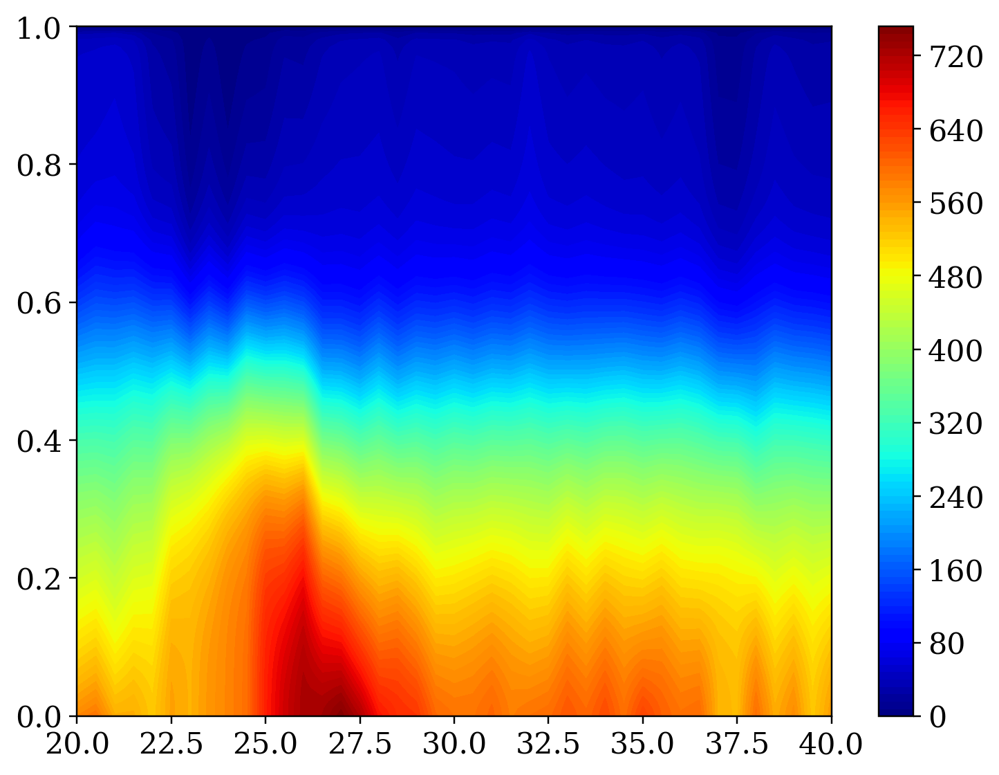

In [655]:
cax = plt.contourf(ts, ps, press_MLE.T, 100, cmap=cm.jet)
plt.colorbar(cax);

In [1012]:
# Evaluate the gradient over time
prof_p = np.zeros([len(ts), len(ells)])
grad_p = np.zeros([len(ts), len(ells)])
grad_p_max = np.zeros(len(ts))
grad_p_x0 = np.zeros(len(ts))

for t in tqdm(ts):
    # Avoid issue with rounding on last frame
    t = 40. if t > 40. else t
    tn = np.argmin(np.abs(ts - t))
    delta = get_delta(t)

    # Load the rhos
    xs, ys = sunflower_points(5000)
    rs = rho_xy(xs, ys, t, label='FIR_P')

    # Find the o-point
    n_op = np.argmin(rs)
    x_op = xs[n_op]
    y_op = ys[n_op]

    # Get the line of sight
    impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op) + np.pi
    impact_p = delta * np.cos(impact_phi)
    los = line_of_sight(impact_p, impact_phi)
    xl, yl = los.get_xy(ells)
    rhos = rho_xy(xl, yl, t)
    p_ls = np.interp(rhos, ps, press_MLE[tn,:])
    
    # Get the gradient
    prof_p[tn,:] =  p_ls
    grad_p[tn,:] = np.gradient(p_ls, ells)
    grad_p_max[tn] = np.amax(np.abs(grad_p[tn,:]))
    grad_p_x0[tn] = ells[np.argmax(np.abs(grad_p[tn,:]))]

100%|██████████| 41/41 [01:02<00:00,  1.52s/it]


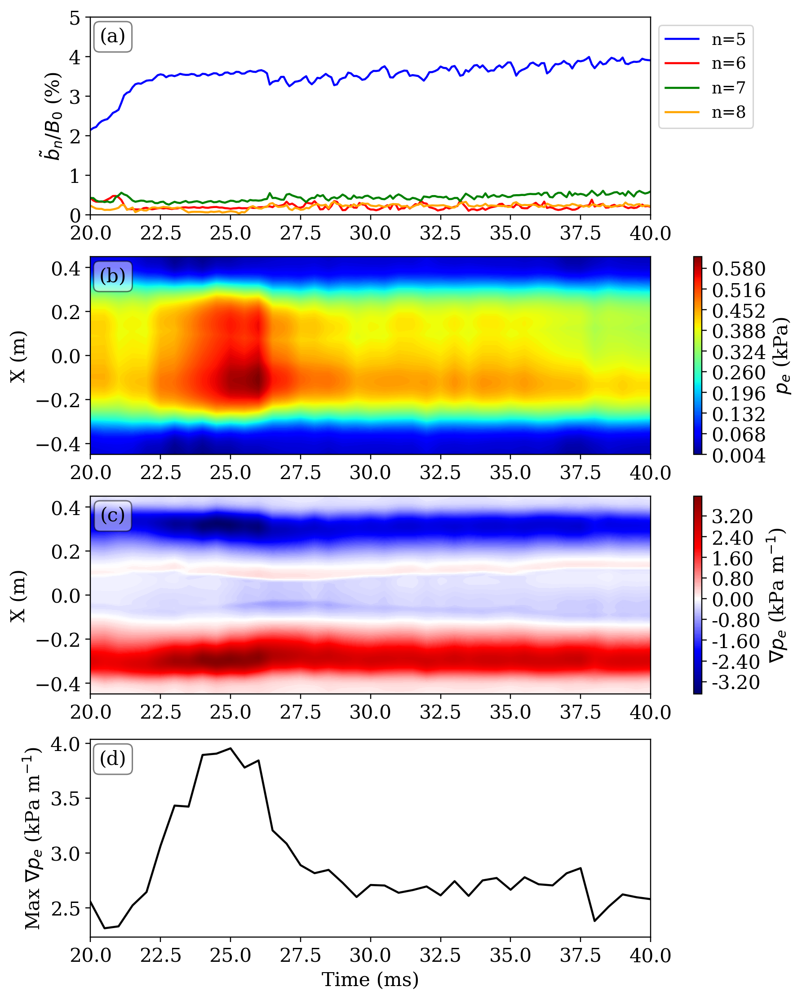

In [1013]:
fig, axs = plt.subplots(4, 1, constrained_layout=True, figsize=(8,10))
props = dict(boxstyle='round', facecolor='white', alpha=0.5)

# Magnetics signals    
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7,8], ['blue','red','green','orange']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left', bbox_to_anchor=(1.00, 1.0))
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (%)')
axs[0].set_ylim([0,5])

# Pressure
cax = axs[1].contourf(ts, ells, prof_p.T/1e3, 200, cmap=cm.jet, vmin=0)
fig.colorbar(cax, ax=axs[1], label=r'$p_e$ (kPa)')
axs[1].set_ylabel(r'X (m)')

# Gradient
cax = axs[2].contourf(ts, ells, grad_p.T/1e3, 200, cmap=cm.seismic, vmin=-4.0, vmax=4.0)
cb = fig.colorbar(cax, ax=axs[2], label=r'$\nabla p_e$ (kPa m$^{-1}$)')
cb.ax.set_yticklabels(["{:.2f}".format(i) for i in cb.get_ticks()])
axs[2].set_ylabel(r'X (m)')

# Max gradient
axs[3].plot(ts, grad_p_max/1e3, color='black')
axs[3].set_ylabel(r'Max $\nabla p_e$ (kPa m$^{-1}$)')

for ax,alpha in zip(axs,['a','b','c','d']):
    text(0.04, 0.9, r'({0:})'.format(alpha), ax, fontsize=14, color='black', bbox=props)
    ax.set_xlim([ts[0], ts[-1]])
    
axs[-1].set_xlabel('Time (ms)');

In [650]:
Bt = avgs[12].B_tor
Bp = avgs[12].B_pol / np.pi
B_tot = np.sqrt(Bt**2 + Bp**2)

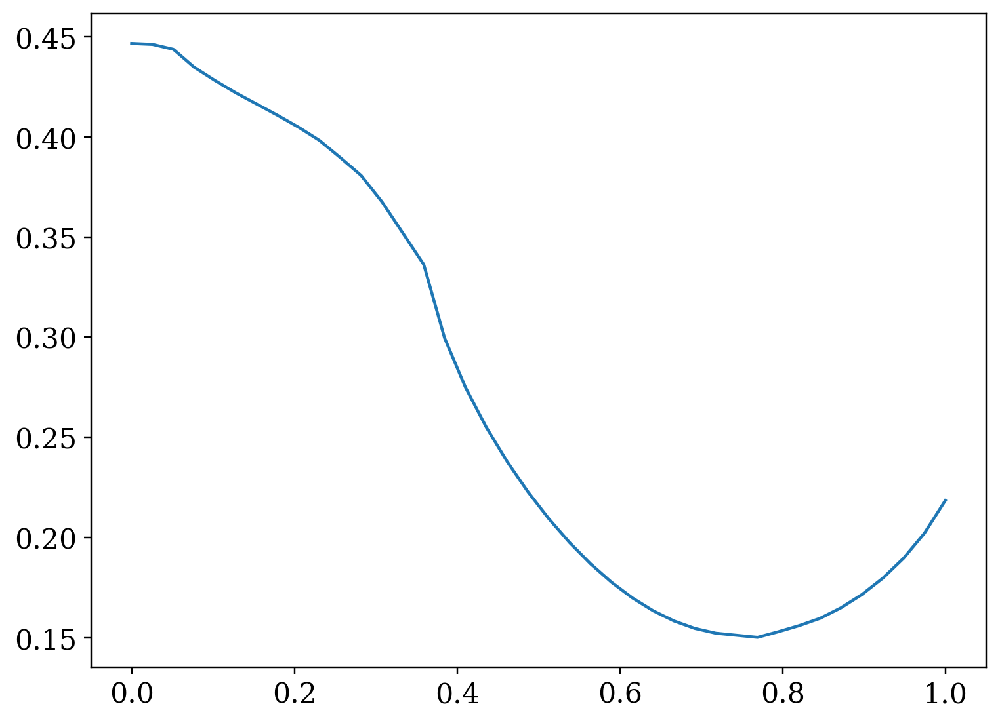

In [652]:
plt.plot(avgs[12].rhoh, B_tot)

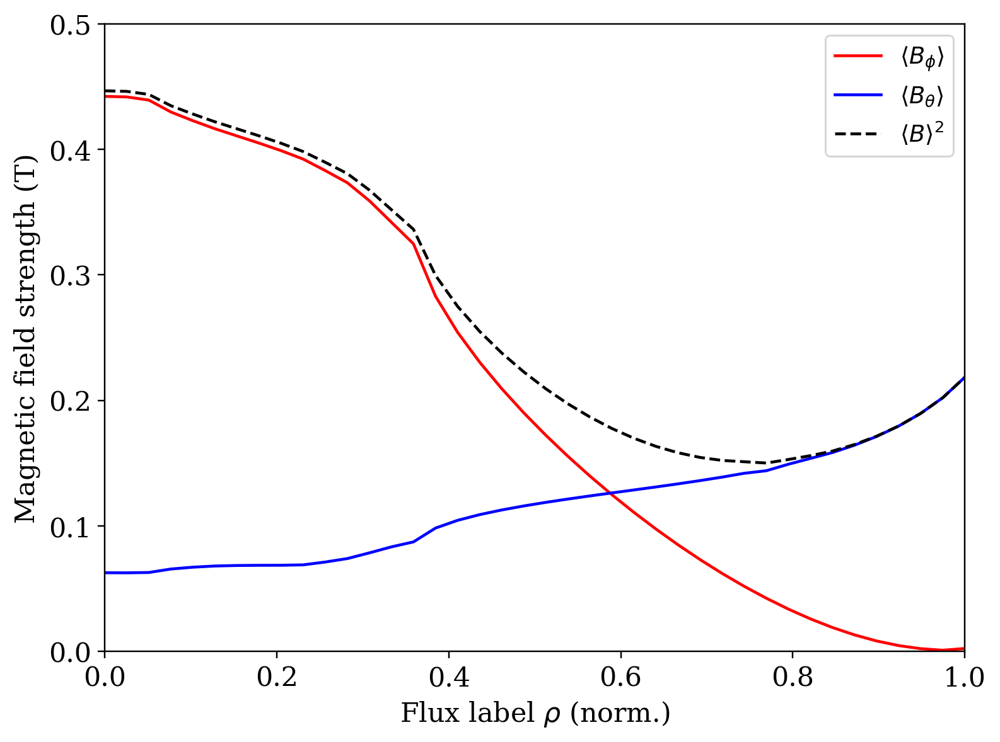

In [668]:
plt.plot(avgs[12].rhoh, -avgs[12].B_tor, label=r'$\langle B_\phi \rangle$', color='red')
plt.plot(avgs[12].rhoh, avgs[12].B_pol/np.pi, label=r'$\langle B_\theta \rangle$', color='blue')

b_tot = np.sqrt(avgs[12].B_tor**2 + (avgs[12].B_pol/np.pi)**2)
plt.plot(avgs[12].rhoh, b_tot, color='black', linestyle='dashed', label=r'$\langle B \rangle^2$')

plt.legend()
plt.xlim([0,1])
plt.ylim([0,0.5])
plt.xlabel(r'Flux label $\rho$ (norm.)')
plt.ylabel('Magnetic field strength (T)');

In [679]:
ls = np.linspace(-0.51, 0.51, num=100)
xl, yl = los.get_xy(ls)
rhos = rho_xy(xl, yl, times[12])

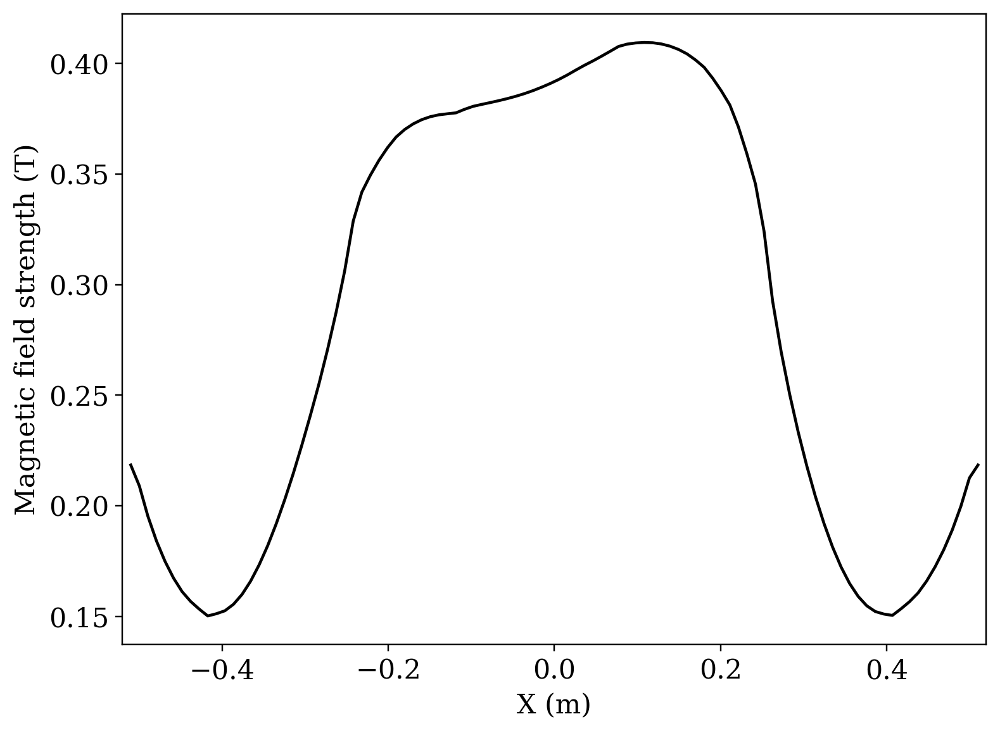

In [682]:
bt = np.interp(rhos, avgs[12].rhoh, avgs[12].B_tor)
bp = np.interp(rhos, avgs[12].rhoh, avgs[12].B_pol/np.pi)
b_tot = np.sqrt(bt**2 + bp**2)

plt.plot(ls, b_tot, color='black')
plt.xlim([-0.52, 0.52])
plt.xlabel('X (m)')
plt.ylabel('Magnetic field strength (T)');

In [686]:
dp_dr = 4000.0
qe = 1.602e-19
B = 0.35
ne = 0.3e19

v_dia = dp_dr / (qe*ne*B) / 1000
print('v_dia = {0:.2f} km/s'.format(v_dia))

v_dia = 23.78 km/s


In [687]:
dp_dr = 3000.0
qe = 1.602e-19
B = 0.35
ne = 0.3e19

v_dia = dp_dr / (qe*ne*B) / 1000
print('v_dia = {0:.2f} km/s'.format(v_dia))

v_dia = 17.83 km/s


In [689]:
0.05*125

6.25

## Anticipated ME-SXR signals for this shot

In [701]:
p_sample

array([6.37202892e+02, 2.58037736e+00, 7.03032442e-01, 1.67086447e-03,
       2.34536772e+00, 5.16895102e-01])

## Make nice sythetic diagnostic outputs for this data

In [713]:
filters = filter_list('all')
sxt_ps = np.concatenate([sxt_model.p[f] for f in filters])

In [704]:
tn = np.argmin(np.abs(ts - 25.0))
n_samples = 100

y_samples = np.zeros([n_samples, len(y_data)])
for index in tqdm(range(n_samples)):
    p_sample = sp.stats.multivariate_normal.rvs(mean=popt_temp[tn,:], cov=pcov_temp[tn,:,:])
    y_samples[index,:] = get_model(Rhos, Dx, p_sample, ne_params=popt_dens[tn,:])
    
y_avg = np.average(y_samples, axis=0)
y_std = np.std(y_samples, axis=0)

100%|██████████| 100/100 [00:31<00:00,  3.22it/s]


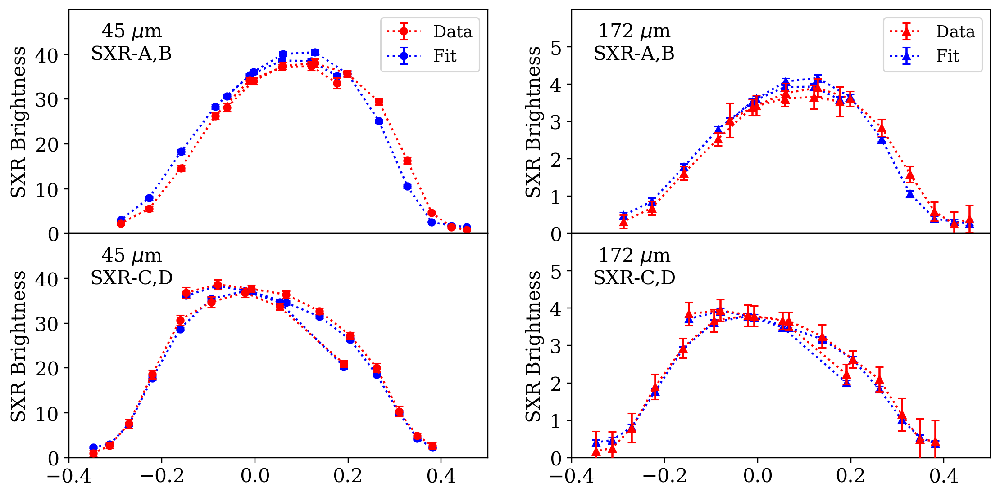

In [749]:
# Use labels to plot more physically
fig, axs = plt.subplots(2, 2, figsize=(12,6))

# SXR-A,B thin
ii, = np.where(labels == 'A thin')
axs[0,0].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='o', color='red', capsize=3, ms=5, linestyle=':', label='Data', zorder=100)
axs[0,0].errorbar(sxt_ps[ii], y_avg[ii], yerr=y_std[ii], color='blue', linestyle=':', marker='o', capsize=3, ms=5, label='Fit')

ii, = np.where(labels == 'B thin')
axs[0,0].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='o', color='red', capsize=3, ms=5, linestyle=':', zorder=100)
axs[0,0].errorbar(sxt_ps[ii], y_avg[ii], yerr=y_std[ii], color='blue', linestyle=':', marker='o', capsize=3, ms=5)

# SXR-C,D thin
ii, = np.where(labels == 'C thin')
axs[1,0].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='o', color='red', capsize=3, ms=5, linestyle=':', zorder=100)
axs[1,0].errorbar(sxt_ps[ii], y_avg[ii], yerr=y_std[ii], color='blue', linestyle=':', marker='o', capsize=3, ms=5)

ii, = np.where(labels == 'D thin')
axs[1,0].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='o', color='red', capsize=3, ms=5, linestyle=':', zorder=100)
axs[1,0].errorbar(sxt_ps[ii], y_avg[ii], yerr=y_std[ii], color='blue', linestyle=':', marker='o', capsize=3, ms=5)

# SXR-A,B thick
ii, = np.where(labels == 'A thick')
axs[0,1].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='^', color='red', capsize=3, ms=5, linestyle=':', label='Data', zorder=100)
axs[0,1].errorbar(sxt_ps[ii], y_avg[ii], yerr=y_std[ii], color='blue', linestyle=':', marker='^', capsize=3, ms=5, label='Fit')

ii, = np.where(labels == 'B thick')
axs[0,1].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='^', color='red', capsize=3, ms=5, linestyle=':', zorder=100)
axs[0,1].errorbar(sxt_ps[ii], y_avg[ii], yerr=y_std[ii], color='blue', linestyle=':', marker='^', capsize=3, ms=5)

# SXR-C,D thick
ii, = np.where(labels == 'C thick')
axs[1,1].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='^', color='red', capsize=3, ms=5, linestyle=':', zorder=100)
axs[1,1].errorbar(sxt_ps[ii], y_avg[ii], yerr=y_std[ii], color='blue', linestyle=':', marker='^', capsize=3, ms=5)

ii, = np.where(labels == 'D thick')
axs[1,1].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='^', color='red', capsize=3, ms=5, linestyle=':', zorder=100)
axs[1,1].errorbar(sxt_ps[ii], y_avg[ii], yerr=y_std[ii], color='blue', linestyle=':', marker='^', capsize=3, ms=5)

# Add labels
text(0.15, 0.9, r'45 $\mu$m', axs[0,0], fontsize=14)
text(0.15, 0.8, 'SXR-A,B', axs[0,0], fontsize=14)
text(0.15, 0.9, r'45 $\mu$m', axs[1,0], fontsize=14)
text(0.15, 0.8, 'SXR-C,D', axs[1,0], fontsize=14)

text(0.15, 0.9, r'172 $\mu$m', axs[0,1], fontsize=14)
text(0.15, 0.8, 'SXR-A,B', axs[0,1], fontsize=14)
text(0.15, 0.9, r'172 $\mu$m', axs[1,1], fontsize=14)
text(0.15, 0.8, 'SXR-C,D', axs[1,1], fontsize=14)

# Format the axes
axs[0,0].legend()
axs[0,1].legend()
axs[0,0].xaxis.set_ticklabels([])
axs[0,1].xaxis.set_ticklabels([])

for ax in axs[:,0]:
    ax.set_xlim([-0.4, 0.5])
    ax.set_ylim([0,50])
    ax.set_ylabel('SXR Brightness')
    ax.yaxis.set_major_locator(MaxNLocator(nbins=6, prune='upper'))
    
for ax in axs[:,1]:
    ax.set_xlim([-0.4, 0.5])
    ax.set_ylim([0,6])
    ax.set_ylabel('SXR Brightness')
    ax.yaxis.set_major_locator(MaxNLocator(nbins=6, prune='upper'))

#axs[-1].set_xlabel('Chord radius (m)')
plt.subplots_adjust(wspace=0.2, hspace=0);

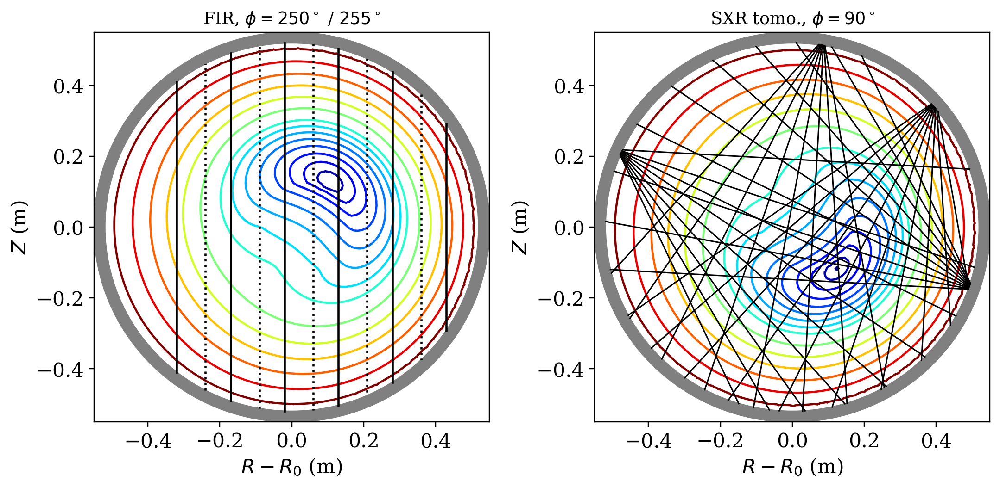

In [764]:
fig, axs = plt.subplots(1, 2, figsize=(10,5))
levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99]
xs, ys = sunflower_points(5000)

# -------------------------------- FIR -------------------------------
rs = rho_xy(xs, ys, t, label='FIR_P')
cax2 = axs[0].tricontour(xs, ys, rs, levels=levels, cmap=cm.jet)

# Plot the chords
dist = np.zeros(len(fir_det.chords))
for index, chord in enumerate(fir_det.chords):
    a = chord.los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=100)
    xl, yl = chord.los.get_xy(ells)
    
    if fir_det.pluses[index]:
        linestyle='-'
    else:
        linestyle=':'
    axs[0].plot(xl, yl, color='black', linestyle=linestyle)
    dist[index] = 2*a

# -------------------------------- SXT -------------------------------
rhos = rho_xy(xs, ys, t, label='SXT')
cax2 = axs[1].tricontour(xs, ys, rhos, levels=levels, cmap=cm.jet)

# Plot the chords
for index, los in enumerate(sxt_los):
    a = los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=100)
    xl, yl = los.get_xy(ells)
    axs[1].plot(xl, yl, color='black', linestyle='-', linewidth=1)

for ax in axs:
    ax.set_xlabel('$R - R_0$ (m)')
    ax.set_ylabel('$Z$ (m)')
    overplot_shell(ax)
    ax.set_xlim([-0.55, 0.55])
    ax.set_ylim([-0.55, 0.55])

axs[0].set_title(r'FIR, $\phi = 250^\circ$ / $255^\circ$')
axs[1].set_title(r'SXR tomo., $\phi = 90^\circ$')
plt.tight_layout();

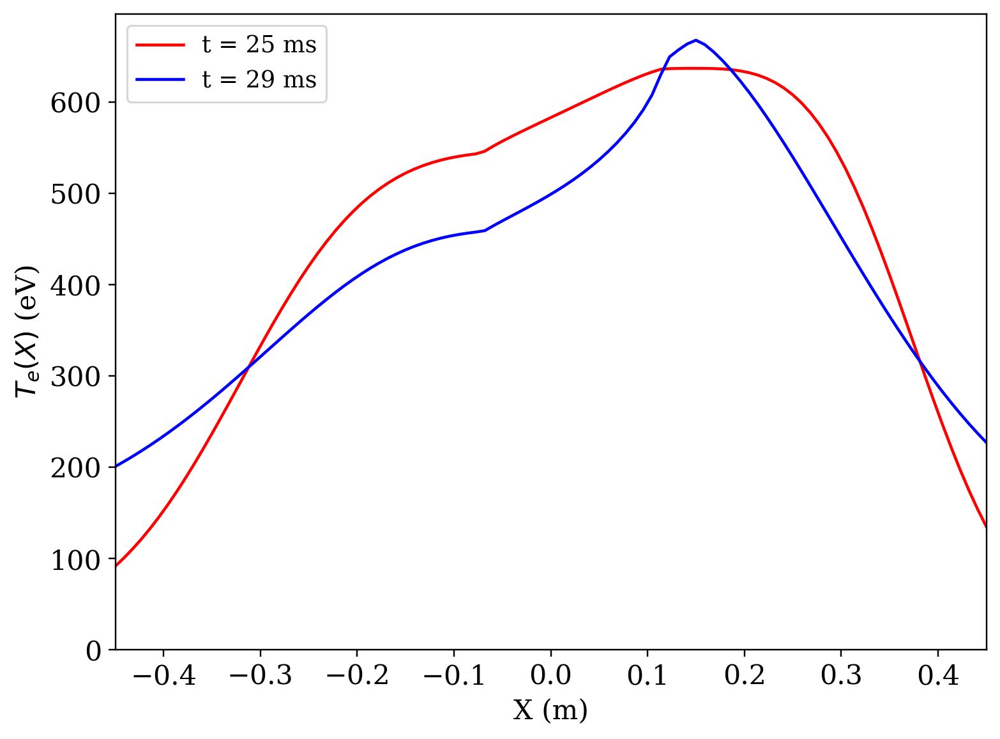

In [943]:
tn1 = np.argmin(np.abs(ts - 25.0))
tn2 = np.argmin(np.abs(ts - 29.0))

plt.plot(ells, prof_T[tn1,:], color='red', label=r't = 25 ms')
plt.plot(ells, prof_T[tn2,:], color='blue', label=r't = 29 ms')

plt.legend(loc='upper left')
plt.xlabel('X (m)')
plt.ylabel(r'$T_e (X)$ (eV)')
plt.xlim([-0.45, 0.45])
plt.ylim([0,None]);

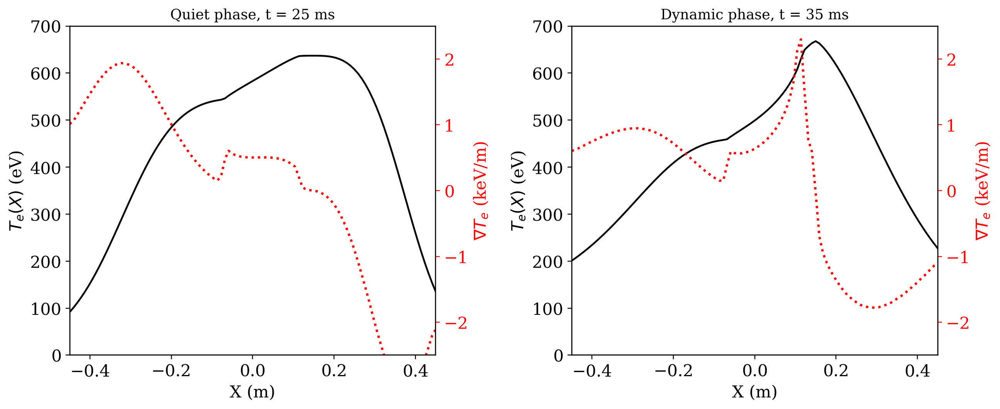

In [926]:
fig, axs = plt.subplots(1, 2, figsize=(12,5))
axs2 = [ax.twinx() for ax in axs]

# Quiet phase
tn1 = np.argmin(np.abs(ts - 25.0))
axs[0].plot(ells, prof_T[tn1,:], color='black', label=r't = 25 ms')
axs2[0].plot(ells, grad_T[tn1,:]/1e3, color='red', linestyle=':', linewidth=2)

# Dynamic Phase
tn2 = np.argmin(np.abs(ts - 29.0))
axs[1].plot(ells, prof_T[tn2,:], color='black', label=r't = 35 ms')
axs2[1].plot(ells, grad_T[tn2,:]/1e3, color='red', linestyle=':', linewidth=2)

for ax in axs:
    ax.set_xlabel('X (m)')
    ax.set_ylabel(r'$T_e (X)$ (eV)')
    ax.set_xlim([-0.45, 0.45])
    ax.set_ylim([0,700])
    
for ax in axs2:
    ax.set_ylabel(r'$\nabla T_e$ (keV/m)')
    ax.set_ylim([-2.5,2.5])
    color_axis(ax, color='red')
    
axs[0].set_title('Quiet phase, t = 25 ms')
axs[1].set_title('Dynamic phase, t = 35 ms')
plt.tight_layout();

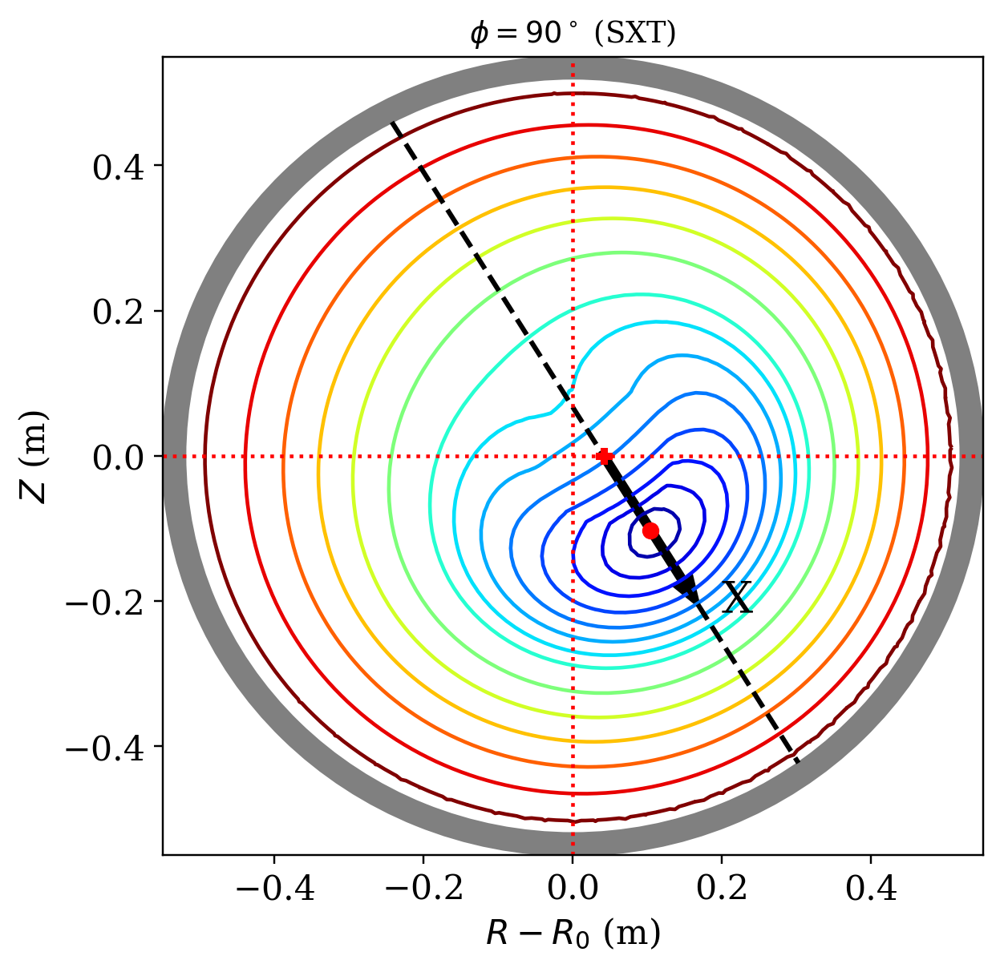

In [903]:
from mst_ida.models.base.geometry import line_of_sight

fig = plt.figure(figsize=(6,6))

# Plot flux contours
t = 25.0
levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99]
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, 25.0, label='SXT')
cax2 = plt.tricontour(xs, ys, rs, levels=levels, cmap=cm.jet)

# Find the o-point
n_op = np.argmin(rs)
x_op = xs[n_op]
y_op = ys[n_op]
plt.plot([x_op], [y_op], 'or', zorder=100)

# Get the LoS parameters
delta = get_delta(25.0)
plt.plot([delta], [0], 'Pr', zorder=100)
impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op) + np.pi
impact_p = delta * np.cos(impact_phi)

# Plot the LoS
los = line_of_sight(impact_p, impact_phi)
ell_max = los.intercept_with_circle(0.52)
ells = np.linspace(-ell_max, ell_max, num=100)
xl, yl = los.get_xy(ells)
plt.plot(xl, yl, '--k', linewidth=2)

# Indicate direction with an arrow
theta = impact_phi - np.pi/2
plt.arrow(delta, 0, 0.2*np.cos(theta), 0.2*np.sin(theta), width=0.01, color='black')
text(0.7, 0.32, 'X', plt.gca(), fontsize=18)

# Make it look nice
plt.axvline(x=0, color='red', linestyle=':')
plt.axhline(y=0, color='red', linestyle=':')
overplot_shell(plt.gca())
plt.xlabel('$R - R_0$ (m)')
plt.ylabel('$Z$ (m)')
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55])
plt.title(r'$\phi = 90^\circ$ (SXT)');

## Prior range for $T_e(\rho)$ and $n_e(\rho)$

In [788]:
from mst_ida.analysis.ida import profile_confidence

n_samples = 200
rs = np.linspace(0, 1, num=100)
Te_samples = np.zeros([n_samples, len(rs)])
ne_samples = np.zeros([n_samples, len(rs)])
nAl_samples = np.zeros([n_samples, len(rs)])

for index in range(n_samples):
    Te0 = np.random.uniform(low=0.0, high=1000.0)
    beta_T = np.random.uniform(low=0.1, high=5.0)
    dr = np.random.uniform(low=0.2, high=1.0)
    Te_samples[index,:] = temp_prof(rs, Te0, beta_T, dr)
    
    n0 = np.random.uniform(low=0.2, high=1.0)
    n1 = np.random.uniform(low=0.0, high=0.02)
    alpha_n = np.random.uniform(low=1.0, high=14.0)
    beta_n = np.random.uniform(low=1.0, high=14.0)
    ne_samples[index,:] = ne_prof(rs, n0, n1, alpha_n, beta_n, gamma=100.)
    
    nAl0 = np.random.uniform(low=1e-4, high=1e-2)
    nAl_samples[index,:] = get_nZ_profs(rs, nAl0, mu_C, alpha_Z, beta_Z)['Al']
    
Te_CIs = profile_confidence(Te_samples)
ne_CIs = profile_confidence(ne_samples)
nAl_CIs = profile_confidence(nAl_samples)

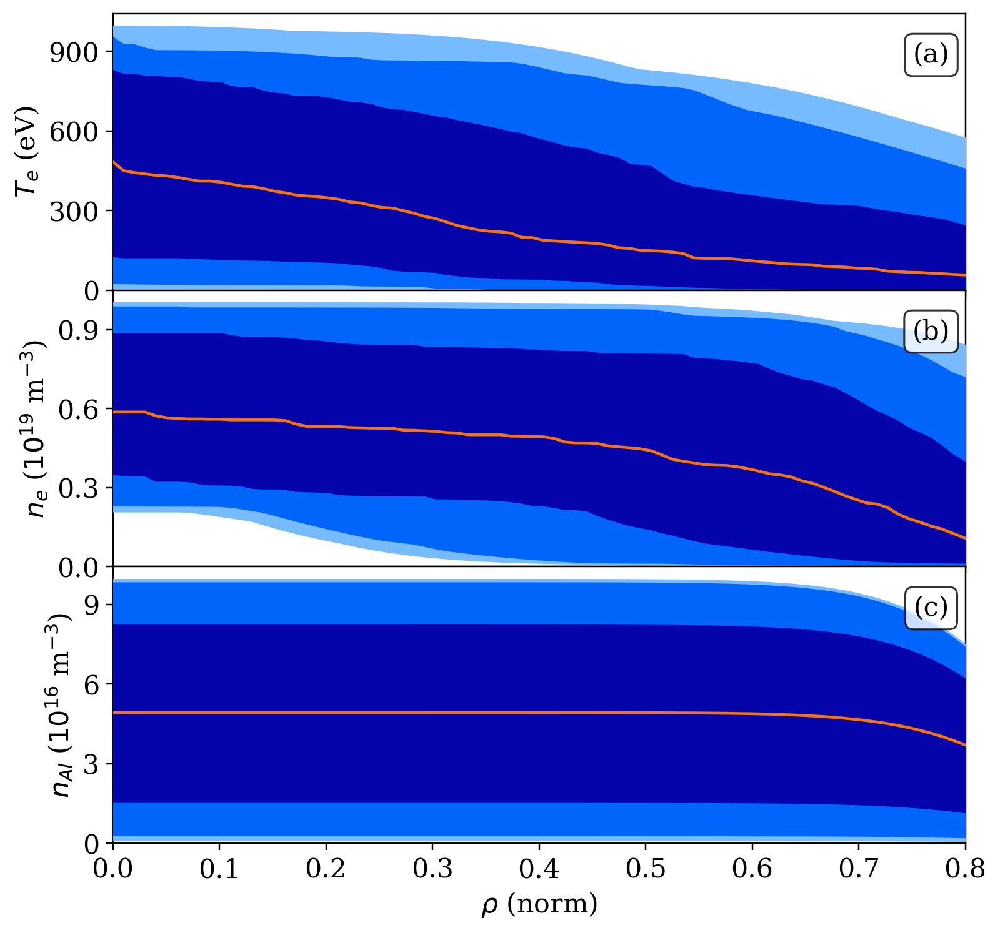

In [795]:
fig, axs = plt.subplots(3, 1, figsize=(8,8))

# Temperature
axs[0].plot(rs, Te_CIs['median'], color='xkcd:orange', zorder=100)
axs[0].fill_between(rs, Te_CIs['1 sigma']['low'], Te_CIs['1 sigma']['high'], color='xkcd:royal blue', zorder=90)
axs[0].fill_between(rs, Te_CIs['2 sigma']['low'], Te_CIs['2 sigma']['high'], color='xkcd:bright blue', zorder=80)
axs[0].fill_between(rs, Te_CIs['3 sigma']['low'], Te_CIs['3 sigma']['high'], color='xkcd:sky blue', zorder=70)
axs[0].set_ylabel(r'$T_e$ (eV)')
axs[0].set_ylim([0,None])

# Density
axs[1].plot(rs, ne_CIs['median'], color='xkcd:orange', zorder=100)
axs[1].fill_between(rs, ne_CIs['1 sigma']['low'], ne_CIs['1 sigma']['high'], color='xkcd:royal blue', zorder=90)
axs[1].fill_between(rs, ne_CIs['2 sigma']['low'], ne_CIs['2 sigma']['high'], color='xkcd:bright blue', zorder=80)
axs[1].fill_between(rs, ne_CIs['3 sigma']['low'], ne_CIs['3 sigma']['high'], color='xkcd:sky blue', zorder=70)
axs[1].set_ylabel(r'$n_e$ ($10^{19}$ m$^{-3}$)')
axs[1].set_ylim([0,None])

# Aluminum
axs[2].plot(rs, nAl_CIs['median']/1e-3, color='xkcd:orange', zorder=100)
axs[2].fill_between(rs, nAl_CIs['1 sigma']['low']/1e-3, nAl_CIs['1 sigma']['high']/1e-3, color='xkcd:royal blue', zorder=90)
axs[2].fill_between(rs, nAl_CIs['2 sigma']['low']/1e-3, nAl_CIs['2 sigma']['high']/1e-3, color='xkcd:bright blue', zorder=80)
axs[2].fill_between(rs, nAl_CIs['3 sigma']['low']/1e-3, nAl_CIs['3 sigma']['high']/1e-3, color='xkcd:sky blue', zorder=70)
axs[2].set_ylabel(r'$n_{Al}$ ($10^{16}$ m$^{-3}$)')
axs[2].set_ylim([0,None])

# Make it look good
for ax in axs:
    ax.set_xlim([0,0.8])
    ax.yaxis.set_major_locator(MaxNLocator(nbins=4, prune='upper'))

for ax in axs[:-1]:
    ax.xaxis.set_ticklabels([])

for ax,alpha in zip(axs,['a','b','c']):
    text(0.96, 0.85, r'({0:})'.format(alpha), ax, fontsize=14, color='black', bbox=props, zorder=100)

axs[-1].set_xlabel(r'$\rho$ (norm)')
plt.subplots_adjust(wspace=0, hspace=0)

## $Z_\text{eff}$ estimate

In [828]:
exclude

[20, 59, 60, 22, 62, 19]

## Reconstructed emissivity vs Cormack

In [840]:
tomo = invert_brightness(shot, t_start=20.0, t_end=40.0, delta=0.5, smooth=10, svd_tol=0.1, exclude=exclude, thin=True)

% SXR_MST_BOX_GET_SIGNALS: beginning for shot #1200701056
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals in W/m2
% SXR_MST_BOX_GET_SIGNALS: opening MST for shot 1200701056
% Compiled module: WHOAMI.
% Compiled module: FILEBREAK.
% Compiled module: CALC_GEOM_2.
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO time base, Wed Sep  2 14:10:51 2020
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals
% SXR_MST_BOX_GET_SIGNALS: assembling bright structure and transposing matrix
% SXR_MST_BOX_GET_SIGNALS: SXRTOMO done
Time=1.7477269 s
% Compiled module: WORDARRAY.
SHOT #1200701056 t=1.8973131 s


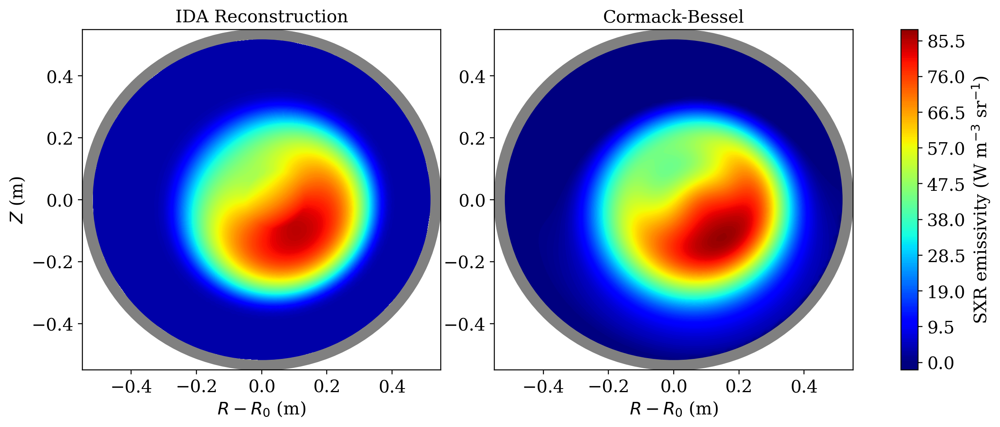

In [893]:
fig, axs = plt.subplots(1, 2, figsize=(12,5))
t_ms = 25.5
xs, ys = sunflower_points(5000)

# Reconstruction
tn = np.argmin(np.abs(ts - t_ms))
rhos = rho_xy(xs, ys, ts[tn])
emiss = get_emiss(rhos, popt_temp[tn,:], ne_params=popt_dens[tn,:])
cax = axs[0].tricontourf(xs, ys, emiss['thin'].T, 200, cmap=cm.jet, vmin=0, vmax=90)

# Tomogrpahy
tn0 = np.argmin(np.abs(tomo.time - t_ms))
vals = np.copy(tomo.emiss[:,:,tn0])
xt = tomo.xs - tomo.major
yt = tomo.ys

for i,x in enumerate(xt):
    for j,y in enumerate(yt):
        if (x**2 + y**2 > 0.53**2):
            vals[i,j] = np.nan
cax = axs[1].contourf(xt, yt, vals.T, 200, cmap=cm.jet, vmin=0, vmax=90);

for ax in axs:
    ax.set_xlabel('$R - R_0$ (m)')
    overplot_shell(ax)
    ax.set_xlim([-0.55, 0.55])
    ax.set_ylim([-0.55, 0.55])

axs[0].set_ylabel('$Z$ (m)')
axs[0].set_title('IDA Reconstruction', fontsize=14)
axs[1].set_title('Cormack-Bessel', fontsize=14)

plt.tight_layout()
plt.colorbar(cax, ax=axs, orientation='vertical', label=r'SXR emissivity (W m$^{-3}$ sr$^{-1}$)');

## Cmopare the temperature structure during the quiet and dynamic periods

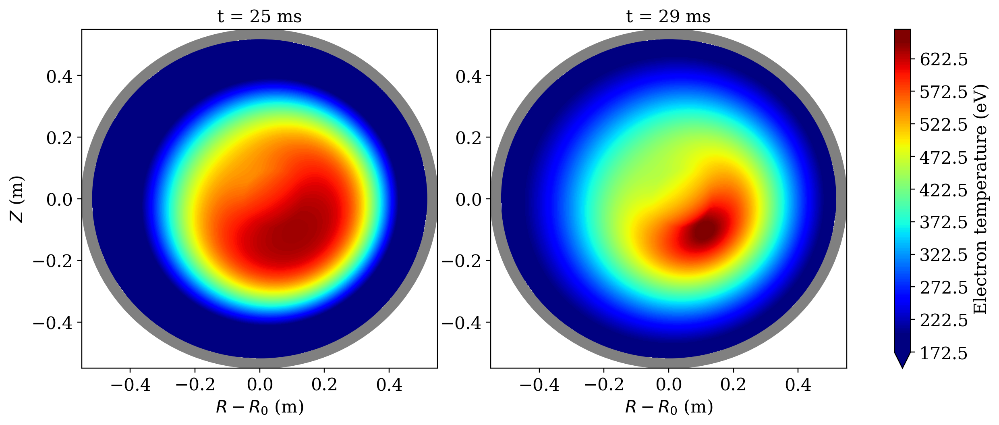

In [938]:
fig, axs = plt.subplots(1, 2, figsize=(12,5))
xs, ys = sunflower_points(5000)

# Reconstruction
tn1 = np.argmin(np.abs(ts - 25))
rhos = rho_xy(xs, ys, ts[tn1])
temps = temp_prof(rhos, *popt_temp[tn1,:3])
cax1 = axs[0].tricontourf(xs, ys, temps, 200, cmap=cm.jet, vmin=200, vmax=650, extend='min')

# Tomogrpahy
tn2 = np.argmin(np.abs(ts - 29))
rhos = rho_xy(xs, ys, ts[tn2])
temps = temp_prof(rhos, *popt_temp[tn2,:3])
cax2 = axs[1].tricontourf(xs, ys, temps, 200, cmap=cm.jet, vmin=200, vmax=650, extend='min')

for ax in axs:
    ax.set_xlabel('$R - R_0$ (m)')
    overplot_shell(ax)
    ax.set_xlim([-0.55, 0.55])
    ax.set_ylim([-0.55, 0.55])

axs[0].set_ylabel('$Z$ (m)')
axs[0].set_title('t = 25 ms', fontsize=14)
axs[1].set_title('t = 29 ms', fontsize=14)

plt.tight_layout()
plt.colorbar(cax2, ax=axs, orientation='vertical', label=r'Electron temperature (eV)');

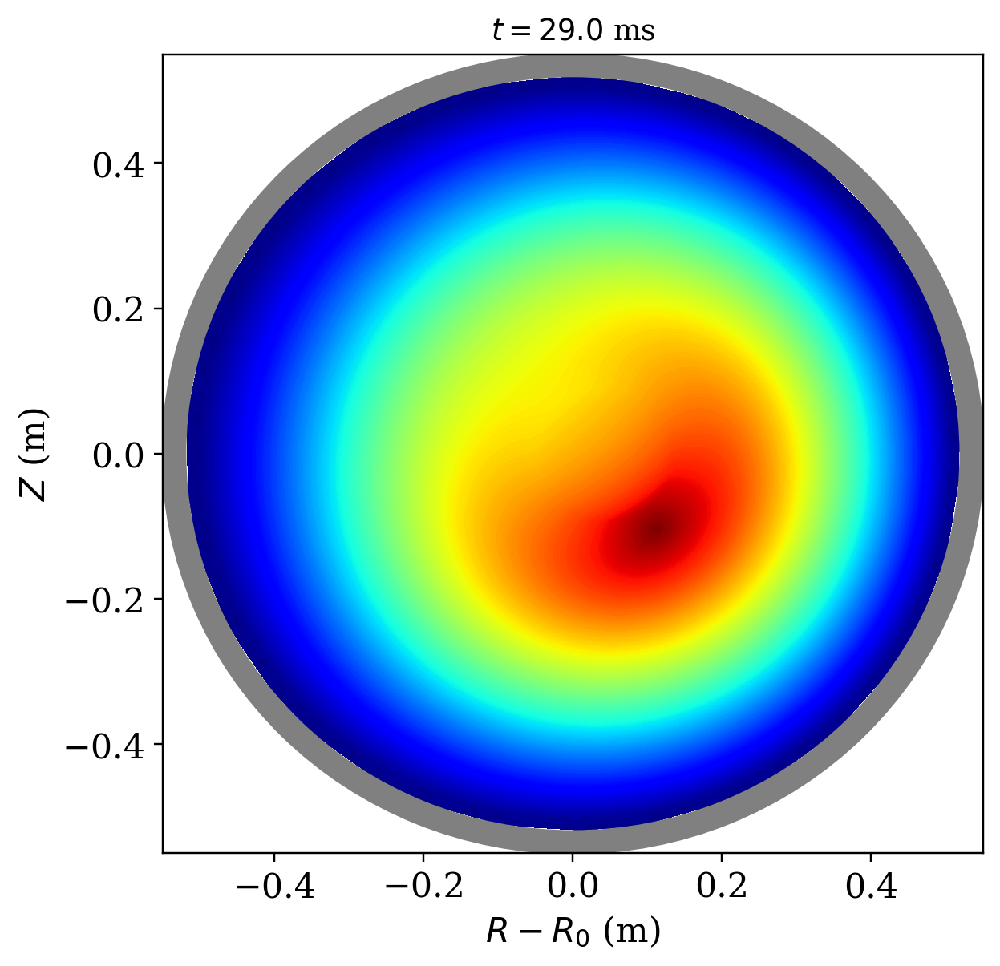

In [948]:
from mst_ida.models.base.geometry import line_of_sight

fig = plt.figure(figsize=(6,6))

# Plot flux contours
t = 29.0
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='SXT')
cax2 = plt.tricontourf(xs, ys, rs, 200, cmap=cm.jet_r)

# Make it look nice
overplot_shell(plt.gca())
plt.xlabel('$R - R_0$ (m)')
plt.ylabel('$Z$ (m)')
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55])
plt.title(r'$t = {0:.1f}$ ms'.format(t));

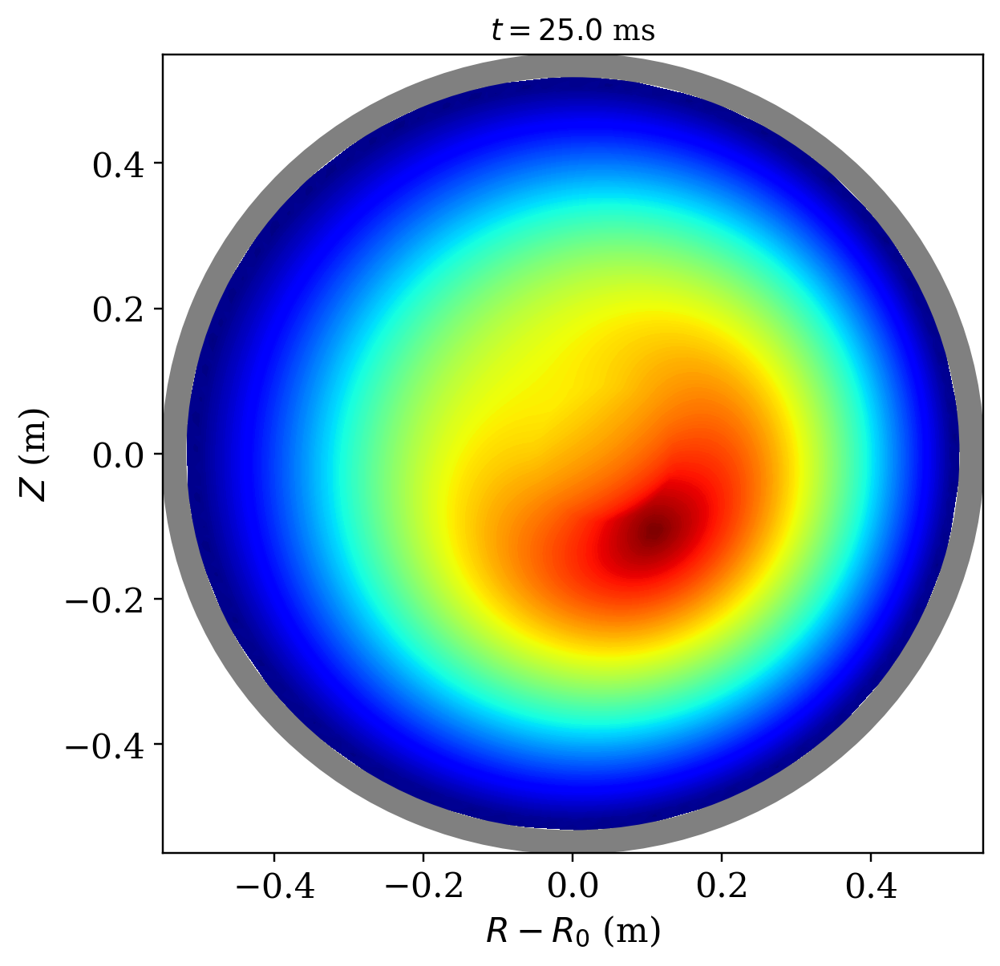

In [949]:
from mst_ida.models.base.geometry import line_of_sight

fig = plt.figure(figsize=(6,6))

# Plot flux contours
t = 25.0
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='SXT')
cax2 = plt.tricontourf(xs, ys, rs, 200, cmap=cm.jet_r)

# Make it look nice
overplot_shell(plt.gca())
plt.xlabel('$R - R_0$ (m)')
plt.ylabel('$Z$ (m)')
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55])
plt.title(r'$t = {0:.1f}$ ms'.format(t));

In [1034]:
t = 25.0
tn = np.argmin(np.abs(ts - t))
n_samples = 500

# Store the results
te_prof_samples = np.zeros([n_samples, len(ells)])
param_samples = sp.stats.multivariate_normal.rvs(mean=popt_temp[tn,:], cov=pcov_temp[tn,:,:], size = n_samples)

# Load the rhos
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='SXT')
delta = get_delta(t)

# Find the o-point
n_op = np.argmin(rs)
x_op = xs[n_op]
y_op = ys[n_op]

# Get the line of sight
impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op) + np.pi
impact_p = delta * np.cos(impact_phi)
los = line_of_sight(impact_p, impact_phi)
xl, yl = los.get_xy(ells)
rhos = rho_xy(xl, yl, t)

for n in range(n_samples):
    te_prof_samples[n,:] = temp_prof(rhos, *param_samples[n,:3])

    
# Get the summary stats
Te_avg_1 = np.average(te_prof_samples, axis=0)
Te_std_1 = np.std(te_prof_samples, axis=0)

In [1035]:
t = 29.0
tn = np.argmin(np.abs(ts - t))
n_samples = 500

# Store the results
te_prof_samples = np.zeros([n_samples, len(ells)])
param_samples = sp.stats.multivariate_normal.rvs(mean=popt_temp[tn,:], cov=pcov_temp[tn,:,:], size = n_samples)

# Load the rhos
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='SXT')
delta = get_delta(t)

# Find the o-point
n_op = np.argmin(rs)
x_op = xs[n_op]
y_op = ys[n_op]

# Get the line of sight
impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op) + np.pi
impact_p = delta * np.cos(impact_phi)
los = line_of_sight(impact_p, impact_phi)
xl, yl = los.get_xy(ells)
rhos = rho_xy(xl, yl, t)

for n in range(n_samples):
    te_prof_samples[n,:] = temp_prof(rhos, *param_samples[n,:3])

    
# Get the summary stats
Te_avg_2 = np.average(te_prof_samples, axis=0)
Te_std_2 = np.std(te_prof_samples, axis=0)

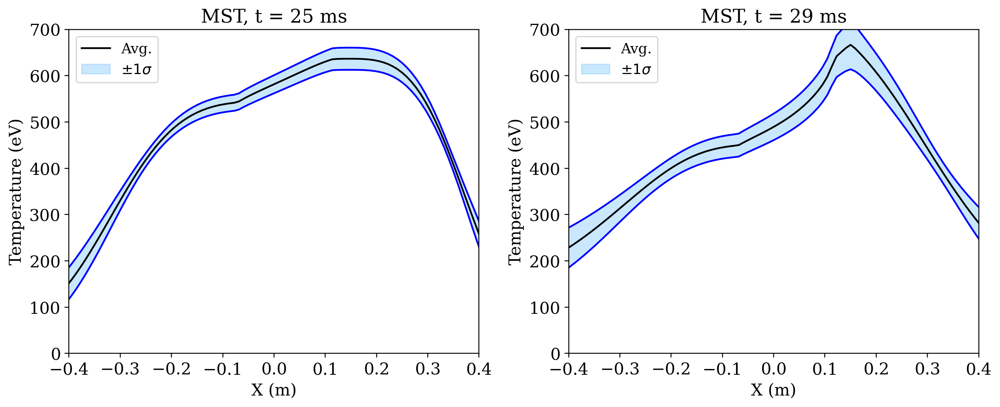

In [1043]:
fig, axs = plt.subplots(1, 2, figsize=(12,5))

# Quiet phase
axs[0].plot(ells, Te_avg_1, color='black', label='Avg.')
axs[0].plot(ells, Te_avg_1+Te_std_1, color='blue')
axs[0].plot(ells, Te_avg_1-Te_std_1, color='blue')
axs[0].fill_between(ells, Te_avg_1-Te_std_1, Te_avg_1+Te_std_1, color='xkcd:light blue', alpha=0.5, label=r'$\pm 1\sigma$')

# Dynamic Phase
axs[1].plot(ells, Te_avg_2, color='black', label='Avg.')
axs[1].plot(ells, Te_avg_2+Te_std_2, color='blue')
axs[1].plot(ells, Te_avg_2-Te_std_2, color='blue')
axs[1].fill_between(ells, Te_avg_2-Te_std_2, Te_avg_2+Te_std_2, color='xkcd:light blue', alpha=0.5, label=r'$\pm 1\sigma$')

for ax in axs:
    ax.set_xlabel('X (m)')
    ax.set_ylabel(r'Temperature (eV)')
    ax.set_xlim([-0.4, 0.4])
    ax.set_ylim([0,700])
    ax.legend(loc='upper left')
    
axs[0].set_title('MST, t = 25 ms', fontsize=16)
axs[1].set_title('MST, t = 29 ms', fontsize=16)
plt.tight_layout();

In [967]:
temp_samples = np.copy(samples)

In [979]:
import pickle

fdir = '/home/pdvanmeter/analysis/python/qsh_Te/pickle_jar'
fname = 'MST_s{0:d}_dens_samples.pkl'.format(shot)
fpath = os.path.join(fdir, fname)

with open(fpath, 'rb') as f:
    dens_samples = pickle.load(f)

In [990]:
from mst_ida.analysis.ida import profile_confidence

n_samples = 2000
rs = np.linspace(0, 1, num=100)
Te_samples = np.zeros([n_samples, len(rs)])
ne_samples = np.zeros([n_samples, len(rs)])
nAl_samples = np.zeros([n_samples, len(rs)])

for index, n in enumerate(np.random.randint(120000, size=n_samples)):
    Te0, beta_T, dr, nAl0, bg1, bg2 = temp_samples[n,:]
    n0, n1, alpha_n, beta_n = dens_samples[n,:]
    Te_samples[index,:] = temp_prof(rs, Te0, beta_T, dr)
    ne_samples[index,:] = ne_prof(rs, n0, n1, alpha_n, beta_n, gamma=100.)
    nAl_samples[index,:] = get_nZ_profs(rs, nAl0, mu_C, alpha_Z, beta_Z)['Al']
    
Te_CIs = profile_confidence(Te_samples)
ne_CIs = profile_confidence(ne_samples)
nAl_CIs = profile_confidence(nAl_samples)

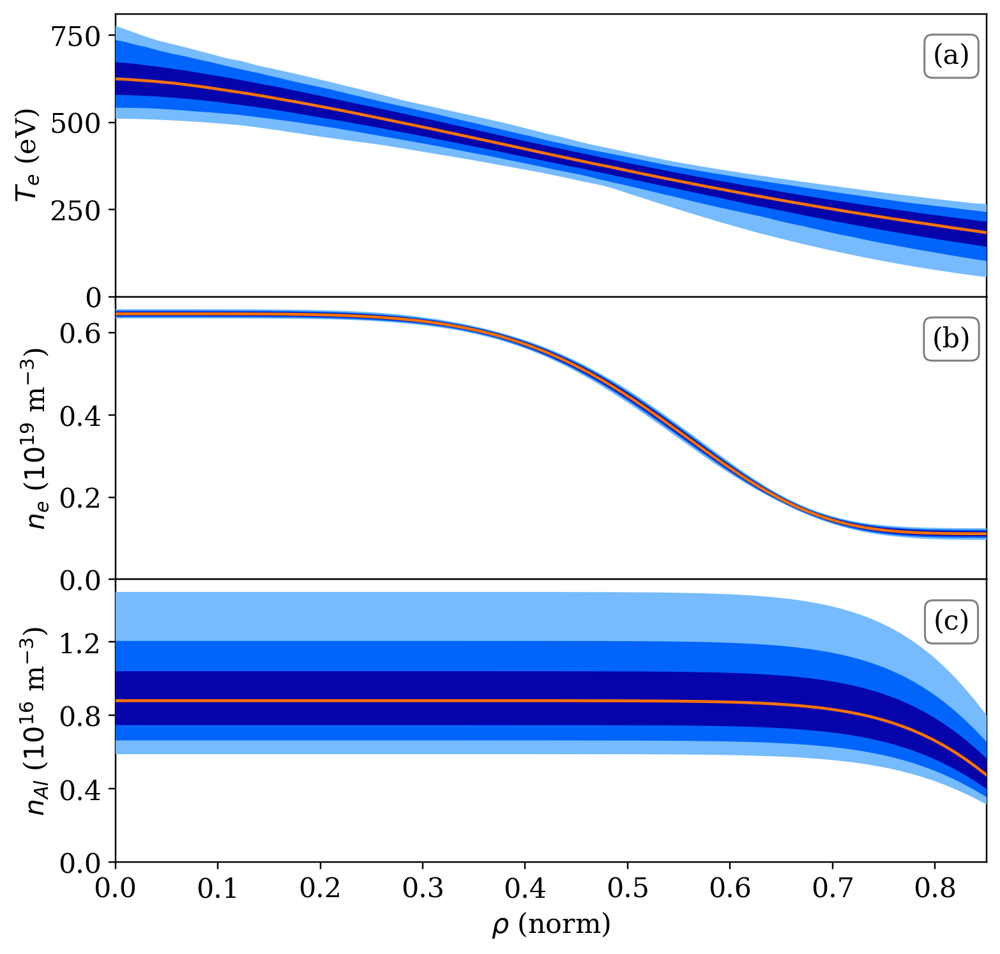

In [991]:
fig, axs = plt.subplots(3, 1, figsize=(8,8))

# Temperature
axs[0].plot(rs, Te_CIs['median'], color='xkcd:orange', zorder=100)
axs[0].fill_between(rs, Te_CIs['1 sigma']['low'], Te_CIs['1 sigma']['high'], color='xkcd:royal blue', zorder=90)
axs[0].fill_between(rs, Te_CIs['2 sigma']['low'], Te_CIs['2 sigma']['high'], color='xkcd:bright blue', zorder=80)
axs[0].fill_between(rs, Te_CIs['3 sigma']['low'], Te_CIs['3 sigma']['high'], color='xkcd:sky blue', zorder=70)
axs[0].set_ylabel(r'$T_e$ (eV)')
axs[0].set_ylim([0,None])

# Density
axs[1].plot(rs, ne_CIs['median'], color='xkcd:orange', zorder=100)
axs[1].fill_between(rs, ne_CIs['1 sigma']['low'], ne_CIs['1 sigma']['high'], color='xkcd:royal blue', zorder=90)
axs[1].fill_between(rs, ne_CIs['2 sigma']['low'], ne_CIs['2 sigma']['high'], color='xkcd:bright blue', zorder=80)
axs[1].fill_between(rs, ne_CIs['3 sigma']['low'], ne_CIs['3 sigma']['high'], color='xkcd:sky blue', zorder=70)
axs[1].set_ylabel(r'$n_e$ ($10^{19}$ m$^{-3}$)')
axs[1].set_ylim([0,None])

# Aluminum
axs[2].plot(rs, nAl_CIs['median']/1e-3, color='xkcd:orange', zorder=100)
axs[2].fill_between(rs, nAl_CIs['1 sigma']['low']/1e-3, nAl_CIs['1 sigma']['high']/1e-3, color='xkcd:royal blue', zorder=90)
axs[2].fill_between(rs, nAl_CIs['2 sigma']['low']/1e-3, nAl_CIs['2 sigma']['high']/1e-3, color='xkcd:bright blue', zorder=80)
axs[2].fill_between(rs, nAl_CIs['3 sigma']['low']/1e-3, nAl_CIs['3 sigma']['high']/1e-3, color='xkcd:sky blue', zorder=70)
axs[2].set_ylabel(r'$n_{Al}$ ($10^{16}$ m$^{-3}$)')
axs[2].set_ylim([0,None])

# Make it look good
for ax in axs:
    ax.set_xlim([0,0.85])
    ax.yaxis.set_major_locator(MaxNLocator(nbins=4, prune='upper'))

for ax in axs[:-1]:
    ax.xaxis.set_ticklabels([])

for ax,alpha in zip(axs,['a','b','c']):
    text(0.96, 0.85, r'({0:})'.format(alpha), ax, fontsize=14, color='black', bbox=props, zorder=100)

axs[-1].set_xlabel(r'$\rho$ (norm)')
plt.subplots_adjust(wspace=0, hspace=0)

## Gradients

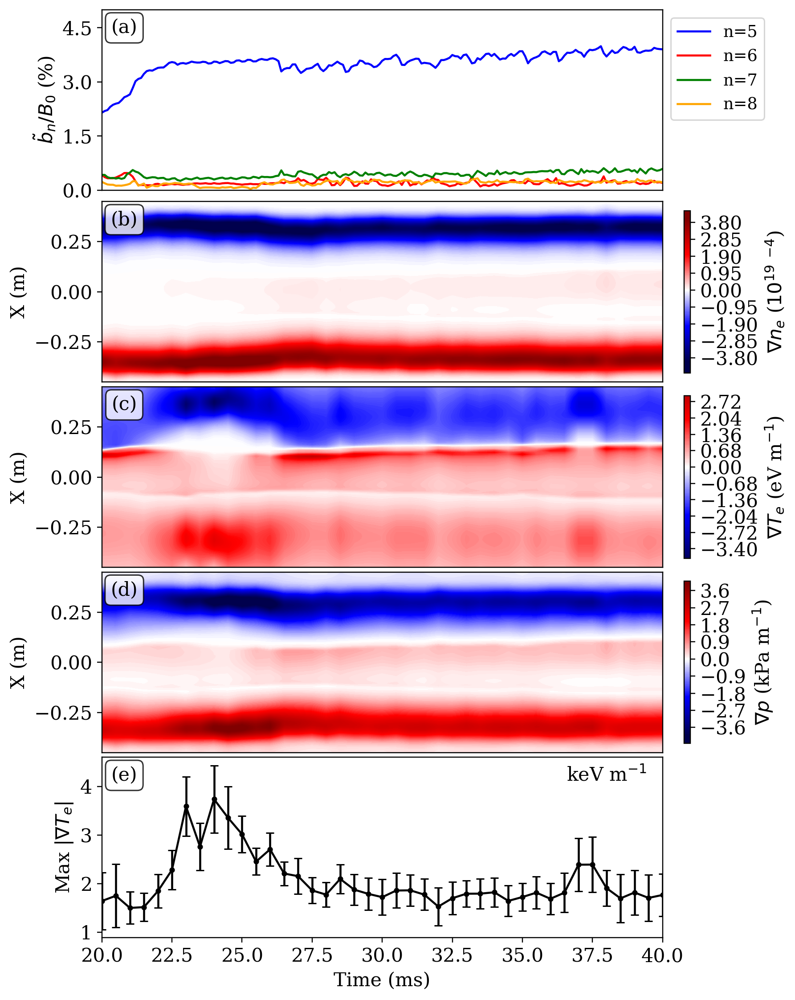

In [1002]:
fig, axs = plt.subplots(5, 1, constrained_layout=True, figsize=(8,10))
props = dict(boxstyle='round', facecolor='white', alpha=0.8)

# Magnetics signals
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7,8], ['blue','red','green','orange']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left', bbox_to_anchor=(1.00, 1.0))
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (%)')
axs[0].set_ylim([0,5])

# Density
cax = axs[1].contourf(ts, ells, grad_n.T, 200, cmap=cm.seismic, vmin=-4.0, vmax=4.0)
cb1 = fig.colorbar(cax, ax=axs[1], label=r'$\nabla n_e$ ($10^{19}$ $^{-4}$)', shrink=0.9)
axs[1].set_ylabel(r'X (m)')

# Temperature
cax = axs[2].contourf(ts, ells, grad_T.T/1e3, 200, cmap=cm.seismic, vmin=-4.0, vmax=4.0)
cb2 = fig.colorbar(cax, ax=axs[2], label=r'$\nabla T_e$ (eV m$^{-1}$)', shrink=0.9)
axs[2].set_ylabel(r'X (m)')

# Pressure
cax = axs[3].contourf(ts, ells, grad_p.T/1e3, 200, cmap=cm.seismic, vmin=-4.0, vmax=4.0)
cb2 = fig.colorbar(cax, ax=axs[3], label=r'$\nabla p$ (kPa m$^{-1}$)', shrink=0.9)
axs[3].set_ylabel(r'X (m)')

# Max Te gradient
axs[4].errorbar(ts, grad_Te_set/1000., yerr=grad_Te_err/1000., marker='o', ms=3, capsize=3, color='black', linestyle='-')
axs[4].set_ylabel(r'Max $|\nabla T_e|$')
text(0.9, 0.9, r'keV m$^{-1}$', axs[4], fontsize=14, color='black')

for ax,alpha in zip(axs,['a','b','c','d', 'e']):
    text(0.04, 0.9, r'({0:})'.format(alpha), ax, fontsize=14, color='black', bbox=props)
    ax.set_xlim([ts[0], ts[-1]])
    ax.yaxis.set_major_locator(MaxNLocator(nbins=4, prune='upper'))
    #ax.axvline(x=26.4, color='black', linestyle=':', linewidth=1)

for ax in axs[:-1]:
    ax.set_xticks([])
    
axs[-1].set_xlabel('Time (ms)')
fig.set_constrained_layout_pads(hspace=0, h_pad=0);

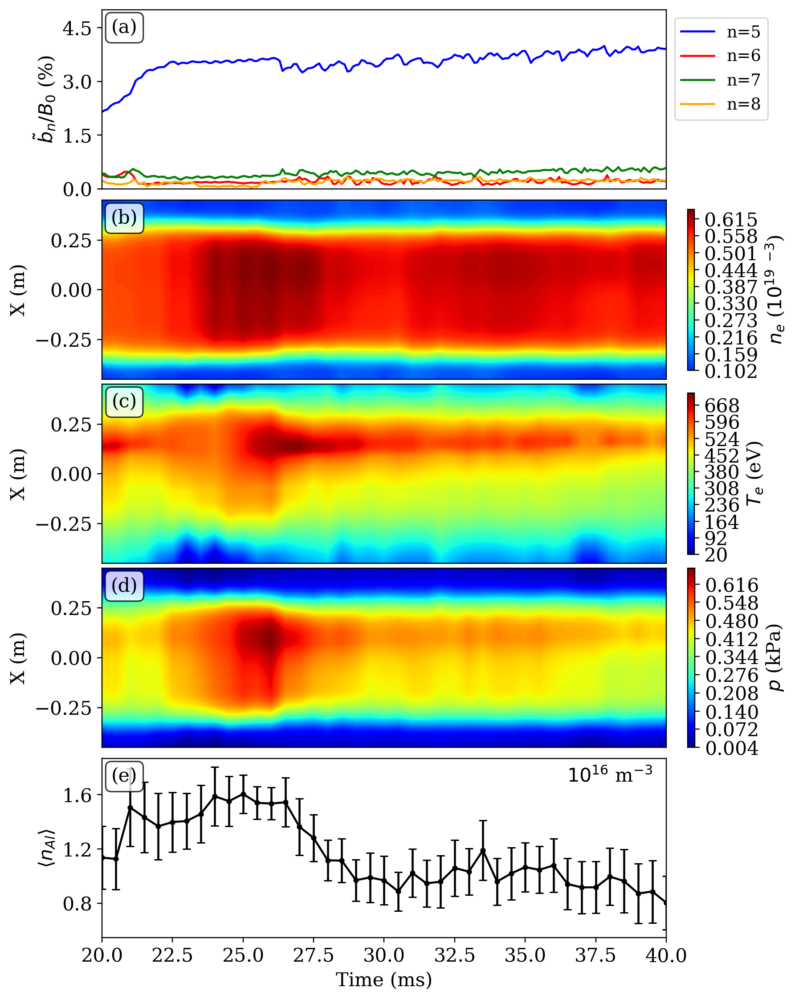

In [1001]:
fig, axs = plt.subplots(5, 1, constrained_layout=True, figsize=(8,10))
props = dict(boxstyle='round', facecolor='white', alpha=0.8)

# Magnetics signals
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7,8], ['blue','red','green','orange']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left', bbox_to_anchor=(1.00, 1.0))
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (%)')
axs[0].set_ylim([0,5])

# Density
cax = axs[1].contourf(ts, ells, prof_n.T, 200, cmap=cm.jet, vmin=0)
cb1 = fig.colorbar(cax, ax=axs[1], label=r'$n_e$ ($10^{19}$ $^{-3}$)', shrink=0.9)
axs[1].set_ylabel(r'X (m)')

# Temperature
cax = axs[2].contourf(ts, ells, prof_T.T, 200, cmap=cm.jet, vmin=0)
cb2 = fig.colorbar(cax, ax=axs[2], label=r'$T_e$ (eV)', shrink=0.9)
axs[2].set_ylabel(r'X (m)')

# Pressure
cax = axs[3].contourf(ts, ells, prof_p.T/1e3, 200, cmap=cm.jet, vmin=0)
fig.colorbar(cax, ax=axs[3], label=r'$p$ (kPa)')
axs[3].set_ylabel(r'X (m)')

# Aluminum
axs[4].errorbar(ts, nAls/1e-3, yerr=nAl_errs/1e-3, marker='o', ms=3, capsize=3, color='black', linestyle='-')
axs[4].set_ylabel(r'$\langle n_{Al} \rangle$')
text(0.9, 0.9, r'$10^{16}$ m$^{-3}$', axs[4], fontsize=14, color='black')

for ax,alpha in zip(axs,['a','b','c','d', 'e']):
    text(0.04, 0.9, r'({0:})'.format(alpha), ax, fontsize=14, color='black', bbox=props)
    ax.set_xlim([ts[0], ts[-1]])
    ax.yaxis.set_major_locator(MaxNLocator(nbins=4, prune='upper'))
    #ax.axvline(x=26.4, color='black', linestyle=':', linewidth=1)

for ax in axs[:-1]:
    ax.set_xticks([])
    
axs[-1].set_xlabel('Time (ms)')
fig.set_constrained_layout_pads(hspace=0, h_pad=0);

## Putting together the quantities needed for GENE

I want to provide the following to MJ:

$$
    \frac{a}{L_T} = \frac{a \nabla T_e}{T_e}
$$

$$
    \frac{a}{L_T} = \frac{a \nabla T_e}{T_e}
$$

$$
    \beta = \frac{n_e T_e + n_i T_e}{\mu_0 B^2/2}
$$

$$
    \frac{T_i}{T_e} \approx \frac{1}{3}
$$

And, since I am totally confused about the gradients, I will also calculate the gradients as a function of the VMEC $s$

$$
    \frac{d T_e}{ds}
$$

and

$$
    \frac{d n_e}{ds}
$$

I'm just going to ignore $\nabla T_i$ since I can't measure it and from John's thesis it doesn't seem to be very big anyways.

The correspondance between SHEq and V3Fit results is extremely close in the high gradient region, so I am going to use the results here. I will bring in VMEC to calculate $\beta$ though.

In [1045]:
import boguski.vmec_analysis as vmec
import mst_ida.models.base.flux_maps as fm

shot_v3 = 1140207074
t_v3 = 25.4

woutfile = fm.get_woufile(shot_v3, t_v3, fit_name='fit4')
vmec_grid = vmec.get_VMEC_grid(woutfile = '/home/boguski/IDSII_local/wout_inb.nc')

First time point, during the quiet phase.

In [1185]:
t = 25.0
tn = np.argmin(np.abs(ts - t))

# Load the rhos
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='SXT')
delta = get_delta(t)

# Find the o-point
n_op = np.argmin(rs)
x_op = xs[n_op]
y_op = ys[n_op]

# Get the line of sight
impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op) + np.pi
impact_p = delta * np.cos(impact_phi)
los = line_of_sight(impact_p, impact_phi)
xl, yl = los.get_xy(ells)
rhos = rho_xy(xl, yl, t)

In [1162]:
b_theta = np.zeros(len(ells))
b_phi = np.zeros(len(ells))
b_r = np.zeros(len(ells))
b_mod = np.zeros(len(ells))

R0 = vmec_grid['R0']

for index,ell in enumerate(ells):
    x, y = los.get_xy(ell)
    st = vmec.find_s_u_v_l(x+1.5, y, [np.deg2rad(90.0)], VMEC_grid=vmec_grid)
    b_theta[index] = st['B_theta']
    b_phi[index] = st['B_phi']
    b_r[index] = st['B_r']
    b_mod[index] = st['B_mag']

In [1195]:
t = 25.0
tn = np.argmin(np.abs(ts - t))

# Where is the maximum Te gradient in X coords?
max_grad_Te = np.amin(grad_T[tn,:])
ii_max = np.argmin(grad_T[tn,:])
X_max = ells[ii_max]
rho_max = rhos[ii_max]

# Normalized gradient, spatial coords
norm_grad = 0.52*grad_T[tn,ii_max]/prof_T[tn,ii_max]

# Normalized density gradient
norm_dens_grad = 0.52*grad_n[tn,ii_max]/prof_n[tn,ii_max]

# Plasma beta
beta = (4/3)*prof_p[tn,:] /  ( b_mod**2/(2*mu0) )

# In VMEC coords
rs = np.linspace(0, 1, num=100)
Te_rs = temp_prof(rs, *popt_temp[tn,:3])
dT_dr = np.gradient(Te_rs, rs)
max_grad_rho = dT_dr[np.argmin(np.abs(rs - rho_max))]

ne_rs = ne_prof(rs, *popt_dens[tn,:])
dn_dr = np.gradient(ne_rs, rs)
max_grad_dens_rho = dn_dr[np.argmin(np.abs(rs - rho_max))]

print('MST shot #{0:10d}, t = {1:.1f} ms'.format(shot, t))
print('Max value of grad_Te: {0:.2f} keV/m'.format(max_grad_Te/1e3))
print('This occurs at X = {0:.2f} m'.format(X_max))
print()
print('Properties:')
print('Te = {0:.2f} eV'.format(prof_T[tn,ii_max]))
print('Ti/Te = 1/3')
print('beta = {0:.2f} %'.format(beta[ii_max]*100))
print('a*grad_Te/Te = {0:.2f}'.format(norm_grad))
print('ne = {0:.2f}e19 m^-3'.format(prof_n[tn,ii_max]))
print('a*grad_ne/ne = {0:.2f}'.format(norm_dens_grad))
print()
print('In terms of VMEC s:')
print('s = {0:.2f}'.format(rho_max))
print('dT/ds = {0:.2f} eV'.format(max_grad_rho))
print('Normalized (dTe/ds)/Te = {0:.2f}'.format(max_grad_rho/prof_T[tn,ii_max]))
print('dne/ds = {0:.2f}e19 m^-3'.format(max_grad_dens_rho))
print('Normalized (dne/ds)/ne = {0:.2f}'.format(max_grad_dens_rho/prof_n[tn,ii_max]))

MST shot #1200701056, t = 25.0 ms
Max value of grad_Te: -3.04 keV/m
This occurs at X = 0.38 m

Properties:
Te = 328.51 eV
Ti/Te = 1/3
beta = 0.27 %
a*grad_Te/Te = -4.81
ne = 0.14e19 m^-3
a*grad_ne/ne = -7.00

In terms of VMEC s:
s = 0.61
dT/ds = -944.04 eV
Normalized (dTe/ds)/Te = -2.87
dne/ds = -1.64e19 m^-3
Normalized (dne/ds)/ne = -11.50


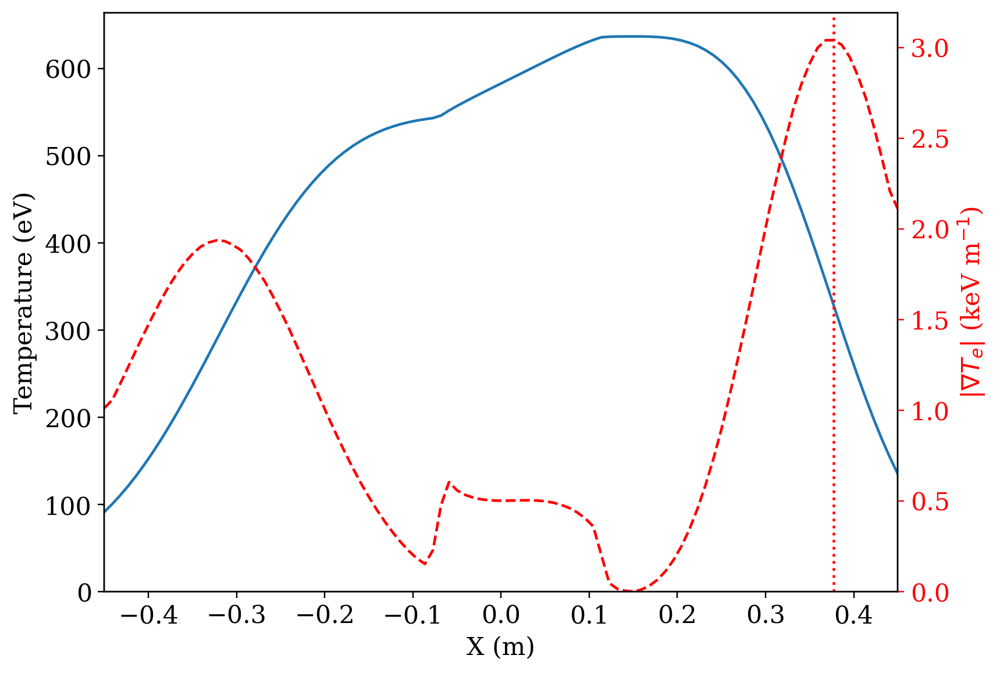

In [1102]:
plt.plot(ells, prof_T[tn,:])
plt.xlim([-0.45, 0.45])
plt.ylim([0,None])
plt.ylabel('Temperature (eV)')
plt.xlabel('X (m)')

# Normalized gradient
ax2 = plt.twinx()
ax2.plot(ells, np.abs(grad_T[tn,:]/1e3), color='red', linestyle='dashed')
ax2.set_ylim([0,None])
ax2.set_ylabel(r'$|\nabla T_e|$ (keV m$^{-1}$)')
color_axis(ax2, 'red')
ax2.axvline(x=X_max, color='red', linestyle=':');

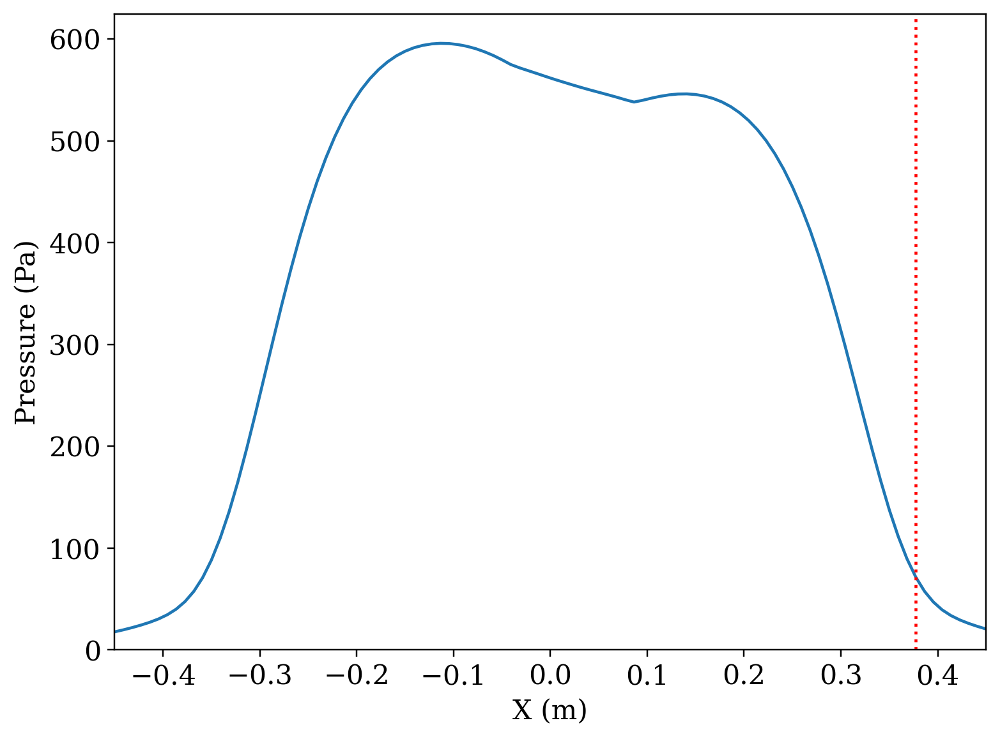

In [1107]:
plt.plot(ells, prof_p[tn,:])
plt.xlim([-0.45, 0.45])
plt.ylim([0,None])
plt.ylabel('Pressure (Pa)')
plt.xlabel('X (m)')
plt.axvline(x=X_max, color='red', linestyle=':');

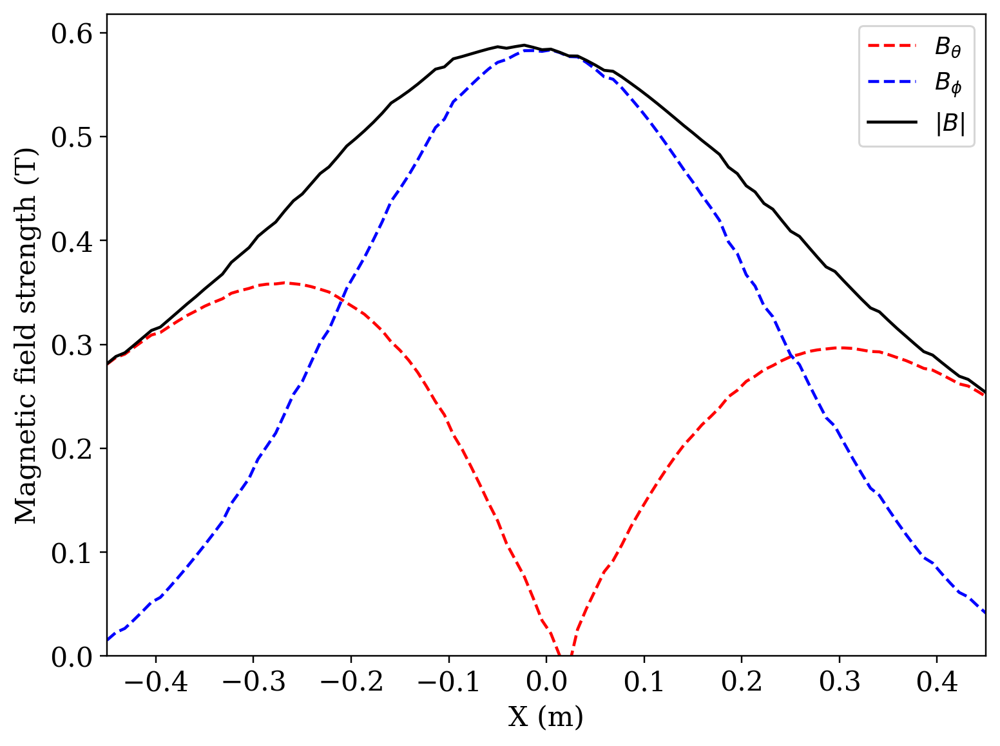

In [1072]:
plt.plot(ells, b_theta, color='red', linestyle='dashed', label=r'$B_\theta$')
plt.plot(ells, b_phi, color='blue', linestyle='dashed', label=r'$B_\phi$')
plt.plot(ells, b_mod, color='black', linestyle='solid', label=r'$|B|$')

plt.legend()
plt.xlabel('X (m)')
plt.xlim([ells[0], ells[-1]])
plt.ylim([0,None])
plt.ylabel('Magnetic field strength (T)');

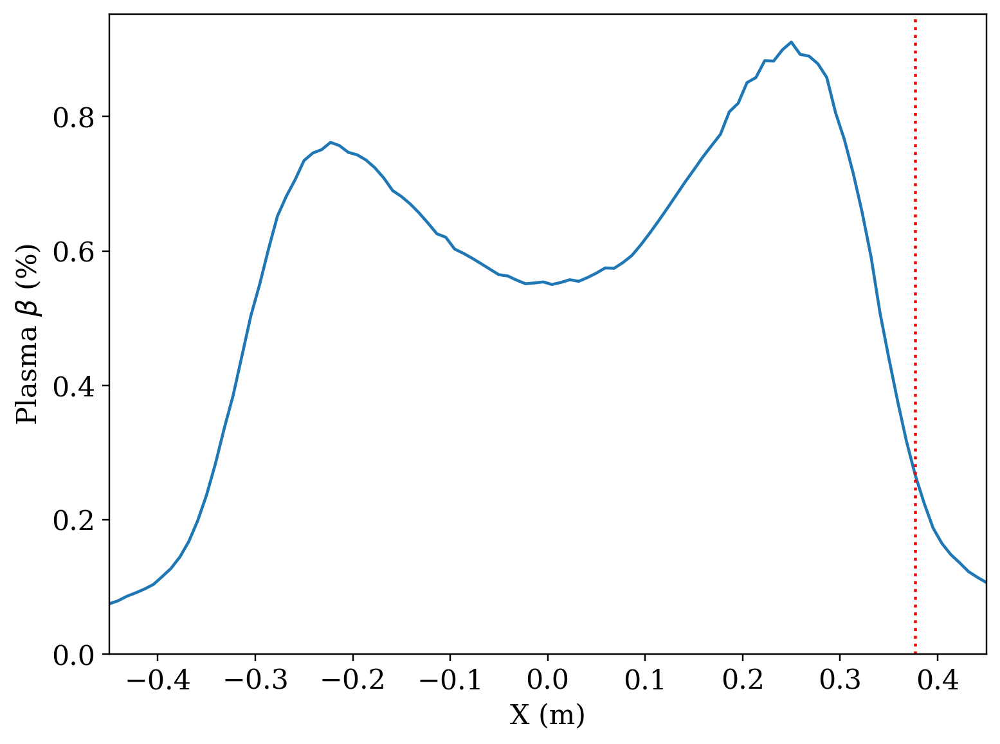

In [1081]:
plt.plot(ells, beta*100)

plt.xlabel('X (m)')
plt.xlim([ells[0], ells[-1]])
plt.ylim([0,None])
plt.ylabel(r'Plasma $\beta$ (%)')
plt.axvline(x=X_max, color='red', linestyle=':');

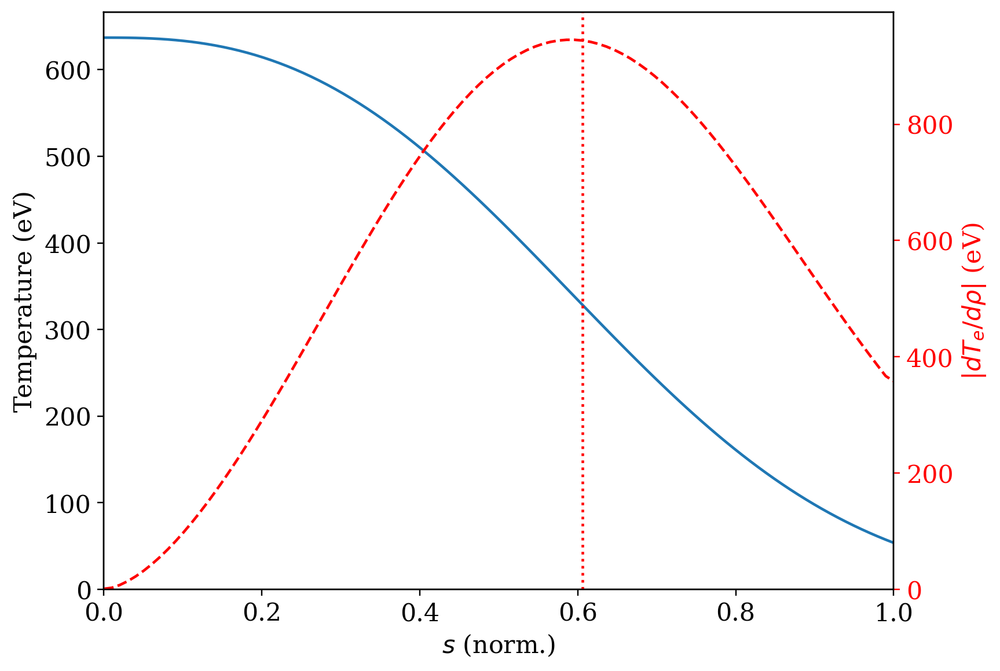

In [1164]:
plt.plot(rs, Te_rs)
plt.xlim([0,1])
plt.ylim([0,None])
plt.xlabel(r'$s$ (norm.)')
plt.ylabel('Temperature (eV)')

# The gradient
ax2 = plt.twinx()
ax2.plot(rs, np.abs(dT_dr), color='red', linestyle='dashed')

ax2.set_ylim([0,None])
ax2.set_ylabel(r'$|d T_e /d\rho|$ (eV)')
color_axis(ax2, 'red')
ax2.axvline(x=rho_max, color='red', linestyle=':');

Now, at a second time point later on.

In [1194]:
t = 30.0
tn = np.argmin(np.abs(ts - t))

# Where is the maximum Te gradient in X coords?
max_grad_Te = np.amin(grad_T[tn,:])
ii_max = np.argmin(grad_T[tn,:])
X_max = ells[ii_max]
rho_max = rhos[ii_max]

# Normalized gradient, spatial coords
norm_grad = 0.52*grad_T[tn,ii_max]/prof_T[tn,ii_max]

# Normalized density gradient
norm_dens_grad = 0.52*grad_n[tn,ii_max]/prof_n[tn,ii_max]

# Plasma beta
beta = (4/3)*prof_p[tn,:] /  ( b_mod**2/(2*mu0) )

# In VMEC coords
rs = np.linspace(0, 1, num=100)
Te_rs = temp_prof(rs, *popt_temp[tn,:3])
dT_dr = np.gradient(Te_rs, rs)
max_grad_rho = dT_dr[np.argmin(np.abs(rs - rho_max))]

ne_rs = ne_prof(rs, *popt_dens[tn,:])
dn_dr = np.gradient(ne_rs, rs)
max_grad_dens_rho = dn_dr[np.argmin(np.abs(rs - rho_max))]

print('MST shot #{0:10d}, t = {1:.1f} ms'.format(shot, t))
print('Max value of grad_Te: {0:.2f} keV/m'.format(max_grad_Te/1e3))
print('This occurs at X = {0:.2f} m'.format(X_max))
print()
print('Properties:')
print('Te = {0:.2f} eV'.format(prof_T[tn,ii_max]))
print('Ti/Te = 1/3')
print('beta = {0:.2f} %'.format(beta[ii_max]*100))
print('a*grad_Te/Te = {0:.2f}'.format(norm_grad))
print('ne = {0:.2f}e19 m^-3'.format(prof_n[tn,ii_max]))
print('a*grad_ne/ne = {0:.2f}'.format(norm_dens_grad))
print()
print('In terms of VMEC s:')
print('s = {0:.2f}'.format(rho_max))
print('dT/ds = {0:.2f} eV'.format(max_grad_rho))
print('Normalized (dTe/ds)/Te = {0:.2f}'.format(max_grad_rho/prof_T[tn,ii_max]))
print('dne/ds = {0:.2f}e19 m^-3'.format(max_grad_dens_rho))
print('Normalized (dne/ds)/ne = {0:.2f}'.format(max_grad_dens_rho/prof_n[tn,ii_max]))

MST shot #1200701056, t = 30.0 ms
Max value of grad_Te: -1.58 keV/m
This occurs at X = 0.30 m

Properties:
Te = 442.91 eV
Ti/Te = 1/3
beta = 0.54 %
a*grad_Te/Te = -1.85
ne = 0.38e19 m^-3
a*grad_ne/ne = -5.14

In terms of VMEC s:
s = 0.38
dT/ds = -518.50 eV
Normalized (dTe/ds)/Te = -1.17
dne/ds = -0.78e19 m^-3
Normalized (dne/ds)/ne = -2.04
